# Yet Another IMDB Example (YAIE) - FC - just kidding... NOT! 

Example is based on [Deep Learning with Python](https://www.manning.com/books/deep-learning-with-python?a_aid=keras&a_bid=76564dff) book by François Chollet - author of Keras himself!!!

In [1]:
from tensorflow.keras.datasets import imdb

(train_data, train_labels), (test_data, test_labels) = imdb.load_data(num_words=10000)

17465344/17464789 [==============================] - 8s 0us/step


/opt/anaconda3/lib/python3.7/site-packages/tensorflow_core/python/keras/datasets/imdb.py:129: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  x_train, y_train = np.array(xs[:idx]), np.array(labels[:idx])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow_core/python/keras/datasets/imdb.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  x_test, y_test = np.array(xs[idx:]), np.array(labels[idx:])


In [2]:
print(train_data[0])

[1, 14, 22, 16, 43, 530, 973, 1622, 1385, 65, 458, 4468, 66, 3941, 4, 173, 36, 256, 5, 25, 100, 43, 838, 112, 50, 670, 2, 9, 35, 480, 284, 5, 150, 4, 172, 112, 167, 2, 336, 385, 39, 4, 172, 4536, 1111, 17, 546, 38, 13, 447, 4, 192, 50, 16, 6, 147, 2025, 19, 14, 22, 4, 1920, 4613, 469, 4, 22, 71, 87, 12, 16, 43, 530, 38, 76, 15, 13, 1247, 4, 22, 17, 515, 17, 12, 16, 626, 18, 2, 5, 62, 386, 12, 8, 316, 8, 106, 5, 4, 2223, 5244, 16, 480, 66, 3785, 33, 4, 130, 12, 16, 38, 619, 5, 25, 124, 51, 36, 135, 48, 25, 1415, 33, 6, 22, 12, 215, 28, 77, 52, 5, 14, 407, 16, 82, 2, 8, 4, 107, 117, 5952, 15, 256, 4, 2, 7, 3766, 5, 723, 36, 71, 43, 530, 476, 26, 400, 317, 46, 7, 4, 2, 1029, 13, 104, 88, 4, 381, 15, 297, 98, 32, 2071, 56, 26, 141, 6, 194, 7486, 18, 4, 226, 22, 21, 134, 476, 26, 480, 5, 144, 30, 5535, 18, 51, 36, 28, 224, 92, 25, 104, 4, 226, 65, 16, 38, 1334, 88, 12, 16, 283, 5, 16, 4472, 113, 103, 32, 15, 16, 5345, 19, 178, 32]


In [8]:
len(train_data[0])

218

In [9]:
train_labels[0]

1

In [10]:
max([max(sequence) for sequence in train_data])

9999

In [11]:
word_index = imdb.get_word_index()
reverse_word_index = dict([(value, key) for (key, value) in word_index.items()])
#"padding", "start of sequence", and "unknown".
decoded_review = ' '.join([reverse_word_index.get(i - 3, '?') for i in train_data[0]])
decoded_review

"? this film was just brilliant casting location scenery story direction everyone's really suited the part they played and you could just imagine being there robert ? is an amazing actor and now the same being director ? father came from the same scottish island as myself so i loved the fact there was a real connection with this film the witty remarks throughout the film were great it was just brilliant so much that i bought the film as soon as it was released for ? and would recommend it to everyone to watch and the fly fishing was amazing really cried at the end it was so sad and you know what they say if you cry at a film it must have been good and this definitely was also ? to the two little boy's that played the ? of norman and paul they were just brilliant children are often left out of the ? list i think because the stars that play them all grown up are such a big profile for the whole film but these children are amazing and should be praised for what they have done don't you th

In [7]:
word_index

{'fawn': 34701,
 'tsukino': 52006,
 'nunnery': 52007,
 'sonja': 16816,
 'vani': 63951,
 'woods': 1408,
 'spiders': 16115,
 'hanging': 2345,
 'woody': 2289,
 'trawling': 52008,
 "hold's": 52009,
 'comically': 11307,
 'localized': 40830,
 'disobeying': 30568,
 "'royale": 52010,
 "harpo's": 40831,
 'canet': 52011,
 'aileen': 19313,
 'acurately': 52012,
 "diplomat's": 52013,
 'rickman': 25242,
 'arranged': 6746,
 'rumbustious': 52014,
 'familiarness': 52015,
 "spider'": 52016,
 'hahahah': 68804,
 "wood'": 52017,
 'transvestism': 40833,
 "hangin'": 34702,
 'bringing': 2338,
 'seamier': 40834,
 'wooded': 34703,
 'bravora': 52018,
 'grueling': 16817,
 'wooden': 1636,
 'wednesday': 16818,
 "'prix": 52019,
 'altagracia': 34704,
 'circuitry': 52020,
 'crotch': 11585,
 'busybody': 57766,
 "tart'n'tangy": 52021,
 'burgade': 14129,
 'thrace': 52023,
 "tom's": 11038,
 'snuggles': 52025,
 'francesco': 29114,
 'complainers': 52027,
 'templarios': 52125,
 '272': 40835,
 '273': 52028,
 'zaniacs': 52130,

What do you think is the most common word in this reviews?

In [14]:
import numpy as np

def vectorize_sequences(sequences, dimension=10000):
    # Create an all-zero matrix of shape (len(sequences), dimension)
    results = np.zeros((len(sequences), dimension))
    for i, sequence in enumerate(sequences):
        print(i, "---", sequence)
        results[i, sequence] = 1.  # set specific indices of results[i] to 1s
    return results

x_train = vectorize_sequences(train_data)
x_test = vectorize_sequences(test_data)

0 --- [1, 14, 22, 16, 43, 530, 973, 1622, 1385, 65, 458, 4468, 66, 3941, 4, 173, 36, 256, 5, 25, 100, 43, 838, 112, 50, 670, 2, 9, 35, 480, 284, 5, 150, 4, 172, 112, 167, 2, 336, 385, 39, 4, 172, 4536, 1111, 17, 546, 38, 13, 447, 4, 192, 50, 16, 6, 147, 2025, 19, 14, 22, 4, 1920, 4613, 469, 4, 22, 71, 87, 12, 16, 43, 530, 38, 76, 15, 13, 1247, 4, 22, 17, 515, 17, 12, 16, 626, 18, 2, 5, 62, 386, 12, 8, 316, 8, 106, 5, 4, 2223, 5244, 16, 480, 66, 3785, 33, 4, 130, 12, 16, 38, 619, 5, 25, 124, 51, 36, 135, 48, 25, 1415, 33, 6, 22, 12, 215, 28, 77, 52, 5, 14, 407, 16, 82, 2, 8, 4, 107, 117, 5952, 15, 256, 4, 2, 7, 3766, 5, 723, 36, 71, 43, 530, 476, 26, 400, 317, 46, 7, 4, 2, 1029, 13, 104, 88, 4, 381, 15, 297, 98, 32, 2071, 56, 26, 141, 6, 194, 7486, 18, 4, 226, 22, 21, 134, 476, 26, 480, 5, 144, 30, 5535, 18, 51, 36, 28, 224, 92, 25, 104, 4, 226, 65, 16, 38, 1334, 88, 12, 16, 283, 5, 16, 4472, 113, 103, 32, 15, 16, 5345, 19, 178, 32]
1 --- [1, 194, 1153, 194, 8255, 78, 228, 5, 6, 1463, 4

The history saving thread hit an unexpected error (OperationalError('unable to open database file')).History will not be written to the database.
69 --- [1, 48, 335, 6, 337, 7, 22, 1359, 5, 104, 36, 92, 97, 4403, 40, 36, 343, 8, 133, 9, 129, 1527, 36, 43, 92, 97, 4403, 11, 363, 1627, 75, 215, 471, 8, 4, 785, 8, 377, 89, 2349, 1302, 5, 1307, 6, 73, 93, 22, 39, 15, 512, 70, 30, 332, 61, 4047, 9, 6, 1669, 1606, 117, 3470, 8, 4, 2737, 39, 167, 6990, 2, 1890, 2455, 2804, 5, 478, 354, 39, 2, 2, 5, 3244, 2, 10, 10, 4, 1121, 114, 100, 28, 77, 398, 11, 4, 7239, 995, 21, 2276, 1233, 2697, 5, 6, 1393, 21, 2, 5203, 6485, 37, 505, 46, 8, 30, 2, 3548, 1974, 257, 85, 137, 581, 456, 7, 3752, 4182, 5, 6626, 8803, 257, 85, 8, 909, 68, 205, 630, 2061, 1315, 119, 784, 649, 3107, 56, 1676, 4090, 1237, 5436, 1405, 6879, 491, 2018, 5, 775, 7, 278, 32, 206, 304, 273, 11, 2279, 6119, 5, 42, 862, 3990, 1979, 10, 10, 2, 47, 3357, 49, 682, 1299, 7, 265, 4, 5203, 6485, 9, 35, 2, 1052, 3504, 37, 571, 8, 30, 754, 50

235 --- [1, 13, 296, 4491, 1135, 18, 4, 86, 58, 11, 44, 1088, 153, 5, 16, 3502, 34, 89, 729, 4, 65, 347, 9, 8, 4, 3058, 1731, 9274, 17, 409, 28, 301, 25, 28, 4, 1047, 185, 155, 5965, 125, 41, 2194, 34, 4, 9644, 1220, 5, 6043, 1635, 7, 4, 2, 64, 8, 169, 41, 1349, 5907, 34, 4, 2, 1757, 7, 6, 3223, 74, 113, 246, 1685, 3048, 3597, 25, 28, 4, 7183, 5, 2, 5385, 6, 3112, 15, 80, 345, 2, 4, 378, 295, 42, 3325, 98, 2, 972, 2, 34, 4, 8365, 3263, 7, 4, 6740, 2, 10, 10, 2086, 4491, 1135, 82, 6187, 49, 7, 94, 948, 2687, 841, 8, 4, 3299, 4, 3069, 1712, 119, 5929, 270, 23, 6, 2, 4694, 9855, 247, 74, 6, 2, 2, 3384, 9855, 10, 10, 2, 408, 4491, 1135, 43, 107, 381, 5, 899, 6419, 713, 76, 2, 21, 13, 510, 12, 466, 94, 8660, 2870, 1848, 115, 610, 2, 5, 826, 2, 127, 6, 3084, 292, 17, 4, 691, 52, 132, 2103, 8, 4464, 125, 4, 2398, 7, 27, 7461, 336, 5285, 3423, 6, 514, 11, 3021, 5, 4, 118, 291, 7, 263, 456, 9, 1053, 17, 2, 3571, 8005, 4, 147, 323, 9, 4, 2, 31, 7, 4, 91, 307, 7519, 732, 11, 20, 479]
236 --- [1, 

399 --- [1, 149, 2, 8402, 3337, 13, 828, 1535, 138, 4289, 2065, 62, 181, 8, 30, 11, 12, 24, 88, 45, 6, 699, 20, 19, 4, 2, 7, 2, 555, 18, 1076, 922, 1507, 12, 218, 101, 594, 138, 1809, 1344, 1576, 3185, 141, 17, 2065, 471, 8, 248, 21, 88, 12, 1580, 57, 4941, 18, 2065, 8, 4091, 6, 686, 452, 2, 4, 2117, 341, 7, 41, 1784, 142, 577, 2, 725, 5, 3751, 461, 369, 19, 4, 604, 7, 185, 84, 41, 577, 16, 491, 8, 33, 4, 58, 7, 41, 1704, 3056, 39, 4, 667, 14, 2, 408, 178, 6, 604, 7, 532, 5742, 105, 31, 62, 1665, 4, 890, 8, 798, 1212, 39, 112, 9776, 5, 6168, 134, 4980, 84, 26, 966, 2631, 17, 9, 4, 2, 2678, 5, 4, 2, 751, 4, 2583, 121, 4, 362, 2, 31, 185, 132, 37, 2899, 8908, 8003, 8, 376, 178, 240, 992, 5224, 4289, 2065, 135, 8402, 3337, 5, 165, 1643, 198, 39, 4, 4602, 7, 4493, 208, 57, 1262, 45, 39, 3845, 3561, 2065, 203, 28, 473, 8, 81, 14, 819, 448, 23, 4, 875, 551, 7, 9453, 341, 59, 497, 1587, 14, 8849, 5312, 255, 83, 6, 2694, 7, 41, 205, 2, 775, 7, 2, 5409, 21, 12, 152, 870, 73, 19, 4, 529, 237, 20

598 --- [1, 7340, 9, 24, 17, 163, 17, 13, 197, 12, 62, 2721, 30, 21, 103, 49, 7, 4, 857, 13, 332, 13, 258, 12, 8, 30, 76, 2805, 74, 84, 16, 743, 12, 4135, 18, 150, 283, 94, 24, 6, 3288, 6, 786, 20, 40, 2, 42, 2, 21, 1022, 4106, 5, 718, 328, 157, 73, 19, 257, 85, 5, 1368, 3590, 9, 17, 87, 17, 126, 38, 4, 65, 9, 44, 718, 2, 109, 2, 6, 2, 15, 166, 912, 2, 4298, 2, 1022, 494, 57, 173, 7, 12, 21, 54, 4, 2220, 166, 718, 328, 1026, 1022, 4106, 517, 8, 67, 4, 7340, 94, 24, 87, 34, 32, 817, 5, 199, 1022, 4106, 5, 718, 328, 28, 2805, 5, 128, 102, 467, 68, 5848, 21, 48, 129, 6, 337, 7, 345, 13, 386, 14, 17, 94, 131, 6, 163, 509, 5, 13, 1498, 61, 1995, 125, 179, 6, 171, 211, 17, 6, 194, 337, 7, 1022, 4106, 6459, 28, 8, 135, 14, 9, 6, 2911, 4106, 21, 131, 87, 253, 202, 12, 6, 106]
599 --- [1, 4633, 13, 62, 40, 8, 213, 46, 15, 84, 37, 28, 2, 14, 22, 28, 93, 49, 6533, 4013, 233, 15, 47, 6, 675, 1908, 1086, 158, 9, 695, 2152, 1835, 10, 10, 4836, 9, 35, 427, 777, 22, 19, 480, 22, 302, 4, 156, 26, 545, 

874 --- [1, 188, 8, 30, 31, 7, 4, 118, 993, 2, 13, 28, 110, 8, 1304, 19, 35, 321, 239, 18, 2, 7230, 5, 32, 4, 696, 156, 10, 10, 321, 114, 55, 73, 2611, 5, 6, 55, 52, 2076, 1009, 33, 4, 130, 4, 206, 139, 71, 73, 814, 4331, 55, 163, 10, 10, 32, 11, 32, 13, 202, 14, 22, 6, 194, 3366, 56, 45, 576, 2778, 7, 178, 1248, 2, 11, 4, 655, 2924, 5, 17, 141, 12, 203, 3911, 78, 857, 39, 84, 37, 92, 1497, 4, 172, 993, 650, 42, 148, 37, 26, 331, 99, 4103, 4447, 8, 1144, 4, 465, 5, 2, 1285, 849, 33, 1370, 4, 212, 16, 38, 491, 8, 4, 882, 15, 12, 16, 9235, 200, 163, 5, 1579]
875 --- [1, 158, 5278, 42, 329, 9, 31, 7, 148, 2, 4, 2, 1268, 15, 9, 2, 11, 4, 4678, 15, 91, 1724, 102, 28, 1202, 3253, 2, 354, 34, 94, 107, 832, 2021, 2831, 5, 8167, 6810, 37, 6643, 179, 6, 2, 48, 2388, 3893, 4, 87, 155, 9, 14, 436, 20, 272, 6415, 466, 94, 2, 2, 5014, 89, 2021, 2, 2, 109, 2, 24, 3105, 2957, 8, 121, 29, 892, 14, 6650, 808, 46, 250, 37, 47, 35, 2, 649, 19, 41, 2028, 2, 37, 82, 571, 8, 30, 397, 12, 23, 19, 41, 2, 658, 

1110 --- [1, 40, 32, 2, 102, 14, 9, 6, 975, 4, 96, 4, 3933, 847, 1791, 72, 7, 54, 61, 799, 299, 19, 41, 4445, 88, 36, 566, 30, 101, 2, 42, 53, 1214, 267, 74, 36, 71, 10, 10, 4, 114, 69, 57, 281, 1689, 13, 384, 86, 507, 23, 6, 2647, 95, 11, 6, 7975, 95, 32, 7, 6, 2117, 507, 23, 6, 2074, 5, 903, 30, 622, 127, 12, 97, 281, 15, 6, 378, 7, 3933, 70, 789, 295, 23, 6, 1171, 42, 23, 6, 1693, 13, 197, 3933, 71, 4, 1126, 1389, 5, 150, 36, 70, 1183, 23, 6, 728, 1171, 12, 934, 379, 60, 54, 25, 104, 44, 12, 10, 10, 4, 64, 282, 18, 63, 13, 520, 14, 6, 342, 9, 88, 45, 131, 441, 13, 258, 12, 128, 74, 4, 86, 31, 774, 296, 4, 333, 246, 43, 92, 851, 12, 13, 219, 12, 23, 248, 5, 45, 6, 52, 155, 13, 122, 88, 13, 586, 28, 473, 8, 437, 278, 2753, 12]
1111 --- [1, 103, 3845, 3561, 11, 9549, 363, 7129, 679, 68, 2, 2, 5462, 23, 4, 87, 4420, 2443, 19, 4, 1401, 7, 3561, 2443, 416, 32, 1518, 1140, 23, 2000, 2, 1311, 83, 1092, 5, 111, 85, 108, 8, 216, 2443, 16, 35, 3972, 5, 1518, 1262, 4, 91, 7836, 7, 1057, 54, 363

1284 --- [1, 4, 22, 9, 6124, 737, 19, 6, 87, 177, 5, 321, 458, 34, 592, 2, 4, 20, 9, 441, 19, 6, 55, 3389, 239, 39, 6958, 2, 5, 316, 9, 950, 177, 592, 2, 47, 6, 52, 744, 18, 973, 5, 4189, 40, 6, 7756, 1275, 618, 54, 8, 2, 56, 4, 206, 809, 5, 95, 2200, 8, 6, 1330, 29, 127, 14, 19, 35, 1427, 7, 1285, 958, 7, 1299, 3487, 5, 541, 14, 9, 6, 994, 7, 4, 154, 1362, 20, 19, 4303, 7, 599, 541, 5, 3811, 4, 20, 495, 33, 6, 87, 2125, 5, 4, 105, 193, 25, 23, 6, 1307, 1154, 21, 51, 166, 12, 157, 9, 15, 4, 22, 152, 193, 410, 99, 615, 19, 958, 7, 3028, 11, 3850, 206, 87]
1285 --- [1, 806, 13, 92, 28, 76, 58, 8, 901, 13, 244, 24, 6, 6870, 21, 28, 573, 31, 18, 2476, 153, 59, 301, 15, 1091, 2613, 1000, 6, 2, 57, 5321, 8760, 73, 13, 1041, 59, 82, 301, 15, 670, 4215, 1000, 6, 415, 19, 2563, 5, 2, 1140, 37, 69, 6, 5321, 21, 426, 1140, 309, 3559, 13, 1041, 51, 6, 2860, 5, 3539, 22, 13, 28, 110, 120, 3076, 108, 5, 62, 4222, 14, 11, 4, 350, 1245, 61, 2, 464, 2033, 19, 2, 141, 17, 134, 6947, 61, 64, 2811, 16, 4,

1491 --- [1, 4, 64, 85, 733, 7, 14, 20, 17, 7, 14, 1304, 66, 2, 4, 381, 5, 4, 20, 410, 13, 633, 40, 8, 332, 4, 4426, 795, 8, 202, 72, 35, 326, 7, 51, 8, 535, 39, 6, 20, 13, 92, 124, 76, 44, 45, 2411, 54, 50, 713, 111, 795, 18, 6, 813, 2, 88, 54, 50, 9, 64, 31, 733, 5, 12, 2, 2, 4, 20, 5, 177, 25, 92, 79, 35, 326, 7, 51, 8, 535, 13, 332, 4, 733, 159, 149, 14, 425, 5, 13, 92, 124, 121, 32, 4, 2, 18, 14, 20, 5, 4, 381, 385, 39, 1768, 5, 8230, 71, 199, 55, 1020, 5, 1564, 84, 37, 633, 2132, 60, 54, 4, 819, 16, 24, 4, 833, 13, 258, 4, 20, 5, 4, 354, 253, 5, 737, 12, 218, 31, 7, 4, 87, 32, 58, 2239, 21, 6, 2211, 5, 163, 2, 76, 53, 74, 25, 70, 440, 18, 11, 91, 5954, 102, 48, 25, 26, 6, 337, 7, 134, 381, 25, 80, 24, 30, 685]
1492 --- [1, 13, 69, 77, 5158, 8, 14, 20, 18, 6, 649, 707, 11, 61, 396, 17, 2626, 12, 16, 164, 3726, 5, 164, 162, 151, 12, 497, 8, 30, 204, 34, 4085, 23, 4, 1629, 336, 305, 7, 4, 452, 800, 4, 712, 15, 4, 1246, 62, 140, 143, 12, 69, 35, 221, 499, 8, 12, 21, 12, 43, 152, 412,

1768 --- [1, 2549, 2562, 3736, 4570, 9, 11, 347, 18, 4, 8597, 7, 1831, 4, 984, 711, 1024, 1240, 2, 9, 24, 73, 5, 203, 24, 412, 196, 190, 2, 7737, 452, 4, 2, 7, 6051, 6689, 2, 5, 41, 2, 308, 951, 565, 181, 8, 1147, 2562, 8, 1913, 6806, 2, 98, 8, 30, 4, 2, 366, 59, 9, 922, 237, 59, 9, 64, 891, 153, 7, 559, 4, 185, 761, 3055, 466, 308, 2, 41, 187, 12, 9, 160, 1913, 15, 2562, 47, 6, 565, 80, 5, 933, 119, 18, 41, 704, 246, 54, 1024, 127, 1345, 245, 3633, 103, 41, 6161, 3376, 2562, 694, 59, 47, 6, 1185, 4126, 159, 41, 86, 59, 215, 7845, 765, 19, 4, 208, 2, 8, 2, 6512, 59, 4880, 2252, 1635, 8009, 723, 2, 37, 261, 35, 922, 132, 9, 1046, 17, 6, 2, 18, 2, 63, 961, 178, 8, 4, 185, 2, 333, 678, 2154, 5525, 74, 24, 4, 185, 1652, 144, 2, 41, 705, 3678, 17, 12, 80, 721, 2, 8, 41, 113, 5, 8, 148, 7, 4, 4552, 18, 35, 9077, 215, 977, 11, 4, 582, 153, 2086, 11, 2321, 49, 3609, 4784, 7, 4, 698, 4876, 223, 26, 2, 49, 2464, 17, 73, 2252, 1891, 2060, 7285, 464, 7, 4, 2, 2, 2, 9, 2, 34, 27, 336, 8, 2619, 4, 1

1931 --- [1, 2, 4043, 4, 336, 7, 4, 2952, 11, 27, 2682, 18, 2, 2204, 1651, 3714, 27, 205, 223, 5, 492, 14, 20, 9, 44, 27, 492, 2, 37, 764, 7006, 88, 7, 2, 2, 2469, 8, 4, 926, 4, 20, 517, 125, 11, 1226, 2415, 121, 2, 4043, 495, 17, 6, 2, 5, 997, 4, 1203, 7, 2, 2204, 429, 4, 698, 2, 2957, 11, 1226, 2415, 8, 339, 27, 1246, 37, 9, 6, 2, 237, 4043, 16, 574, 11, 4, 2204, 1651, 29, 473, 27, 322, 5, 476, 8, 2883, 11, 99, 17, 6, 2469, 8, 4, 926, 5, 17, 6, 959, 2, 127, 24, 79, 6, 580, 8, 601, 27, 4421, 5, 996, 27, 2, 29, 214, 1021, 8, 27, 119, 2, 2, 2, 429, 27, 2813, 3085, 2, 47, 7127, 8, 2106, 8, 1831, 5, 413, 6, 2, 43, 40, 27, 1246, 21, 27, 205, 1246, 3055, 8, 2107, 90, 6, 2, 2564, 8, 27, 223, 34, 6, 5024, 5, 305, 408, 12, 245, 8, 160, 415, 660, 15, 4, 2, 144, 24, 30, 1763, 8, 27, 223, 5, 144, 30, 911, 8, 4, 91, 5826, 1475, 581, 11, 8184, 14, 2, 2, 5, 4, 2, 200, 336, 5, 492, 2, 2, 4169, 27, 336, 18, 2, 90, 5, 8191, 90, 18, 112, 2, 5, 9126, 2, 3047, 8, 97, 630, 909, 5, 5273, 56, 23, 4, 1986, 14

2174 --- [1, 5794, 2, 2, 2047, 2, 356, 297, 44, 6, 132, 170, 8, 1980, 4, 658, 7, 27, 1461, 5, 260, 12, 32, 140, 2, 4, 204, 22, 2684, 5428, 4745, 5, 488, 2705, 2705, 47, 4, 4745, 217, 11, 14, 310, 5, 240, 8600, 19, 7403, 1164, 133, 4, 22, 9, 526, 34, 3776, 2, 10, 10, 4, 116, 9, 2093, 199, 2705, 5, 1164, 26, 2, 11, 68, 5489, 555, 13, 66, 40, 4, 1175, 5, 4, 2, 7, 3051, 45, 389, 5, 195, 7, 6, 282, 8, 106, 54, 4, 2, 458, 271, 2, 10, 10, 5794, 2, 807, 9, 6364, 5, 2455, 5, 400, 55, 1920, 5, 13, 391, 138, 29, 16, 2218, 8, 9177, 4, 297, 63, 9, 6587, 8, 97, 361, 7, 2, 3965, 5, 4, 40, 4, 439, 9, 15, 89, 4, 229, 1102, 4, 105, 187, 9, 373, 2, 2705, 2371, 1164, 143, 27, 1032, 682, 313, 19, 2, 3594, 5, 2, 18, 57, 66, 52, 282, 3958, 593, 3727, 11, 275, 1979, 13, 124, 2, 47, 224, 15, 11, 27, 299, 21, 11, 14, 420, 12, 461, 2332, 138, 81, 75, 359, 8, 28, 4, 2162, 140, 120, 5, 120, 5, 120, 4, 192, 15, 1164, 9, 2765, 19, 2, 322, 12, 62, 30, 864, 48, 33, 49, 213, 1164, 301, 195, 2002, 224, 14, 21, 29, 152, 

2313 --- [1, 14, 20, 9, 24, 5650, 466, 4, 7760, 924, 365, 5, 94, 4304, 8, 6553, 2663, 6, 465, 9108, 18, 1473, 2228, 9, 6, 756, 7, 5307, 2, 5, 31, 3575, 48, 4, 177, 47, 24, 2917, 5254, 8, 301, 756, 6, 916, 20, 19, 2, 2057, 3788, 5, 2288, 26, 5735, 407, 290, 6, 168, 262, 39, 451, 7, 2, 5, 3005, 2, 143, 32, 4, 5614, 5, 2, 6, 1515, 3032, 2509, 70, 30, 2]
2314 --- [1, 13, 244, 24, 6, 194, 337, 7, 2, 11, 4, 86, 273, 21, 2, 16, 6, 666, 1387, 11, 200, 35, 373, 769, 4, 206, 5, 690, 71, 64, 1501, 4, 769, 461, 55, 5648, 305, 7, 620, 18, 1052, 40, 2, 42, 2, 2, 220, 1482, 8, 30, 620, 17, 2, 2, 375, 194, 8990, 61, 322, 716, 72, 15, 237, 14, 22, 385, 46, 2, 2, 125, 399, 101, 53, 102, 10, 10, 75, 71, 2042, 2721, 8, 28, 1247, 2, 35, 2, 34, 2, 4692, 34, 1704, 54, 269, 8, 818, 14, 31, 15, 16, 6, 87, 22, 63, 93, 56, 18, 260, 1247, 14, 5030, 549, 12, 166, 2, 168, 60, 433, 34, 2096, 10, 10, 9774]
2315 --- [1, 1318, 13, 191, 264, 13, 4465, 38, 196, 8, 67, 14, 22, 13, 43, 115, 188, 187, 8, 149, 12, 4, 114, 47

2457 --- [1, 858, 92, 376, 72, 36, 3913, 46, 4, 20, 5, 828, 4, 46, 304, 25, 124, 14, 20, 100, 28, 77, 324, 11, 6, 145, 6417, 11, 162, 782, 4, 2112, 2, 13, 482, 2112, 3644, 5417, 2112, 2, 1649, 587, 4, 2, 63, 820, 188, 1681, 39, 4, 3307, 18, 7525, 39, 4, 4705, 2, 8, 4, 419, 13, 482, 12, 16, 8, 2910, 4, 419, 39, 4, 3567, 2, 143, 4, 2295, 7991, 6088, 352, 851, 6, 2, 12, 186, 2, 4, 2, 4, 31, 4094, 136, 121, 4, 250, 16, 662, 5, 4, 232, 16, 2, 41, 715, 13, 151, 12, 16, 90, 662, 25, 124, 149, 14, 20, 43, 2, 15, 12, 218, 44, 4, 116, 1627, 94, 44, 272, 5, 45, 44, 4, 278, 426, 28, 77, 99, 76, 7, 15, 121, 14, 20, 9, 1947, 73, 32, 11, 32, 13, 104, 15, 14, 20, 80, 140, 180, 17, 4, 32, 58, 249, 20, 126, 93, 43, 31, 53, 155, 151, 121, 16, 1903, 830, 122, 29, 417, 79, 8, 140, 23, 7999]
2458 --- [1, 14, 9, 6, 364, 352, 2039, 405, 20, 2, 9, 6, 162, 3504, 33, 6, 2, 2, 1052, 121, 59, 892, 5, 517, 6, 649, 19, 41, 1001, 3504, 1378, 315, 6, 893, 2, 1073, 1378, 5, 27, 369, 2522, 2, 36, 4881, 8, 6, 588, 1333, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 --- [1, 1945, 13, 97, 56, 6, 1029, 7, 4, 1557, 249, 102, 207, 126, 110, 14, 20, 9, 210, 23, 12, 12, 47, 57, 1653, 2432, 1689, 12, 562, 35, 511, 7, 80, 8, 870, 143, 4, 226, 155, 5, 13, 62, 5525, 2, 61, 205, 541, 74, 28, 8, 870, 143, 12, 174, 10, 10, 803, 355, 19, 12, 387, 72, 376, 25, 4, 65, 7, 61, 1189, 8, 140, 67, 12, 11, 4, 750, 10, 10, 13, 435, 8, 6, 2927, 123, 23, 6, 2324, 314, 13, 4, 64, 663, 11, 4, 750, 71, 546, 5, 6, 762, 7, 1292, 2, 247, 2, 2369, 1266, 1198, 496, 72, 36, 71, 540, 46, 260, 6, 52, 58, 23, 6, 2324, 314, 5, 69, 216, 8, 14, 212, 18, 49, 919, 159, 4, 20, 517, 315, 4, 5596, 36, 71, 1104, 5, 7464, 5, 231, 1292, 795, 260, 6, 1758, 154, 58, 12, 16, 9235, 616, 69, 36, 3501, 68, 2, 4805, 83, 4, 779, 20, 13, 2, 301, 142, 21, 13, 16, 547, 2, 5, 2, 7, 68, 3649, 253, 38, 13, 387, 12, 140, 5, 36, 122, 4184, 180, 280, 4, 20, 645, 10, 10, 138, 244, 13, 979, 25, 32, 14, 88, 25, 70, 1919, 14, 6753, 212, 34, 4, 962, 12, 69, 24, 43, 23, 546, 21, 23, 14, 2, 762, 10, 10, 315, 4, 436, 

4384 --- [1, 12, 215, 28, 77, 450, 153, 103, 12, 16, 626, 38, 92, 124, 138, 12, 16, 33, 4, 102, 21, 17, 6, 554, 13, 510, 12, 13, 43, 258, 6, 1856, 2214, 7, 1832, 5, 4, 7015, 349, 33, 4, 9635, 2336, 5, 872, 8, 106, 12, 174, 45, 77, 6, 176, 7, 153, 13, 286, 1017, 76, 150, 1275, 89, 4, 503, 102, 71, 93, 33, 15, 58, 21, 13, 16, 3595, 770, 8, 169, 4, 20, 55, 1753, 5, 4, 116, 34, 32, 1339, 644, 116, 11, 134, 552, 102, 889, 6, 176, 8, 30, 4630, 1238, 4, 487, 286, 78, 345, 859, 4, 192, 15, 1832, 435, 39, 720, 8, 720, 5, 100, 28, 4365, 32, 68, 2, 11, 4, 454, 88, 95, 4, 65, 62, 28, 1054, 208, 608, 4, 7015, 349, 1352, 71, 5667, 5, 24, 55, 629, 36, 161, 60, 2337, 72, 17, 6, 554, 190, 231, 2, 18, 4, 2, 364, 352, 18, 978, 5, 1352, 12, 16, 6, 292, 73, 224, 34, 32, 13, 3892, 4, 2249, 208, 245, 17, 4, 154, 9040, 39, 341, 5036, 504, 5, 958, 7, 696, 555, 11, 248, 2948, 1468, 5139, 7560, 256, 154, 1719, 5, 16, 210, 6, 87, 696, 284, 11, 53, 102, 74, 13, 70, 1582, 2345, 3118, 5, 1808, 7184, 71, 1081, 1590, 

4589 --- [1, 17, 6, 2, 22, 4, 761, 19, 767, 1153, 4, 65, 7, 89, 167, 1325, 7341, 628, 2, 5844, 2839, 926, 2, 2015, 2814, 3514, 83, 35, 1966, 868, 323, 9, 434, 24, 11, 6, 2756, 19, 15, 85, 2, 7421, 7, 729, 6629, 2, 2, 6201, 51, 9, 21, 761, 9, 35, 737, 22, 11, 94, 205, 208, 5, 5519, 179, 6, 171, 6793, 11, 1141, 19, 4, 3947, 356, 10, 10, 40, 2, 2, 6201, 4, 761, 19, 767, 1153, 2, 120, 19, 154, 58, 123, 970, 6897, 793, 85, 183, 199, 108, 792, 6335, 2253, 2, 313, 844, 17, 73, 17, 4, 3455, 139, 270, 2, 5, 11, 2253, 2, 2, 82, 11, 761, 17, 11, 4, 2, 7421, 4, 696, 177, 9, 93, 56, 7, 1081, 5, 2762, 109, 156, 7, 4, 810, 32, 399, 4, 432, 7, 350, 2501, 157, 75, 377, 98, 18, 10, 10, 359, 13, 763, 15, 174, 40, 2, 2, 6201, 4, 761, 19, 767, 1153, 152, 387, 4, 882, 79, 11, 4, 96, 7, 979, 6, 52, 65, 21, 82, 40, 6201, 761, 127, 1921, 2, 8, 2833, 4, 2, 7, 94, 123, 970, 1463, 6717, 3223, 74, 113, 1613, 316, 694, 15, 3947, 2, 2, 18, 32, 58, 11, 27, 530, 5, 2, 1146, 11, 2, 2, 6201, 21, 171, 2, 923, 15, 5918, 2

4842 --- [1, 1045, 6, 2900, 114, 9, 38, 2, 776, 15, 260, 41, 109, 5189, 8701, 199, 746, 5, 209, 4, 2008, 4, 360, 7, 4, 177, 8871, 9, 4, 243, 7, 2, 15, 8021, 100, 66, 361, 4, 696, 105, 1565, 4, 123, 11, 6, 2900, 635, 63, 1568, 6, 2, 2, 8, 2, 2, 3570, 63, 724, 831, 2, 47, 57, 3383, 9023, 6793, 18, 2, 1398, 8, 30, 448, 23, 231, 41, 329, 6, 109, 74, 6, 2, 8, 30, 2, 11, 175, 390, 48, 24, 136, 2, 1256, 8, 67, 285, 39, 35, 1005, 1971, 2, 41, 8, 2111, 1409, 7, 1031, 5424, 15, 26, 1302, 195, 8, 633, 140, 2, 175, 58, 59, 2466, 45, 40, 6, 532, 3887, 457, 333, 6056, 59, 2, 6, 176, 2, 4, 3356, 183, 6, 1826, 42, 653, 11, 5972, 3063, 70, 2, 21, 115, 3775, 19, 31, 326, 196, 195, 18, 25, 8, 79, 3969, 5, 812, 1398, 15, 80, 30, 4095, 14, 203, 30, 4, 91, 1518, 204, 5, 5148, 248, 2081, 126]
4843 --- [1, 9476, 16, 321, 2, 16, 2, 120, 4, 350, 21, 29, 256, 729, 531, 11, 85, 108, 141, 17, 4, 132, 23, 4, 2, 6273, 5, 1611, 16, 754, 701, 2975, 21, 4, 22, 434, 5908, 10, 10, 3419, 1361, 1404, 13, 594, 89, 111, 211,

5065 --- [1, 13, 86, 332, 2, 2, 44, 891, 153, 596, 5, 427, 447, 12, 12, 9, 6, 356, 1379, 883, 270, 11, 4, 2, 54, 4, 1263, 704, 16, 450, 2, 1311, 39, 1316, 5, 1164, 5, 661, 16, 76, 3929, 8, 2, 1038, 14, 310, 7, 4, 274, 304, 450, 8866, 19, 4, 65, 5, 16, 966, 1332, 11, 61, 652, 4, 116, 5, 365, 1234, 26, 608, 21, 4, 96, 4, 65, 16, 4621, 44, 19, 16, 2150, 138, 81, 699, 5111, 81, 14, 138, 62, 36, 104, 15, 4, 3086, 7, 451, 7, 6, 274, 62, 181, 98, 8, 653, 4, 65, 31, 7, 6833, 87, 4163, 4, 2986, 93, 35, 321, 310, 63, 16, 2, 33, 982, 11, 4, 402, 5974, 63, 13, 244, 131, 269, 8, 1406, 180, 6, 1039, 7, 193, 61, 2017, 332, 4, 274, 5, 92, 1414, 19, 14, 2, 310]
5066 --- [1, 4, 226, 213, 7, 231, 14, 22, 31, 7, 4, 7909, 5, 118, 1966, 1399, 5333, 7, 1360, 1422, 16, 8, 97, 12, 53, 6340, 8, 4, 5075, 5, 12, 4102, 9536, 11, 399, 38, 4, 831, 1071, 62, 24, 870, 131, 18, 6, 119, 65, 44, 107, 185, 4179, 1846, 11, 2213, 7940, 48, 256, 34, 4, 801, 6609, 6567, 120, 1673, 2, 5, 7204, 19, 4, 5972, 4920, 8, 1941, 4, 41

5485 --- [1, 14, 9, 4, 1126, 418, 7, 2, 207, 126, 296, 12, 9, 6565, 357, 13, 62, 28, 247, 1829, 143, 6, 2, 23, 2, 74, 28, 296, 14, 48, 13, 69, 573, 12, 16, 170, 8, 30, 17, 357, 17, 12, 16, 24, 60, 4, 1673, 1574, 7, 4, 893, 2284, 11, 4, 6773, 19, 4, 194, 2, 2, 2, 14, 7, 233, 2358, 74, 6, 300, 10, 10, 4, 857, 7, 14, 20, 5787, 15, 14, 20, 9, 3386, 163, 26, 1755, 5, 43, 1044, 355, 24, 31, 155, 9, 163, 44, 14, 20, 36, 1142, 4, 86, 1570, 42, 38, 234, 1286, 143, 4, 1411, 662, 44, 538, 25, 586, 391, 885, 459, 44, 5, 12, 9, 43, 17, 835, 54, 4, 84, 380, 1721, 88, 25, 92, 60, 124, 37, 4, 84, 26, 88, 36, 26, 38, 2502, 1252, 151, 13, 161, 106, 12, 8, 4, 277, 21, 15, 144, 135, 142, 44, 89, 527, 12, 9, 249, 20, 126, 10, 10, 1241, 103, 2, 14, 5660, 39, 61, 288, 1799, 13, 645, 2, 12, 429, 4, 2, 11, 1011, 7, 61, 313, 24, 1786, 85, 2645, 7781, 8, 28, 8, 809, 725, 4, 172, 1323, 13, 69, 93, 17, 8, 851, 14, 20, 95, 2, 2, 27, 4518, 2, 18, 129, 58]
5486 --- [1, 13, 28, 296, 14, 20, 23, 288, 6, 378, 7, 211, 15

5731 --- [1, 2927, 2538, 9, 31, 7, 148, 108, 1584, 77, 2, 6, 991, 19, 52, 282, 12, 66, 9, 31, 7, 4, 1885, 108, 126, 93, 11, 938, 94, 199, 8648, 7513, 246, 1097, 6340, 5, 2153, 57, 594, 12, 16, 6, 666, 1023, 54, 2721, 626, 21, 30, 2815, 94, 82, 31, 7, 4, 91, 5448, 108, 126, 93, 4, 105, 26, 906, 73, 1391, 5, 1116, 1579, 4, 1057, 144, 30, 2, 18, 24, 743, 178, 4, 363, 277, 142, 63, 16, 691, 9017, 34, 4, 2084, 131, 14, 9, 138, 13, 2528, 4, 153, 7, 7170, 8, 6085, 18, 298, 22, 94, 6, 58, 54, 73, 93, 3972, 5, 91, 7, 32, 3752, 108, 100, 30, 93, 19, 4, 194, 6441, 15, 363, 100, 1464, 32, 14, 16, 120, 34, 4, 58, 323, 1650, 16, 626, 10, 10, 4, 458, 34, 308, 2, 166, 4, 819, 157, 12, 6551, 6, 4274, 405, 19, 49, 5148, 802, 1025, 111, 85, 108, 1890, 134, 7429, 302, 2927, 2538, 47, 2212, 179, 73, 94, 131, 17, 976, 150, 17, 12, 16, 54, 2721, 626, 4, 116, 190, 9, 51, 166, 14, 6, 991, 4, 4395, 4260, 26, 115, 1314, 1852, 21, 4, 354, 97, 98, 340, 1391, 199, 2636, 4252, 5, 6458, 2858, 26, 427, 906, 5, 2259, 4

6046 --- [1, 449, 61, 14, 16, 4, 249, 3134, 20, 13, 28, 126, 110, 15, 9, 660, 6, 176, 13, 244, 3013, 7, 149, 10, 10, 51, 575, 11, 4, 229, 2, 2, 13, 124, 903, 28, 107, 9962, 2, 809, 2, 11, 119, 19, 4, 91, 616, 109, 237, 3242, 2402, 1243, 9543, 30, 646, 10, 10, 60, 18, 8021, 14, 16, 4, 91, 4035, 114, 237, 2709, 2, 1861, 2, 3370, 8624, 349]
6047 --- [1, 13, 169, 12, 247, 3506, 8, 931, 23, 14, 20, 18, 4, 2, 282, 15, 12, 47, 164, 8, 931, 725, 45, 729, 8, 6, 4458, 8585, 63, 47, 164, 52, 8, 123, 8, 4, 182, 2, 18, 4, 192, 15, 12, 9, 4458, 17, 85, 2203, 612, 7, 9672, 28, 77, 159, 12, 21, 237, 6, 931, 9, 9017, 18, 141, 6, 2, 2, 10, 10, 5660, 9, 407, 4, 2261, 681, 8, 1634, 14, 20, 1075, 11, 4, 172, 1377, 17, 101, 85, 8673, 20, 526, 34, 2, 2, 37, 5692, 8, 6357, 4, 38, 446, 8673, 635, 1045, 4, 4237, 999, 4523, 8, 984, 504, 10, 10, 467, 57, 2331, 1178, 18, 84, 1005, 8606, 17, 18, 4, 409, 37, 4441, 169, 2342, 370, 583, 7, 114, 583, 7, 3667, 2, 489, 525, 3361, 525, 17, 112, 9032, 5, 60, 498, 40, 106, 

6313 --- [1, 449, 422, 2, 2179, 9, 6, 2968, 527, 4850, 20, 97, 57, 1323, 21, 45, 82, 35, 966, 737, 31, 14, 9, 2256, 1216, 8, 4, 1190, 1369, 7, 31, 3447, 2, 37, 9, 5173, 17, 1184, 11, 4, 20, 21, 66, 64, 3144, 11, 6, 171, 139, 13, 1408, 240, 424, 8, 30, 432, 7, 35, 2, 9604, 2, 552, 4, 1211, 4850, 5325, 4, 953, 1039, 2, 21, 27, 2, 9, 1322, 847, 209, 536, 61, 464, 560, 14, 9, 4, 1913, 7, 1752, 2, 24, 7, 7414, 8283, 10, 10, 21, 66, 27, 107, 2, 7552, 5, 2801, 28, 141, 527, 414, 15, 2, 17, 75, 683, 4, 4408, 4833, 8, 4091, 11, 2096, 262, 106, 18, 2, 2091, 2795, 4, 2, 2, 4, 2, 26, 574, 19, 48, 25, 124, 233, 44, 2, 25, 80, 783, 1104, 5, 422, 14, 9, 6, 678, 114, 213, 1588, 10, 10, 6, 1905, 253, 20, 2, 2179, 9, 6, 254, 8, 169, 1528, 13, 528, 2372, 4, 2, 277, 18, 25, 345, 549, 15, 45, 6, 404, 270, 56, 18, 6, 2, 2179, 241, 99, 78, 3447, 2, 1131, 88, 29, 127, 28, 6, 4, 2, 771, 7, 4024, 245, 8091]
6314 --- [1, 7658, 2, 5335, 9, 6, 5046, 1300, 519, 3036, 37, 9, 918, 145, 83, 4, 500, 54, 27, 1155, 597, 

6564 --- [1, 2, 2, 102, 26, 633, 290, 129, 58, 909, 72, 11, 3369, 2393, 4, 78, 5, 4, 307, 13, 2, 14, 20, 19, 87, 602, 21, 51, 6, 1387, 10, 10, 49, 385, 620, 9, 136, 103, 136, 7, 140, 1282, 2, 2390, 9, 6, 619, 7807, 3782, 39, 4, 325, 8, 169, 1332, 223, 1519, 6, 1332, 2, 2348, 23, 90, 581, 11, 1332, 2, 17, 6, 5586, 2, 90, 8, 1363, 27, 1332, 487, 1187, 4, 20, 47, 6, 194, 905, 1363, 11, 63, 6, 1332, 1019, 4110, 56, 19, 2390, 5, 2, 5, 142, 1332, 571, 4, 720, 9, 1436, 8, 30, 1074, 1061, 21, 2, 9, 57, 2912, 29, 214, 38, 7136, 34, 184, 2511, 29, 152, 1495, 4, 136, 9, 6, 2, 1591, 5, 4, 105, 26, 38, 2, 1309, 5, 862, 1391, 75, 92, 572, 459, 15, 36, 79, 324, 262, 2, 21, 198, 4, 64, 147, 627, 11, 4, 1187, 900, 75, 168, 33, 2, 105, 2090, 187, 6004, 581, 4340, 397, 23, 257, 409, 6293, 18, 107, 634, 609, 9, 85, 84, 684, 10, 10, 50, 9, 164, 170, 23, 11, 14, 20, 4, 6593, 7, 1340, 3582, 8, 2, 5, 9661, 103, 7289, 9, 2400, 53, 2, 11, 1065, 118, 153, 7, 263, 456, 758, 5, 345, 7, 107, 2, 7016, 2, 11, 4, 2, 5

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



--- [1, 103, 75, 9234, 4, 361, 7, 4, 1209, 681, 449, 44, 5284, 211, 11, 4, 86, 158, 234, 42, 38, 7, 4, 22, 8031, 8, 49, 66, 78, 156, 170, 23, 44, 6, 255, 5, 6, 1817, 5, 184, 76, 116, 40, 1691, 291, 154, 1013, 112, 5506, 295, 73, 75, 679, 12, 125, 7570, 23, 2172, 5401, 5, 2, 486, 9, 6, 252, 1913, 7, 6, 3358, 363, 20, 4, 2220, 7, 6300, 5, 57, 676, 927, 10, 10, 75, 122, 202, 12, 6, 333, 580, 536, 1348, 12, 62, 79, 128, 57, 2, 303, 61, 1432, 2, 143, 4, 360, 7, 4, 20, 11, 420, 12, 3827, 131, 57, 2, 10, 10, 4, 293, 109, 122, 28, 6, 646, 5477, 10, 10, 13, 586, 386, 14, 8, 259, 549, 279, 66, 5832, 2, 42, 8251, 1013]
8813 --- [1, 477, 603, 35, 856, 7, 998, 356, 1360, 2432, 116, 2057, 4858, 7447, 486, 253, 2, 10, 10, 470, 342, 46, 7, 158, 10, 10, 69, 4016, 4, 416, 3806, 216, 46, 6, 171, 153, 596, 12, 62, 28, 468, 40, 6, 4250, 622, 162, 458, 11, 910, 748, 190, 12, 266, 43, 6, 291, 103, 4, 3972, 5, 754, 1262, 4, 2, 162, 8634, 5, 3734, 6, 1491, 145, 11, 2, 910, 39, 45, 2, 910, 2063, 146, 6, 194, 33

8972 --- [1, 7, 32, 4, 22, 2, 7, 4, 6303, 5, 3065, 14, 47, 8, 4222, 17, 31, 7, 4, 9846, 5, 91, 253, 8, 106, 13, 135, 15, 88, 7, 4, 689, 293, 156, 4420, 2443, 5591, 6727, 8130, 9380, 5, 3848, 2, 10, 10, 4, 86, 107, 1433, 26, 1081, 8, 316, 21, 12, 16, 4, 236, 107, 15, 93, 14, 20, 38, 441, 8, 72, 262, 2, 27, 109, 742, 2, 9, 31, 7, 4, 9846, 84, 207, 126, 110, 23, 22, 27, 544, 5, 49, 7, 4, 183, 29, 301, 28, 8, 30, 557, 8, 30, 2417, 2, 218, 230, 496, 11, 4, 680, 2385, 6727, 9, 24, 17, 5843, 19, 346, 1976, 1153, 21, 131, 9, 6727, 63, 817, 6, 176, 8, 2, 48, 25, 26, 6, 232, 7899, 9, 17, 1429, 17, 210, 31, 5595, 48, 25, 28, 4, 288, 471, 23, 4, 631, 2576, 27, 109, 11, 14, 20, 9, 35, 2, 5, 25, 359, 4, 2576, 8, 391, 285, 29, 560, 10, 10, 2443, 82, 526, 4, 22, 63, 817, 25, 28, 87, 370, 2445, 5, 389, 2752, 9963, 25, 82, 28, 6, 955, 277, 2009, 19, 6, 6707, 11, 6, 313, 7, 6048, 87, 538, 17, 1162, 17, 14, 22, 9, 13, 131, 197, 4, 2, 40, 9110, 841, 33, 4, 3100, 751, 4, 130, 16, 99, 76, 5, 562, 245, 39, 4,

9180 --- [1, 48, 4, 3684, 7, 14, 22, 69, 93, 101, 589, 33, 7066, 635, 8, 4, 114, 12, 62, 28, 77, 43, 31, 53, 437, 7, 58, 278, 5, 1518, 781, 2994, 34, 2825, 32, 2, 7, 635, 8, 4, 4239, 36, 28, 1075, 6, 1717, 5647, 37, 100, 1345, 56, 6, 22, 11, 63, 35, 1536, 1811, 2617, 4, 436, 22, 116, 40, 718, 4462, 601, 19, 4, 2, 830, 3738, 81, 24, 7323, 14, 22, 17, 1157]
9181 --- [1, 13, 119, 162, 782, 9, 160, 3198, 34, 2, 300, 5073, 8060, 800, 4, 441, 499, 7, 4107, 6, 8867, 2934, 255, 12, 215, 28, 77, 35, 776, 2154, 8, 193, 4, 91, 2, 2, 1386, 2, 8010, 5, 41, 452, 5, 202, 98, 6, 123, 23, 14, 2630, 111, 80, 3924, 14, 9, 6, 123, 283, 45, 24, 17, 78, 17, 45, 960, 123, 6897, 7, 119, 21, 45, 43, 17, 78, 10, 10, 12, 1791, 72, 7, 6, 6056, 39, 4, 3090, 123, 11, 581, 1399, 121, 2, 2, 7598, 16, 9156, 4, 5505, 1952, 2, 23, 4, 119, 2025, 4107, 123, 5, 29, 1637, 2163, 2, 18, 6, 1304, 1952, 3543, 7, 89, 4, 1304, 16, 864, 21, 89, 4, 2934, 452, 828, 2, 11, 14, 123, 1791, 72, 7, 15, 10, 10, 4, 349, 26, 2218, 5, 348, 1

9562 --- [1, 2, 2, 2, 1837, 2592, 2939, 6, 1182, 3484, 5, 271, 8, 363, 29, 2677, 33, 2, 1455, 7, 265, 33, 4, 172, 58, 194, 2, 323, 2, 5343, 6575, 2946, 47, 6, 2, 5, 3055, 8, 4967, 4, 5195, 7, 41, 162, 431, 11, 6, 4079, 4, 1182, 6236, 2, 4566, 2, 2946, 8, 2, 41, 5, 28, 2, 193, 41, 8, 4, 5195, 24, 979, 90, 45, 24, 5343, 1958, 36, 809, 11, 119, 25, 70, 184, 76, 822, 46, 4, 360, 7, 4, 114, 624, 10, 10, 4, 114, 9, 154, 8, 276, 12, 1780, 21, 2592, 5, 2, 2946, 97, 6, 55, 1451, 2162, 5, 28, 307, 1118, 2338, 4, 603, 9, 52, 2, 34, 2, 18, 363, 5, 167, 8097, 7223, 287, 125, 27, 955, 2057, 11, 6, 66, 253, 1278, 11, 621, 720, 19, 4500, 4224, 399, 27, 2, 550, 3524, 82, 8578, 5139, 47, 6, 171, 163, 1801, 17, 2, 799, 2, 10, 10, 131, 4, 20, 218, 15, 52, 4, 360, 7, 4, 177, 2, 2, 5, 91, 7, 4, 486, 9, 43, 24, 163, 6575, 2946, 262, 9, 43, 2320, 269, 8, 297, 2, 18, 212, 82, 50, 9, 3089, 6, 2749, 328, 5094, 9, 256, 18, 919, 5, 225, 49, 371, 3577, 2758, 486, 33, 31, 213, 198, 242, 51, 941, 14, 125, 248, 91, 7,

9873 --- [1, 179, 869, 4, 249, 20, 15, 13, 28, 126, 110, 54, 47, 363, 126, 93, 6, 1112, 20, 15, 2982, 2, 138, 92, 36, 850, 4, 2, 4685, 774, 134, 2, 412, 11, 68, 205, 5840, 6708, 2, 793, 533, 7888, 8, 4, 192, 15, 91, 7, 938, 9, 76, 1037, 208, 74, 36, 26, 10, 10, 4, 118, 363, 2663, 26, 24, 2, 5, 26, 1713, 993, 33, 32, 10, 10, 2130, 2, 4859, 7, 2, 16, 78, 10, 10, 13, 62, 28, 197, 2, 100, 28, 5955, 128, 102, 10, 10, 12, 286, 163]
9874 --- [1, 13, 332, 6, 378, 7, 52, 857, 23, 14, 2089, 18, 443, 6624, 21, 18, 259, 2, 11, 4, 512, 7, 1122, 2112, 108, 40, 546, 4, 431, 80, 242, 97, 55, 117, 281, 849, 103, 4, 2405, 6030, 1237, 4, 747, 1431, 2, 2, 4, 431, 2, 83, 6, 1018, 2499, 1060, 509, 19, 6, 1403, 1009, 11, 4, 2043, 7, 2, 1540, 2, 109, 4, 226, 1366, 325, 114, 188, 2, 56, 18, 72, 19, 4, 7166, 7, 2, 2, 2, 2, 21, 17, 91, 85, 797, 4293, 240, 44, 4, 64, 31, 37, 520, 14, 431, 101, 113, 19, 27, 400, 2, 1027, 33, 567, 13, 258, 12, 643, 1297, 15, 2, 2, 37, 4382, 1223, 143, 4, 1986, 161, 165, 6647, 46, 1

10060 --- [1, 14, 16, 246, 160, 194, 268, 5675, 18, 6, 178, 248, 123, 39, 4, 4997, 12, 9, 1139, 195, 21, 16, 55, 76, 8, 2063, 1089, 7256, 5273, 23, 703, 5, 892, 4, 24, 99, 1927, 1714, 11, 27, 650, 10, 10, 4, 644, 2, 4741, 19, 4, 406, 5976, 853, 8959, 19, 90, 5, 1525, 90, 8, 79, 344, 367, 4, 96, 29, 82, 214, 4, 250, 7081, 10, 10, 14, 9, 6, 327, 5675, 18, 49, 2211, 363, 381, 37, 13, 69, 24, 110, 18, 6, 137, 10, 10, 2211, 195, 8, 1345, 49, 4062, 58, 48, 25, 28, 24, 188, 233, 128, 8, 650]
10061 --- [1, 1793, 8, 4, 167, 14, 20, 16, 1063, 11, 6490, 12, 9, 643, 878, 8, 193, 134, 2, 2, 102, 615, 237, 91, 7, 27, 108, 26, 324, 23, 6, 55, 2706, 352, 220, 57, 2, 33, 32, 21, 12, 9, 1429, 8, 6643, 15, 2, 2, 853, 2, 142, 63, 70, 30, 446, 35, 206, 20, 4, 4850, 1973, 9, 13, 104, 4, 118, 31, 793, 32, 102, 526, 34, 90, 49, 318, 302, 26, 179, 737, 14, 9, 24, 6, 503, 42, 1148, 20, 12, 9, 6, 4543, 20, 21, 35, 737, 5, 253, 4543, 20]
10062 --- [1, 154, 189, 102, 26, 221, 958, 7, 3811, 958, 7, 9727, 5, 958, 7,

10229 --- [1, 14, 20, 287, 6, 3438, 7, 7352, 63, 3535, 1345, 120, 83, 31, 160, 13, 1706, 4, 2581, 120, 522, 11, 4, 20, 33, 86, 12, 64, 7937, 72, 10, 10, 111, 7, 4, 672, 11, 14, 20, 216, 367, 209, 101, 5710, 2, 5, 331, 353, 8, 2, 187, 15, 192, 772, 5316, 5, 2, 4, 589, 7, 12, 8, 789, 212, 209, 101, 163, 1801, 996, 10, 10, 61, 2, 5, 279, 2, 959, 103, 149, 14, 20, 61, 558, 12, 4352, 11, 61, 419, 175, 58, 13, 683, 12, 20, 6, 4250, 589, 8, 471, 164, 83, 142, 87, 21, 12, 1196, 33, 222, 4, 167, 93, 142, 46, 7, 164, 21, 12, 218, 142, 52, 10, 10, 111, 102, 161, 471, 46, 17, 163, 17, 36, 71, 4261, 21, 14, 31, 6014, 98, 32, 45, 4, 147, 113, 2, 7, 4, 249, 420, 2678, 7, 22, 231, 57, 8, 2296, 546, 45, 60, 433, 74, 15, 6, 20, 19, 1994, 38, 78, 15, 36, 713, 163, 33, 32, 45, 24, 60, 253, 8, 106, 4, 485, 284, 564, 5, 167, 32, 289, 4, 172, 232, 34, 4, 96, 2, 34, 7883, 11, 4, 2019, 7, 78, 102, 4, 20, 9, 99, 78, 18, 15]
10230 --- [1, 14, 16, 371, 6, 87, 20, 13, 447, 2801, 5806, 5, 4, 436, 2361, 768, 3066, 2

10450 --- [1, 111, 84, 133, 135, 15, 14, 123, 9, 18, 362, 64, 2, 54, 13, 16, 6, 554, 9375, 693, 790, 153, 154, 13, 296, 14, 123, 86, 12, 16, 2317, 18, 72, 13, 3543, 19, 85, 362, 44, 14, 5, 252, 85, 287, 5, 124, 51, 14, 16, 4, 4160, 7, 5659, 1945, 75, 473, 8, 8554, 2, 5296, 345, 23, 248, 42, 233, 334, 75, 301, 5583, 43, 40, 671, 4873, 5, 1498, 10, 10, 5, 159, 5501, 14, 2138, 13, 100, 24, 838, 15, 50, 165, 26, 451, 7, 2, 12, 16, 38, 680, 18, 72, 15, 13, 872, 8, 106, 12, 174, 5, 353, 8, 391, 138, 84, 40, 12, 13, 122, 24, 358, 15, 829, 21, 12, 2, 725, 72, 279, 13, 28, 24, 195, 1546, 12, 203, 30, 190, 14, 3743, 9, 24, 7406, 18, 72, 8, 967, 12, 53, 74, 300, 323]
10451 --- [1, 6, 664, 44, 107, 3339, 4753, 2, 6, 612, 7, 153, 1620, 2, 3298, 5, 4, 6201, 8558, 51, 166, 12, 318, 9, 4, 5151, 7, 4, 1315, 2, 3051, 5, 4, 2, 7, 1023, 5, 2104, 10, 10, 6016, 2, 4, 293, 132, 7, 1620, 2, 3298, 9, 4781, 2, 17, 6, 621, 1262, 24, 64, 34, 27, 6324, 27, 369, 5, 8012, 4, 6201, 8558, 21, 82, 34, 1853, 1180, 5, 91

10598 --- [1, 31, 7, 61, 1640, 4816, 102, 13, 92, 124, 48, 50, 9, 101, 415, 11, 263, 704, 37, 1481, 110, 14, 20, 45, 163, 5, 619, 33, 49, 388, 13, 92, 124, 89, 122, 84, 187, 4, 182, 37, 69, 1434, 8, 106, 12, 1779, 14, 20, 88, 25, 28, 8, 124, 49, 388, 11, 263, 7800, 479, 5, 109, 7, 2, 11, 4, 86, 320, 7, 4, 3646, 1117, 8, 30, 502, 8, 391, 12, 21, 17, 13, 67, 133, 50, 9, 1843, 39, 3476, 37, 296, 12, 5, 29, 423, 12, 10, 10, 13, 104, 15, 637, 353, 8, 276, 32, 52, 4414, 39, 4, 20, 23, 14, 2138, 21, 86, 8, 169, 46, 89, 8, 81, 15, 10, 10, 7381]
10599 --- [1, 13, 28, 77, 1786, 8, 67, 605, 237, 4, 251, 13, 28, 557, 7, 12, 63, 16, 6115, 236, 291, 553, 13, 188, 8, 67, 639, 5, 54, 4, 20, 645, 13, 197, 15, 12, 645, 247, 1269, 21, 12, 188, 128, 103, 158, 7400, 42, 38, 13, 197, 15, 4, 20, 16, 184, 52, 21, 4, 155, 13, 161, 40, 16, 89, 4, 455, 16, 1075, 13, 16, 536, 43, 159, 13, 1610, 15, 12, 62, 242, 2777, 43, 40, 2608, 5737, 477, 605, 13, 220, 1131, 12, 669, 285, 11, 2, 477, 605, 887, 8, 30, 3827, 605

10751 --- [1, 13, 215, 135, 54, 13, 332, 4, 769, 23, 4, 145, 7, 4, 420, 12, 2774, 66, 221, 21, 54, 13, 645, 8, 106, 4, 20, 468, 357, 33, 86, 5, 60, 53, 33, 4, 130, 49, 139, 26, 96, 99, 196, 5, 4, 65, 47, 24, 77, 952, 46, 2887]
10752 --- [1, 2231, 44, 89, 642, 14, 20, 9, 13, 417, 851, 12, 33, 10, 10, 4, 374, 1130, 5, 18, 5451, 234, 279, 13, 1498, 342, 211, 14, 10, 10, 20, 6, 1594, 7, 5483, 15, 97, 253, 7, 699, 9, 35, 10, 10, 2, 947, 4, 640, 809, 1035, 4, 486, 2033, 19, 10, 10, 1341, 39, 4, 4596, 15, 43, 713, 3402, 1627, 5, 10, 10, 4, 640, 140, 23, 96, 99, 196, 220, 40, 4, 162, 4490, 5483, 4, 10, 10, 501, 171, 153, 1243, 8757, 1313, 9, 11, 14, 21, 279, 7, 32, 10, 10, 44, 300, 42, 241, 234, 13, 423, 4, 192, 15, 14, 16, 55, 10, 10, 7820, 5, 69, 1006, 2, 21, 426, 12, 30, 163, 81, 10, 10, 624, 6, 2077, 5, 851, 9482, 7157, 20, 63, 9, 6, 230, 10, 10, 1731, 22, 93, 11, 4]
10753 --- [1, 637, 135, 12, 174, 14, 20, 16, 484, 835, 362, 80, 40, 12, 252, 21, 1473, 2, 4, 226, 155, 16, 691, 6, 7319, 7, 

10903 --- [1, 14, 20, 16, 2561, 23, 6, 55, 402, 390, 7, 736, 1067, 750, 5083, 21, 54, 13, 67, 14, 22, 13, 92, 104, 44, 15, 389, 248, 201, 13, 264, 14, 16, 6, 1238, 52, 402, 7239, 189, 509, 19, 55, 1238, 52, 481, 5, 431, 18, 6, 2, 291, 154, 1071, 2, 189, 20, 13, 165, 510, 149, 4679, 2784, 5, 27, 1162, 4005, 587, 27, 322, 37, 3443, 6919, 39, 4, 2, 7, 185, 62, 30, 7562, 35, 154, 2, 5, 41, 107, 1162, 3197, 31, 6, 1463, 2665, 4, 85, 6, 2849, 8524, 2, 2, 39, 2, 5546, 13, 82, 510, 4, 2, 185, 668, 2422, 37, 9, 243, 7, 6, 4375, 21, 131, 253, 8, 106, 61, 64, 439, 19, 14, 900, 542, 22, 9, 45, 114, 60, 647, 5, 1297, 18, 6, 20, 13, 92, 181, 8, 2372, 101, 7, 14, 22, 38, 140, 46, 5, 851, 12, 42, 128, 246, 818, 12, 18, 6, 378, 7, 3596]
10904 --- [1, 2, 9, 209, 6, 824, 31, 7, 4, 249, 102, 126, 93, 21, 24, 4, 78, 243, 7, 78, 102, 14, 31, 9, 38, 373, 45, 253, 8, 106, 5, 462, 3199, 2102, 695, 127, 24, 28, 6, 2, 611, 11, 116, 29, 144, 140, 145, 8, 2, 21, 37, 70, 859, 141, 906, 139, 17, 4, 312, 1449, 19, 2,

11113 --- [1, 382, 112, 6, 1138, 2, 546, 5, 260, 35, 2, 281, 7, 486, 2, 72, 39, 2, 14, 20, 83, 4, 2, 1413, 2, 2, 45, 24, 4, 833, 22, 7, 3349, 885, 9, 12, 601, 1244, 12, 43, 47, 6, 176, 7, 712, 13, 82, 6037, 824, 14, 20, 16, 4023, 688, 8, 101, 2, 2, 42, 2, 2, 42, 101, 85, 282, 14, 20, 238, 2, 30, 446, 2, 5, 2, 8717, 12, 16, 4023, 88, 4, 8615, 697, 3816, 7, 4, 1766, 22, 5958, 62, 169, 12, 2403, 88, 7, 4, 78, 1296, 2, 315, 4, 1205, 5, 802, 7, 14, 900, 753, 22, 10, 10, 38, 75, 28, 6, 565, 636, 324, 389, 481, 1592, 321, 863, 6473, 19, 1217, 5, 3881, 4, 9488, 5, 8293, 7, 8243, 80, 4152, 30, 7, 4, 598, 5655, 1409, 24, 15, 4, 612, 470, 9, 6, 2, 1114, 2932, 120, 4, 375, 1673, 234, 75, 28, 35, 1305, 565, 6030, 35, 1139, 5, 73, 398, 1449, 2599, 793, 4, 342, 293, 105, 5, 75, 235, 6968, 18, 134, 84, 4, 87, 704, 7, 5421, 4, 406, 3225, 5, 32, 15, 95, 4, 20, 517, 2, 180, 75, 895, 8, 594, 51, 5729, 1838, 1404, 10, 10, 4, 360, 9, 179, 357, 331, 276, 252, 4, 232, 11, 4, 2059, 2, 4, 2, 5, 50, 26, 49, 1076

11275 --- [1, 13, 510, 149, 2, 185, 5, 258, 12, 8, 30, 6, 1123, 5, 2256, 283, 1146, 7, 4, 8779, 1804, 13, 104, 15, 6, 1034, 7, 14, 1711, 1311, 638, 4, 2, 62, 30, 2, 237, 111, 84, 639, 26, 24, 1081, 19, 4, 5962, 5, 2, 2454, 34, 4, 402, 6882, 1416, 12, 9, 35, 1048, 65, 7, 6, 565, 5, 4011, 84, 10, 10, 17, 6, 1679, 7, 4, 1416, 4, 686, 91, 1193, 1251, 7, 4, 22, 91, 7, 4, 1379, 7083, 122, 24, 1414, 72, 76, 16, 4, 1146, 7, 2, 185, 17, 31, 15, 69, 2, 2, 1416, 1066, 83, 3354, 29, 69, 77, 446, 8, 30, 2, 2, 17, 4, 9083, 261, 13, 391, 4, 905, 1007, 18, 14, 114, 347, 12, 2126, 4, 1384, 15, 27, 4992, 11, 14, 2904, 26, 1379, 192, 54, 11, 635, 199, 2, 5, 4, 6137, 7, 4, 1416, 1066, 2717, 5, 2417, 5995, 15, 29, 69, 77, 446, 8, 485, 4, 1416, 2, 122, 24, 2, 2, 4, 8206, 247, 29, 1638, 98, 2, 34, 2867, 4, 213, 9, 674, 18, 2, 88, 23, 12, 2, 35, 674, 1251, 7, 263, 1804, 15, 558, 371, 2466, 8, 2, 639, 5, 15, 2, 185, 40, 2315, 1259, 16, 35, 1581, 9083, 7, 558, 10, 10, 726, 42, 24, 25, 264, 14, 2590, 42, 24, 43,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 --- [1, 24, 8, 760, 714, 5092, 2, 118, 239, 7, 265, 5060, 6832, 9, 210, 87, 66, 54, 47, 29, 66, 77, 78, 13, 104, 14, 22, 9, 966, 2184, 4, 361, 7, 2511, 11, 14, 20, 9, 142, 55, 275, 11, 1938, 22, 182, 121, 175, 85, 20, 47, 4, 2, 1336, 2, 13, 82, 119, 4, 96, 36, 343, 4, 613, 34, 6490, 5977, 15, 60, 51, 16, 280, 197, 7, 17, 1932, 954, 70, 30, 66, 646, 2611, 5025, 10, 10, 13, 16, 231, 61, 86, 792, 54, 14, 385, 46, 112, 15, 61, 22, 16, 6, 569, 132, 20, 13, 69, 8, 808, 46, 233, 11, 4, 512, 15, 16, 626, 103, 319, 12, 146, 252, 12, 69, 49, 962, 23, 72, 143, 4, 1773, 12, 16, 184, 646, 54, 61, 22, 188, 23, 4, 899, 15, 12, 62, 386, 14, 22, 48, 25, 423, 1923, 89, 101, 7, 4, 409, 2198, 13, 28, 57, 326, 231, 35, 60, 53, 221, 5336, 10, 10, 5752, 5577, 899, 2366, 425, 2]
12526 --- [1, 13, 104, 13, 332, 14, 2, 914, 2, 167, 7, 4, 22, 5, 82, 31, 7, 4, 493, 37, 2, 5394, 641, 5, 1236, 18, 157, 23, 4, 86, 323, 1650, 22, 5, 31, 7, 27, 1180, 42, 142, 71, 2, 68, 4081, 18, 6, 425, 18, 4, 20, 4350, 1013, 13, 48

12762 --- [1, 13, 219, 14, 20, 6, 171, 504, 596, 51, 4, 609, 16, 15, 10, 10, 13, 40, 102, 19, 1620, 2, 36, 26, 163, 5, 737, 54, 13, 219, 6, 403, 7, 14, 425, 5, 512, 13, 197, 87, 14, 31, 100, 30, 66, 52, 49, 2111, 18, 7416, 42, 160, 599, 102, 21, 95, 13, 332, 6, 4435, 5, 197, 208, 12, 100, 30, 52, 553, 21, 12, 286, 10, 10, 61, 652, 48, 40, 102, 36, 168, 117, 227, 40, 664, 19, 117, 227, 7, 212, 353, 49, 9134, 102, 42, 1536, 2, 36, 26, 66, 44, 142, 14, 31, 16, 1896, 10, 10, 5, 276, 6, 212, 8, 425, 57, 931, 66, 78, 975]
12763 --- [1, 137, 11, 4, 2, 7, 6051, 3886, 19, 2, 1064, 18, 8038, 2595, 9, 2982, 5, 2, 11, 6, 1752, 5924, 11, 4, 655, 7, 6, 7149, 19, 884, 3489, 4, 6870, 716, 90, 15, 18, 677, 153, 29, 47, 77, 2, 3354, 15, 29, 47, 216, 39, 2, 5, 69, 2, 2595, 2880, 8, 1090, 5, 892, 2, 5727, 5, 6591, 15, 9537, 4, 715, 7, 884, 3489, 64, 8038, 264, 23, 27, 715, 21, 59, 9, 82, 1192, 2140, 2595, 1860, 8, 169, 4, 882, 44, 27, 205, 1613, 5, 6174, 10, 10, 2, 9, 4064, 4, 91, 1774, 390, 7, 2, 4, 564,

12893 --- [1, 48, 25, 358, 319, 51, 215, 28, 645, 17, 6, 241, 534, 20, 11, 2, 9423, 7, 2, 490, 119, 14, 22, 900, 490, 43, 594, 89, 36, 100, 28, 93, 141, 6, 22, 39, 142, 38, 606, 8, 7241, 8, 4, 194, 268, 17, 2992, 4315, 10, 10, 11, 4, 5596, 18, 4, 22, 111, 139, 71, 617, 63, 71, 24, 11, 4, 22, 5, 746, 4, 22, 49, 139, 43, 92, 97, 281, 137, 4, 20, 9, 1076, 329, 74, 300, 534, 5, 6, 320, 13, 70, 64, 104, 7, 31, 371, 906, 561, 5, 15, 9, 43, 159, 42, 315, 4, 898, 10, 10]
12894 --- [1, 13, 86, 219, 14, 22, 54, 13, 16, 44, 2001, 12, 4280, 72, 245, 95, 5, 11, 111, 6851, 12, 131, 127, 150, 21, 13, 244, 329, 8057, 8, 67, 12, 17, 35, 1863, 1379, 418, 150, 50, 9, 3669, 117, 781, 93, 8, 8302, 5, 6431, 19, 4, 3089, 5, 1346, 996, 8, 2, 15, 4, 91, 8651, 1210, 3089, 3195, 9, 8, 391, 12, 33, 94, 55, 2026, 11, 148, 37, 3538, 12, 51, 75, 79, 305, 9, 6, 2, 23, 4, 31, 499, 2, 5, 1411, 11, 4823, 2, 2, 1772, 23, 4, 85, 107, 2044, 105, 26, 1000, 17, 2, 2, 445, 10, 10, 14, 32, 166, 18, 6, 87, 22, 65, 21, 12, 2, 72

13155 --- [1, 4, 730, 65, 9, 4, 787, 7, 35, 154, 132, 37, 1068, 8, 1980, 27, 1195, 597, 37, 456, 638, 4, 1110, 347, 29, 1068, 8, 97, 4, 1189, 23, 27, 2, 17, 29, 191, 1278, 5, 29, 494, 8, 97, 4, 1677, 34, 309, 4, 22, 1293, 4661, 27, 1311, 5, 4, 456, 29, 2442, 367, 4, 96, 10, 10, 745, 9044, 505, 11, 6, 307, 239, 17, 81, 4, 360, 7, 4, 177, 91, 3735, 5214, 2, 11, 35, 3308, 239, 17, 27, 577, 5, 1335, 2643, 2, 11, 6, 392, 21, 7854, 4812, 217, 10, 10, 33, 86, 13, 421, 15, 6, 65, 7, 35, 154, 2, 1189, 638, 4, 704, 499, 62, 30, 753, 21, 13, 515, 1957, 15, 2219, 19, 32, 4, 6102, 11, 8, 4, 132, 113, 166, 14, 6, 20, 13, 62, 386, 8, 259]
13156 --- [1, 608, 4, 1146, 7, 4, 7535, 2, 11, 14, 65, 9, 43, 1044, 355, 13, 81, 1041, 15, 3479, 272, 247, 52, 133, 21, 1243, 27, 2391, 1399, 127, 306, 8, 653, 315, 4, 20, 13, 16, 536, 608, 29, 16, 115, 15, 2, 11, 147, 113, 45, 49, 7, 4, 91, 578, 2115, 2, 2430, 15, 13, 28, 126, 110, 45, 17, 78, 17, 4, 2, 23, 2, 2, 5, 4, 154, 363, 2948, 37, 71, 256, 34, 2920, 5, 1122

13530 --- [1, 4, 236, 378, 7, 2485, 11, 4, 113, 7, 6, 351, 2, 255, 9, 579, 11, 2183, 40, 4, 2, 4, 22, 5933, 2, 5, 247, 2, 2, 4, 2874, 2, 5, 1392, 5227, 425, 109, 9, 24, 1451, 5, 2, 127, 117, 8, 97, 41, 221, 261, 50, 9, 49, 1948, 807, 2947, 8, 1260, 138, 2, 47, 2218, 14, 4309, 4164, 41, 4484, 26, 115, 66, 788, 4, 9720, 876, 7, 4, 22, 1237, 49, 1526, 105, 461, 4542, 103, 6, 137, 231, 12, 306, 76, 1207, 74, 94, 620, 58, 12, 9, 82, 254, 8, 264, 15, 35, 1564, 185, 3276, 255, 62, 24, 2514, 53, 692, 39, 349]
13531 --- [1, 4, 177, 9, 321, 4, 116, 52, 4, 114, 221, 4, 2, 368, 7, 836, 21, 12, 9, 254, 8, 2, 32, 148, 791, 83, 6, 22, 15, 9, 1201, 3042, 234, 196, 48, 53, 58, 16, 623, 8, 2061, 4, 114, 5, 4763, 12, 62, 28, 6, 76, 128, 962, 160, 1088, 234, 7, 2327, 62, 28, 93, 14, 6, 55, 52, 22, 247, 95, 43, 6, 52, 31]
13532 --- [1, 6906, 9559, 66, 122, 607, 2460, 39, 2, 5, 2, 12, 8, 2416, 6, 194, 1182, 34, 4, 1696, 6185, 91, 7, 4, 194, 907, 15, 69, 77, 33, 2460, 2, 2, 2, 5, 2, 69, 825, 64, 592, 4127, 5

13713 --- [1, 14, 346, 9, 6, 2, 715, 1854, 72, 133, 17, 14, 9, 220, 2, 2536, 3160, 103, 53, 74, 1552, 153, 4, 2057, 26, 1739, 5, 60, 2036, 480, 14, 9, 24, 142, 25, 106, 48, 25, 40, 183, 15, 26, 4885, 42, 2, 88, 12, 91, 434, 9, 24, 345, 14, 30, 35, 1032, 31, 1366, 73, 290, 3303, 46, 21, 48, 183, 40, 2, 5, 2, 97, 129, 419, 1487, 25, 203, 181, 8, 1771, 14, 1178]
13714 --- [1, 4, 2744, 6722, 1655, 2744, 2312, 4768, 11, 27, 118, 217, 126, 4, 2, 2545, 554, 23, 4, 3918, 961, 27, 2682, 18, 27, 2043, 8, 6, 491, 17, 29, 82, 4846, 8, 130, 4, 2, 2484, 2081, 2, 8, 97, 1165, 2, 40, 309, 10, 10, 13, 16, 38, 2, 18, 14, 31, 15, 13, 296, 45, 8406, 4077, 5, 639, 2043, 16, 17, 530, 17, 13, 2283, 5, 9293, 1287, 4, 815, 21, 131, 737, 4304, 11, 4, 3629, 18, 4, 4343, 114, 5, 1212, 39, 6, 519, 1313, 63, 14, 598, 1313, 714, 6014, 3382, 1892, 11, 206, 5, 836, 10, 10, 2, 430, 127, 6722, 28, 836, 60, 54, 25, 124, 2744, 80, 1090, 4, 5963, 5, 430, 81, 134, 108, 7603, 4, 568, 17, 2797, 45, 131, 530, 149, 90, 81, 12, 

13877 --- [1, 13, 1059, 2193, 11, 4, 438, 19, 6, 761, 464, 2193, 9, 6, 2284, 509, 19, 57, 9733, 18, 112, 141, 21, 13, 70, 135, 19, 49, 2143, 15, 45, 24, 38, 2, 19, 2, 15, 45, 1350, 18, 6, 767, 6448, 915, 8, 106, 549, 18, 6, 686, 1825, 33, 4, 55, 130, 7, 4, 20, 13, 296, 19, 602, 5, 122, 24, 28, 8, 471, 245, 42, 1686, 61, 523, 33, 101, 532, 5095, 2616, 1914, 18, 68, 173, 80, 427, 119, 14, 20, 10, 10, 1965, 1635, 9, 3715, 1445, 4755, 5, 3427, 41, 236, 171, 504, 23, 703, 17, 2, 17, 614, 11, 41, 205, 344, 19, 41, 107, 2071, 2847, 33, 41, 499, 2, 34, 4, 1883, 7, 41, 501, 1965, 1087, 2018, 46, 6, 1601, 403, 41, 2847, 28, 115, 557, 159, 2173, 137, 199, 7, 41, 2847, 2, 9439, 4, 5091, 7, 68, 3992, 565, 4238, 8, 2283, 5, 2, 41, 1815, 2, 1586, 19, 14, 1397, 132, 33, 14, 7, 32, 211, 1965, 2, 145, 11, 41, 419, 8, 4, 2, 251, 59, 1836, 2173, 5, 11, 399, 38, 416, 4, 6200, 8715, 18, 4, 705, 15, 75, 32, 5021, 173, 771, 19, 10, 10, 199, 1965, 5, 41, 107, 2847, 31, 1021, 19, 476, 31, 6, 1435, 2, 1651, 19, 

14154 --- [1, 2, 39, 4172, 834, 9, 184, 76, 7903, 56, 34, 94, 403, 620, 64, 7511, 234, 196, 12, 4213, 6, 8047, 7, 992, 5353, 15, 216, 8, 703, 8, 879, 4, 349, 39, 372, 137, 13, 67, 6, 117, 5091, 8, 4, 114, 12, 82, 9, 66, 4330, 2482, 94, 981, 8, 30, 6, 212, 2838, 23, 926, 5, 1067, 1219, 13, 258, 546, 1104, 450, 211, 38, 12, 2880, 50, 10, 10, 4, 318, 302, 26, 527, 54, 4, 8047, 9, 4693, 752, 4, 703, 25, 70, 67, 381, 8972, 34, 18, 57, 1734, 282, 4, 2, 617, 11, 4, 454, 168, 1214, 4, 4920, 23, 4, 1693, 9, 4330, 50, 26, 450, 2, 11, 4, 3004, 4, 156, 26, 2631, 4, 105, 26, 4621, 56, 11, 831, 4, 226, 155, 152, 193, 410, 615, 48, 25, 79, 501, 32, 4, 1409, 15, 97, 12, 6, 78, 20, 94, 55, 6340, 5, 776, 8, 67, 143, 8, 4, 130, 49, 531, 26, 642, 21, 444, 4, 64, 155, 15, 25, 26, 317, 6781, 9, 15, 12, 16, 31, 7, 4, 91, 647, 5867, 126, 10, 10, 319, 15, 94, 6, 346, 22, 5, 47, 49, 163, 1409, 94, 24, 4, 249, 155, 8, 67, 21, 94, 4330, 5, 1777, 117, 196, 2881, 1107, 13, 191, 66, 386, 12, 48, 25, 81, 106, 12, 81,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



15260 --- [1, 4, 1316, 2862, 47, 142, 2, 948, 44, 12, 19, 94, 196, 2, 2, 4, 2, 656, 25, 2750, 5, 2750, 2862, 5, 7, 265, 4, 4771, 2, 4, 4134, 12, 6, 2436, 7, 594, 15, 12, 9, 24, 343, 11, 189, 108, 53, 400, 12, 16, 343, 11, 4, 4039, 189, 2, 2544, 2821, 3549, 1890, 6, 2, 5105, 581, 11, 6, 2, 6105, 5, 4, 6541, 1313, 720, 11, 298, 1985, 11, 1316, 38, 13, 16, 3521, 8, 67, 15, 294, 334, 69, 805, 8, 2, 23, 4, 841, 7, 4, 5153, 33, 314, 19, 4, 1136, 2285, 365, 4836, 10, 10, 13, 197, 4, 22, 645, 125, 73, 19, 6, 545, 1134, 1109, 720, 15, 16, 2070, 8896, 1477, 34, 6, 136, 11, 4, 2, 15, 732, 56, 4, 863, 7, 50, 112, 142, 445, 7278, 1908, 4, 1986, 7, 1316, 190, 4836, 435, 4451, 39, 133, 5, 13, 258, 546, 4864, 15, 474, 6699, 12, 125, 103, 14, 636, 136, 1200, 72, 19, 6, 2, 1384, 7, 4, 22, 32, 4, 105, 413, 6938, 5, 5312, 60, 2, 765, 5, 4, 167, 421, 4, 359, 8, 569, 178, 120, 4, 419, 19, 1031, 1702, 44, 2, 29, 82, 93, 4, 1323, 7, 800, 4, 969, 11, 368, 1524, 121, 29, 2, 8, 413, 2602, 629, 5, 2672, 27, 403, 

15568 --- [1, 4020, 4178, 62, 323, 174, 17, 4, 985, 6942, 1255, 1335, 9464, 21, 62, 82, 1504, 4, 2770, 3198, 11, 4, 2, 2, 201, 2, 2, 174, 40, 4, 85, 2, 961, 94, 205, 2, 405, 5, 1163, 21, 48, 233, 45, 242, 4, 91, 729, 8, 4, 204, 11, 45, 3778, 5, 6119, 388, 5, 2, 6, 356, 347, 140, 1404, 97, 61, 251, 5138, 21, 49, 7, 94, 486, 47, 8, 77, 110, 8, 264, 6, 2, 773, 2, 15, 2, 5, 2, 449, 1243, 190, 35, 221, 192, 14, 3198, 16, 64, 31, 11, 201, 8, 24, 28, 12, 270, 1097, 11, 2614, 3698, 10, 10, 4, 65, 1160, 15, 7, 1255, 9464, 269, 8, 276, 4, 1328, 295, 7, 6, 588, 121, 4, 1440, 16, 324, 11, 4, 2, 5, 95, 200, 4, 523, 103, 397, 11, 49, 1113, 19, 1052, 9741, 5, 4052, 6, 9358, 63, 47, 49, 823, 1635, 3959, 103, 27, 541, 240, 5175, 8, 193, 563, 21, 12, 734, 83, 6, 780, 31, 121, 29, 1828, 8, 6, 2, 513, 2614, 2, 121, 6, 588, 47, 3860, 729, 11, 5643, 3985, 8, 2, 5, 200, 523, 8, 27, 420, 50, 29, 778, 8, 3302, 56, 5387, 63, 832, 8, 4, 326, 7, 294, 267, 18, 1060, 10, 10, 8, 30, 1202, 13, 286, 32, 15, 2487, 893,

15795 --- [1, 13, 9420, 61, 419, 125, 88, 319, 14, 20, 16, 61, 86, 20, 170, 585, 126, 33, 49, 2001, 1928, 154, 13, 377, 12, 112, 966, 1775, 5, 12, 93, 72, 1612, 13, 296, 12, 174, 23, 248, 6, 171, 153, 596, 194, 1323, 4, 116, 9, 1639, 4, 114, 701, 2975, 5, 4, 20, 1503, 3940, 894, 6479, 291, 154, 830, 6, 9, 51, 214, 25, 170, 2241]
15796 --- [1, 2687, 3812, 9, 99, 545, 6454, 7535, 5, 266, 638, 17, 2027, 2, 7918, 7577, 16, 355, 18, 4, 485, 5, 50, 16, 57, 1175, 200, 90, 5, 2, 2, 60, 151, 225, 958, 7, 676, 11, 14, 20, 45, 669, 1053, 88, 4, 531, 26, 3747, 8, 117, 53, 74, 2, 3201, 82, 305, 7, 331, 800, 3089, 18, 4, 1558, 5, 379, 155, 12, 9, 3483, 848, 4880, 8, 2869, 12, 187, 40, 6, 7536, 11, 6, 91, 6768, 5, 2227, 1377, 13, 93, 12, 143, 91, 7, 4, 22, 21, 13, 426, 179, 1363, 12, 5, 15, 18, 72, 1713, 571]
15797 --- [1, 641, 1361, 4430, 4, 65, 934, 52, 5, 48, 874, 332, 4, 667, 95, 335, 242, 1017, 6, 933, 5, 1596, 20, 15, 100, 1464, 49, 2618, 18, 49, 221, 5, 2, 4087, 406, 1519, 10, 10, 283, 195, 4,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1, 1038, 45, 283, 2, 2, 9889, 19, 1557, 7890, 4, 2, 7, 2, 2, 2104, 10, 10, 17, 12, 16, 460, 301, 4, 2133, 416, 4, 2, 8, 2, 27, 1500, 6229, 5, 1614, 2998, 11, 6, 3984, 812, 2, 1947, 19, 4, 9025, 2873, 7, 3613, 33, 1526, 1636, 4046, 5, 2883, 98, 295, 209, 101, 2, 29, 64, 2, 6, 2, 2446, 7, 687, 2103, 8, 794, 4, 222, 65, 347, 4, 2, 651, 9, 729, 8, 6, 2, 2, 2374, 297, 44, 4, 4149, 2, 7, 2, 1882, 64, 679, 6805, 180, 137, 4, 4237, 347, 2, 6, 6171, 4404, 64, 19, 2, 5, 2, 2, 150, 2, 9, 17, 2, 2192, 64, 19, 2, 5, 2317, 2, 4, 1008, 1500, 9, 1456, 5, 4, 749, 2, 5, 2, 33, 6, 2, 651, 10, 10, 472, 29, 82, 2738, 4, 91, 2, 1624, 2, 29, 218, 502, 1627, 8, 2, 6, 905, 904, 8, 661, 12, 11, 6, 2296, 20, 136, 8, 2122, 12, 208, 5, 8, 5326, 12, 1045, 4, 2, 2269, 7, 8865, 2, 27, 651, 7, 65, 979, 11, 22, 1218, 9, 729, 8, 2, 142, 40, 3942, 9688, 132, 12, 2808, 2, 208, 2, 5, 32, 5438, 84, 9, 2, 51, 6, 666, 3744, 39, 4, 1159, 1740, 7, 5731, 4907, 37, 69, 1075, 955, 495, 17, 2, 2, 852, 2, 2, 852, 2, 5, 60, 2, 5, 2,

17360 --- [1, 13, 16, 170, 143, 6, 1029, 7, 735, 8727, 5, 16, 770, 8, 67, 15, 14, 22, 1559, 6445, 5487, 5, 4, 7001, 554, 18, 118, 431, 11, 5554, 103, 165, 319, 12, 190, 146, 24, 770, 1627, 12, 16, 96, 1404, 7, 94, 58, 11, 6093, 8, 94, 405, 627, 5, 361, 7, 2763, 8, 339, 2061, 914, 2, 109, 10, 10, 4, 91, 480, 155, 8, 72, 9, 4, 1137, 7, 914, 2, 109, 11, 141, 6, 346, 20, 13, 104, 4252, 2004, 4, 2, 5, 4, 2, 54, 2, 4, 107, 139, 15, 66, 1059, 72, 71, 103, 29, 214, 4, 2, 11, 4, 750, 5, 54, 4, 922, 132, 2, 90, 13, 104, 54, 29, 272, 11, 4, 2915, 240, 269, 8, 67, 48, 45, 66, 90, 15, 47, 224, 42, 9, 44, 8, 81, 142, 394, 10, 10, 13, 104, 12, 16, 6, 530, 2154, 34, 2858, 8, 193, 14, 217, 900, 29, 203, 28, 77, 2, 103, 4, 7466, 553, 14, 1192, 35, 32, 58, 87, 18, 6, 282]
17361 --- [1, 48, 25, 26, 6, 337, 7, 66, 78, 102, 5, 25, 104, 50, 163, 25, 80, 4, 87, 116, 7, 2, 86, 125, 1489, 3348, 1850, 11, 102, 983, 126, 495, 2, 69, 8, 7, 77, 4, 249, 284, 13, 28, 126, 110, 375, 8, 2801, 2, 37, 82, 93, 6, 171, 78,

17557 --- [1, 54, 12, 266, 8, 4, 2475, 512, 146, 2042, 8, 79, 143, 4, 86, 891, 234, 7, 4, 114, 209, 397, 56, 42, 267, 18, 142, 334, 8, 106, 14, 20, 9, 275, 2806, 1712, 13, 119, 25, 92, 1229, 72, 526, 107, 55, 565, 485, 156, 2, 3118, 5, 7517, 2, 11, 14, 8483, 708, 2, 9, 1078, 17, 2508, 6, 1047, 1356, 883, 7858, 15, 214, 1059, 11, 4, 3885, 7, 9272, 7, 7517, 2, 4, 132, 6, 2252, 3128, 2, 1978, 1140, 7, 41, 2, 11, 4, 217, 5, 17, 524, 743, 51, 100, 28, 77, 331, 160, 830, 5, 6, 1137, 5, 8212, 13, 264, 12, 8, 30, 41, 118, 239, 246, 5, 2806, 2, 458, 9, 6, 87, 3470, 8, 2]
17558 --- [1, 11, 6, 58, 54, 363, 9, 231, 278, 34, 800, 263, 5575, 4853, 823, 1672, 5, 325, 367, 266, 14, 22, 63, 1791, 178, 4, 1120, 7, 4, 2, 1103, 48, 25, 26, 547, 3607, 180, 14, 20, 80, 879, 129, 330, 5, 270, 25, 2, 75, 32, 124, 89, 1211, 113, 70, 30, 6115, 75, 359, 8, 30, 1578, 15, 2, 5, 3158, 80, 79, 178, 143, 198, 51, 14, 22, 122, 18, 72, 5, 13, 440, 12, 80, 18, 25]
17559 --- [1, 13, 332, 4, 274, 693, 153, 11, 2, 39, 2, 2

17840 --- [1, 13, 161, 330, 32, 4, 1286, 84, 66, 122, 1135, 1370, 145, 95, 12, 2, 35, 945, 7, 6307, 8, 14, 810, 418, 5, 49, 1971, 23, 4, 2131, 7, 4, 8254, 13, 99, 16, 685, 34, 4, 302, 11, 843, 4, 2, 136, 63, 13, 2904, 17, 31, 7, 4, 91, 1127, 11, 4, 274, 21, 13, 191, 2822, 14, 22, 195, 18, 94, 2, 8, 2, 65, 45, 44, 58, 4, 156, 26, 1451, 5, 4, 354, 26, 1220, 82, 14, 22, 9, 55, 76, 290, 319, 43, 8, 842, 3546, 2, 371, 87, 621, 603, 12, 16, 221, 8, 67, 4, 172, 284, 297, 199, 4, 564, 5, 27, 597, 11, 1316]
17841 --- [1, 33, 86, 13, 286, 252, 48, 13, 473, 8, 106, 14, 20, 54, 12, 385, 56, 23, 61, 3619, 38, 13, 610, 12, 56, 23, 899, 5, 197, 4, 1108, 610, 184, 646, 38, 13, 197, 13, 62, 202, 12, 6, 353, 1017, 6, 20, 40, 4491, 10, 10, 280, 13, 188, 501, 4, 192, 15, 13, 244, 424, 8, 3122, 4, 5253, 109, 256, 6240, 34, 2958, 5838, 13, 1706, 51, 6, 52, 292, 14, 20, 16, 399, 1841, 956, 56, 4, 649, 200, 5253, 5, 6906, 5253, 9, 38, 384, 8, 6906, 256, 34, 6671, 9085, 220, 469, 4, 436, 20, 21, 75, 853, 169, 

18057 --- [1, 4, 249, 20, 13, 28, 110, 11, 6, 137, 1243, 94, 253, 8, 2, 21, 48, 15, 9, 51, 25, 26, 267, 18, 13, 1467, 25, 67, 2, 3152, 14, 16, 43, 394, 5, 2031, 5, 394, 33, 112, 2031, 894, 25, 26, 677, 42, 40, 394, 102, 92, 67, 14, 31]
18058 --- [1, 2363, 4, 603, 47, 1194, 34, 150, 688, 8, 61, 530, 5, 1380, 733, 63, 2, 32, 7, 25, 8, 140, 5, 106, 4, 22, 7663, 1855, 35, 4181, 4316, 7, 709, 590, 14, 1327, 283, 603, 10, 10, 17, 1046, 159, 1378, 741, 9, 4, 711, 960, 8, 170, 8, 67, 14, 20, 13, 286, 15, 120, 4, 350, 44, 90, 21, 150, 146, 2, 23, 4, 3594, 7, 1378, 2, 3910, 6764, 90, 8, 193, 72, 23, 17, 27, 2, 14, 22, 9, 371, 163, 48, 25, 92, 169, 14, 20, 163, 25, 66, 359, 7300, 5, 45, 1285, 63, 6995, 32, 3798, 7, 926, 587, 1522, 6755, 707, 8263, 119, 4008, 2, 1306, 759, 56, 212, 4, 1029, 271, 23, 10, 10, 50, 16, 31, 3382, 1387, 18, 72, 190, 14, 16, 15, 11, 170, 83, 14, 22, 13, 161, 3547, 15, 12, 16, 165, 6, 1034, 7, 1827, 70, 858, 160, 179, 52, 20, 93, 11, 5065, 19, 3864, 4517, 17, 141, 13, 16,

18250 --- [1, 527, 13, 67, 111, 4426, 795, 23, 89, 87, 14, 123, 9, 12, 371, 9, 6, 3030, 30, 369, 93, 11, 2, 2, 4, 640, 26, 835, 17, 5, 4, 114, 9, 647, 4, 156, 26, 540, 2519, 8, 30, 163, 5, 26, 242, 8450, 54, 36, 569, 148, 373, 2, 48, 25, 70, 683, 98, 15, 4, 6137, 7, 4, 85, 6320, 37, 28, 4293, 26, 540, 39, 160, 1225, 42, 33, 222, 160, 8719, 50, 26, 540, 1007, 15, 248, 5157, 2, 287, 5, 600, 7, 95, 26, 54, 287, 26, 399, 73, 97, 281, 553, 7010, 788, 60, 48, 12, 9, 2, 5, 50, 9, 427, 164, 334, 23, 14, 1225, 8, 81, 140, 759, 11, 4, 2517, 305, 53, 253]
18251 --- [1, 13, 1925, 33, 280, 15, 14, 20, 66, 286, 448, 23, 2, 8317, 667, 11, 101, 420, 12, 16, 6, 327, 326, 15, 2, 5, 2, 492, 150, 69, 27, 205, 2, 4, 2, 7, 4, 2, 16, 7, 265, 117, 2, 37, 16, 340, 2, 2449, 4, 55, 130, 7, 4, 22, 10, 10, 8, 30, 1202, 13, 161, 124, 51, 8, 104, 54, 9501, 852, 2, 468, 8, 28, 1194, 340, 243, 11, 192, 13, 28, 400, 197, 44, 4, 4053, 15, 59, 100, 413, 2575, 21, 150, 15, 59, 38, 946, 1194, 83, 765, 174, 5, 7548, 15, 59,

18433 --- [1, 2273, 152, 28, 76, 21, 198, 24, 5564, 90, 39, 269, 8, 140, 46, 19, 4424, 4, 2, 250, 23, 4, 3918, 32, 240, 188, 9, 440, 5, 6, 31, 4094, 1603, 29, 5519, 19, 27, 223, 27, 3731, 152, 1684, 90, 27, 597, 2, 90, 5, 27, 320, 799, 43, 2, 325, 21, 2273, 1291, 119, 66, 70, 2, 32, 11, 14, 2272, 2038, 5, 1301, 731, 212, 44, 113, 11, 4, 173, 7, 4, 543, 91, 84, 115, 67, 1793, 8, 4, 288, 2, 3935, 10, 10, 826, 2, 4514, 2273, 7739, 2, 1728, 2016, 354, 39, 485, 284, 2273, 2, 17, 2273, 7739, 5, 4, 177, 443, 2, 5, 2, 4424, 2, 17, 4424, 2, 26, 1279, 5, 3308, 17, 2358, 2924, 499, 362, 5369, 4, 1805, 7, 861, 3224, 1069, 89, 1564, 36, 168, 11, 14, 431, 45, 24, 254, 8, 5709, 36, 4357, 56, 5, 261, 25, 203, 594, 89, 1356, 36, 66, 26, 68, 7424, 306, 283, 10, 10, 2, 597, 2, 9, 256, 34, 2, 147, 113, 597, 2, 2, 37, 272, 4, 173, 27, 922, 597, 9, 395, 518, 45, 327, 8, 67, 20, 1094, 37, 165, 168, 3109, 5, 2363, 36, 80, 157, 295, 174, 2, 18, 2, 2, 799, 2, 7588, 17, 2, 5, 154, 182, 2, 2, 17, 7097, 2161, 46, 

18610 --- [1, 94, 623, 6, 171, 4719, 18, 72, 8, 66, 4820, 546, 187, 14, 31, 21, 18, 72, 1674, 7, 2, 9, 31, 7, 4, 189, 3568, 7, 4, 2, 5, 17, 230, 17, 1724, 189, 271, 6, 2, 991, 35, 6828, 189, 12, 304, 23, 4, 65, 7, 4, 2615, 1848, 2, 604, 6, 1215, 7, 2580, 448, 11, 2853, 625, 1066, 270, 46, 11, 1787, 7, 2095, 532, 1857, 5, 8935, 7, 4, 7027, 19, 4009, 1901, 15, 8669, 180, 4, 153, 19, 2, 3309, 270, 11, 2853, 4, 22, 9, 93, 2, 7, 289, 537, 270, 11, 2321, 2, 4, 7032, 7, 4, 157, 7, 4, 1848, 2, 604, 19, 49, 184, 1606, 599, 33, 211, 94, 35, 221, 270, 56, 17, 134, 183, 140, 21, 51, 732, 14, 22, 972, 9, 4, 96, 4, 2656, 9, 38, 3398, 270, 56, 8, 2061, 4, 108, 189, 78, 183, 28, 77, 7954, 5, 4, 831, 265, 7, 4, 22, 9, 6, 168, 33, 89, 4, 2682, 18, 532, 1857, 5, 2095, 7300, 961, 189, 8, 4835, 2, 5, 409, 5, 4, 22, 9, 4910, 19, 1393, 1114, 3626, 8, 4, 671, 7, 4, 465, 1929, 19, 63, 12, 2033, 465, 1929, 2, 34, 58, 273, 42, 60, 1613, 52, 2685, 7, 14, 26, 258, 11, 4, 86, 65, 262, 1951, 19, 6, 3944, 2, 6, 761, 

18902 --- [1, 2970, 266, 11, 111, 2, 5, 2981, 18, 6, 2593, 7, 1007, 18, 49, 12, 203, 30, 164, 53, 74, 6, 2, 5876, 21, 18, 409, 12, 203, 30, 35, 2, 7, 4098, 583, 7, 2, 2505, 19, 35, 5150, 8, 2, 60, 4, 2, 2, 7, 2933, 113, 42, 4, 1121, 1031, 2, 203, 2, 60, 6, 1262, 8, 2, 6552, 15, 63, 1568, 6, 965, 5096, 3254, 5, 11, 1572, 2936, 4, 3258, 7, 15, 6977, 203, 413, 6, 2, 2970, 1953, 15, 2267, 23, 366, 51, 1695, 17, 6, 817, 7, 4098, 461, 4, 55, 2, 7, 27, 2, 5, 17, 75, 1974, 11, 4, 9387, 2, 758, 526, 34, 2, 2, 6, 312, 651, 7, 1663, 80, 24, 2, 6, 8781, 3473, 8, 4, 439, 5, 11, 192, 203, 165, 2, 4, 904, 2970, 12, 186, 47, 57, 5521, 42, 2, 5359, 12, 408, 57, 6542, 10, 10, 33, 35, 1122, 4713, 11, 4, 2, 3802, 9387, 308, 2, 9, 31, 7, 111, 37, 28, 8676, 50, 18, 6, 4439, 2, 4, 2286, 7, 63, 80, 30, 4, 182, 5810, 9387, 9, 6, 1300, 7, 4, 500, 21, 29, 9, 4594, 11, 15, 4439, 47, 196, 237, 2, 8, 30, 6, 500, 8, 90, 247, 12, 9, 27, 2970, 15, 31, 155, 1957, 11, 1548, 15, 219, 90, 151, 27, 964, 2, 11, 1573, 32, 37

19270 --- [1, 14, 16, 6, 2, 163, 212, 19, 6, 87, 177, 308, 3659, 5, 2, 2, 71, 950, 177, 17, 4, 846, 5, 4, 362, 71, 87, 99, 2, 2, 16, 6, 52, 1099, 8, 297, 5559, 37, 16, 432, 7, 6, 7175, 180, 310, 7, 1480, 2, 39, 1021, 19, 476, 4, 487, 5, 354, 71, 199, 86, 967, 10, 10, 1038, 308, 3659, 1131, 315, 4, 201, 5, 12, 276, 6, 2, 23, 183, 36, 69, 8, 2, 8, 653, 4, 123, 5, 721, 11, 53, 177, 1066, 5, 12, 16, 540, 35, 3148, 904, 21, 36, 2400, 12, 73, 592, 5992, 16, 6, 52, 1577, 12, 100, 28, 4341, 1207, 69, 3659, 1452, 10, 10, 13, 262, 447, 12, 54, 36, 839, 11, 1659, 9562, 11, 6, 3477, 1466, 15, 16, 87, 10, 10, 46, 7]
19271 --- [1, 11, 61, 347, 7, 157, 13, 2036, 79, 2, 34, 1724, 1057, 37, 26, 269, 8, 2, 68, 22, 54, 13, 70, 13, 193, 6, 168, 33, 134, 364, 352, 108, 5, 400, 36, 97, 72, 104, 15, 4, 705, 7, 363, 9, 170, 8, 4, 2515, 280, 11, 6, 137, 151, 50, 9, 6, 22, 15, 9, 1447, 7, 1050, 1797, 5, 1762, 17, 48, 1075, 18, 4, 1288, 7, 7758, 4, 22, 1600, 15, 52, 102, 26, 131, 614, 4, 346, 22, 503, 1479, 1604

19460 --- [1, 14, 38, 446, 4857, 9, 43, 6, 913, 93, 1034, 8, 8, 6, 128, 310, 7, 1824, 2, 4, 1847, 26, 6392, 17, 9, 91, 7, 4, 229, 13, 447, 4, 274, 94, 448, 125, 7, 5, 13, 447, 4, 86, 20, 21, 146, 24, 60, 170, 8, 1414, 19, 4, 4230, 20, 4, 1149, 6158, 200, 4, 107, 293, 105, 11, 4, 4857, 16, 340, 727, 5, 4981, 5, 13, 43, 191, 4380, 89, 78, 4, 20, 16, 48, 25, 92, 181, 8, 193, 61, 681, 18, 12, 43, 106, 12, 5, 490, 67, 51, 13, 384, 48, 874, 332, 6, 733, 15, 560, 15, 2, 25, 1232, 4, 86, 31, 490, 40, 4, 333, 2, 4, 64, 282, 15, 9, 9, 88, 12, 9, 4, 2591, 172, 20, 261, 4, 114, 9, 24, 60, 17, 52, 36, 562, 38, 111, 411, 39, 4, 86, 20, 94, 254, 8, 376, 63, 20, 335, 149]
19461 --- [1, 14, 20, 9, 31, 7, 4, 1529, 9413, 5, 91, 1863, 5665, 7, 4, 5695, 15, 186, 8, 28, 2, 4, 2, 246, 174, 3598, 153, 103, 4, 58, 2399, 32, 4, 644, 105, 5, 4544, 26, 1353, 19, 141, 2563, 3907, 5, 119, 2505, 15, 12, 9, 1167, 8, 1197, 726, 2578, 42, 1104, 62, 30, 4, 53, 2316, 3639, 4, 5052, 7, 1146, 5, 4, 2, 7, 4, 2110, 190, 97, 

19601 --- [1, 60, 14, 402, 11, 27, 611, 2, 16, 179, 3604, 19, 27, 370, 157, 5, 27, 2852, 14, 9, 6, 1523, 65, 5, 179, 727, 33, 211, 21, 29, 214, 55, 52, 354, 46, 7, 27, 177, 5, 47, 49, 247, 6622, 370, 1102, 15, 4337, 4, 529, 2, 4, 86, 173, 272, 40, 6, 2379, 65, 151, 259, 19, 4081, 70, 67, 15, 4, 1324, 80, 809, 46, 7, 15, 4, 1026, 2, 80, 1585, 27, 3200, 10, 10, 2935, 88, 7, 27, 52, 177, 5, 702, 1062, 45, 776, 8, 79, 1059, 56, 11, 4, 1807, 95, 4, 20, 127, 413, 53, 204, 17, 4, 1021, 378, 28, 8, 169, 6, 96, 8, 97, 6, 581, 4, 277, 9, 55, 727, 21, 2349, 13, 82, 181, 8, 7163, 4, 425, 487, 55, 1920, 5, 253]
19602 --- [1, 4, 681, 3284, 11, 4, 425, 47, 53, 6559, 1217, 18, 4, 797, 7, 14, 22, 74, 18, 94, 823, 1484, 33, 222, 36, 92, 28, 8, 1231, 187, 5, 106, 14, 9979, 22, 2101, 94, 205, 5130, 10, 10, 3284, 144, 5504, 8, 3284, 9639, 7, 6, 229, 3284, 304, 343, 11, 257, 239, 11, 4, 477, 22, 3284, 5326, 11, 1208, 365, 2, 2, 10, 10, 4, 20, 9, 24, 177, 99, 913, 45, 43, 15, 285, 44, 4, 22, 216, 125, 17, 43

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 --- [1, 14, 9, 618, 4, 552, 7, 22, 15, 2, 72, 4, 91, 87, 177, 87, 167, 87, 65, 986, 95, 36, 2457, 12, 32, 19, 6, 881, 15, 271, 1282, 5, 560, 164, 137, 170, 50, 50, 9, 57, 1137, 133, 1689, 57, 1137, 7, 105, 57, 1137, 7, 114, 57, 1137, 7, 866, 836, 42, 1141, 281, 75, 124, 803, 1448, 75, 26, 579, 89, 36, 1347, 8, 4290, 4, 439, 36, 4290, 4, 439, 1402, 6, 866, 33, 178, 751, 4, 130, 15, 996, 8, 7252, 101, 836, 95, 36, 130, 4, 22, 6197, 1053, 1434, 10, 10, 23, 4, 935, 499, 3848, 2108, 832, 6, 177, 7, 2285, 5, 31, 785, 156, 37, 26, 32, 777, 399, 35, 966, 1159, 292, 19, 4, 31, 2044, 487, 36, 71, 348, 31, 7, 4, 1557, 2635, 9, 6992, 2, 17, 154, 1441, 37, 1568, 49, 389, 1801, 7, 486, 5, 4830, 8, 6, 465, 5, 622, 22, 13, 82, 197, 4, 22, 69, 6, 87, 168, 8, 12, 32, 3788, 5, 5382, 55, 22, 1359, 11, 235, 10, 10, 60, 151, 4, 156, 81, 4, 118, 36, 70, 5, 4, 940, 9, 737, 12, 131, 43, 218, 195, 18, 72, 8, 386, 3427, 4, 58, 8, 650, 4, 22, 50, 26, 230, 128, 3848, 2108, 102, 46, 50, 4, 194, 3567, 2, 1586, 11, 

21663 --- [1, 51, 70, 13, 135, 35, 321, 130, 8, 35, 321, 201, 12, 115, 179, 188, 4, 4994, 12, 1816, 11, 6490, 21, 34, 230, 4, 118, 1002, 123, 19, 4, 118, 487, 5, 4, 118, 177, 23, 2, 126, 4, 130, 7, 6, 87, 999, 806, 8, 67, 25, 140]
21664 --- [1, 134, 26, 2, 39, 6, 3020, 1511, 2, 8, 443, 2, 39, 443, 2443, 398, 103, 4420, 69, 110, 1182, 2, 1335, 2, 1993, 310, 7, 4, 431, 29, 562, 35, 534, 46, 10, 10, 4, 4435, 425, 228, 16, 398, 34, 6, 86, 967, 5102, 742, 2, 261, 24, 398, 18, 263, 431, 33, 32, 14, 9132, 425, 228, 69, 35, 841, 7, 2601, 5, 4308, 2505, 19, 142, 5467, 5, 731, 63, 93, 12, 3472, 4, 64, 621, 326, 63, 186, 8, 28, 3860, 8, 14, 984, 5102, 2, 2, 9, 4, 247, 6942, 31, 7, 772, 6, 1063, 613, 4, 756, 11, 17, 111, 2, 17, 614, 469, 75, 28, 621, 2072, 8, 591, 92, 2828, 72, 18, 220, 175, 3026, 5, 82, 18, 6, 87, 855, 7, 4, 978, 819, 4, 3190, 9, 5754, 12, 203, 81, 55, 73, 23, 4, 569, 5230, 21, 761, 39, 5194, 9, 24, 6, 621, 212, 443, 2, 9, 35, 2, 2, 7, 35, 154, 3357, 552, 7, 2, 150, 5414, 8, 11, 

21859 --- [1, 4, 2735, 2426, 34, 61, 1877, 248, 3619, 93, 12, 481, 6, 176, 53, 221, 74, 12, 165, 9, 2, 741, 9, 34, 230, 4, 249, 189, 22, 15, 13, 28, 126, 110, 6, 425, 2453, 1428, 34, 2608, 5737, 477, 605, 39, 94, 636, 136, 13, 100, 376, 45, 170, 8, 30, 66, 78, 21, 13, 16, 38, 1100, 15, 13, 426, 459, 329, 14, 22, 1367, 1322, 116, 262, 34, 4, 232, 871, 6404, 11, 27, 1306, 1048, 17, 11, 24, 3084, 114, 1299, 5, 49, 7, 4, 2, 228, 207, 557, 5, 146, 581, 11, 6, 810, 54, 4, 1232, 7, 8228, 9866, 5, 2, 8054, 4, 945, 4568, 4, 1126, 439, 19, 2, 741, 9, 15, 45, 24, 163, 31, 62, 6, 22, 17, 753, 5, 357, 5, 38, 24, 629, 17, 14, 62, 353, 8, 6711, 183, 56, 6, 227, 19, 6, 171, 163, 31, 2433, 133, 5, 50, 21, 57, 75, 28, 6404, 5615, 532, 4012, 464, 269, 8, 30, 163, 21, 385, 638, 17, 616, 305, 1361, 5, 591, 81, 376, 72, 37, 11, 14, 932, 182, 9, 2140, 5, 532, 9414, 195, 8, 1980, 6, 948, 2829, 11, 4, 655, 7, 4, 314, 57, 31, 48, 335, 170, 8, 97, 6, 189, 20, 33, 222, 97, 12, 867, 14, 31, 9, 233, 21]
21860 --- [

22055 --- [1, 1293, 3551, 5, 2, 917, 1228, 21, 4, 487, 9, 55, 2, 50, 26, 139, 7, 141, 2, 15, 50, 9, 57, 1805, 11, 4, 149, 4, 192, 15, 4, 185, 1461, 47, 6, 3635, 597, 18, 1825, 9, 38, 2264, 15, 13, 2, 46, 1292, 5, 4, 1426, 641, 2, 2025, 186, 2, 99, 10, 10, 13, 92, 124, 151, 48, 25, 28, 6, 171, 5099, 7, 6809, 5, 235, 40, 9073, 19, 142, 184, 8, 168, 33, 19, 6, 171, 2, 1717, 139, 14, 9, 6, 184, 52, 20, 57, 678, 781, 23, 4, 173, 7, 4, 529, 2594, 21, 1122, 22, 262, 1122, 212, 9, 633, 76, 76, 128, 74, 14]
22056 --- [1, 6505, 9, 308, 2, 4506, 189, 708, 20, 44, 6, 604, 7, 689, 2, 2, 2967, 3622, 2636, 4252, 2931, 4517, 5, 2, 3585, 15, 2, 6, 2, 1189, 180, 4, 2, 1872, 159, 4, 1872, 9, 2, 367, 4, 96, 6, 9843, 57, 5240, 1436, 7, 4009, 183, 593, 8, 4, 349, 466, 4, 1606, 8109, 11, 14, 431, 2, 2346, 4, 1249, 936, 7, 4, 1872, 1780, 4, 1622, 16, 66, 2218, 73, 849, 14, 62, 131, 30, 6, 55, 327, 22, 8, 106, 69, 4, 2, 1189, 825, 9287, 4, 5467, 2, 5, 3800, 3859, 64, 97, 4, 189, 53, 527, 24, 64, 9, 4, 1622, 2,

22286 --- [1, 8648, 1386, 14, 9, 6, 307, 20, 4, 627, 228, 5, 1352, 26, 1490, 11, 192, 14, 20, 9, 2, 74, 148, 526, 34, 2, 2, 309, 11, 14, 420, 29, 64, 1040, 4, 20, 17, 12, 16, 93, 450, 153, 103, 27, 341, 10, 10, 38, 17, 230, 17, 4, 487, 271, 4, 807, 16, 73, 398, 5, 4, 65, 33, 211, 16, 221, 190, 4, 65, 16, 82, 247, 2279, 246, 2, 11, 49, 771, 103, 32, 45, 4, 65, 7, 6, 604, 7, 372, 37, 157, 11, 6, 2, 45, 221, 15, 261, 8256, 47, 77, 110, 17, 6, 76, 53, 3472, 970, 11, 1898, 4, 372, 131, 196, 18, 6, 128, 113, 14, 1791, 72, 6, 176, 7, 4, 20, 1986, 7, 902, 151, 1986, 7, 2, 105, 26, 6, 176, 329, 1451, 5, 53, 31, 2044, 10, 10, 38, 444, 12, 214, 6, 693, 669, 688, 8, 285, 21, 4, 487, 45, 99, 78, 15, 4, 4343, 4304, 11, 14, 20, 9, 4, 65, 34, 4, 87, 2]
22287 --- [1, 14, 66, 9, 35, 1048, 22, 24, 64, 127, 12, 6911, 4, 5646, 1651, 7, 2, 5, 2, 84, 8, 3235, 68, 2, 544, 21, 12, 82, 287, 4, 2351, 1630, 56, 18, 94, 2, 2, 5, 4144, 8112, 18, 406, 2657, 5, 532, 7238, 5783, 9, 617, 17, 6, 55, 2510, 5, 3389, 2121,

22472 --- [1, 34, 9549, 7107, 16, 6, 368, 2, 678, 1182, 5, 100, 2242, 6, 20, 19, 4, 172, 1759, 6713, 17, 2729, 5510, 42, 2, 198, 4, 118, 155, 15, 100, 30, 301, 44, 1867, 69, 689, 3197, 6, 2, 1844, 1422, 19, 220, 2, 1904, 354, 34, 6195, 5002, 350, 5173, 18, 4, 86, 58, 11, 35, 298, 22, 5, 2991, 2, 5002, 299, 6, 2, 14, 16, 4, 999, 11, 63, 363, 197, 31, 2189, 1191, 16, 17, 52, 17, 160, 2633, 17, 2, 8, 2, 689, 3197, 5, 4010, 23, 19, 31, 2, 2164, 34, 4, 2053, 2336, 2487, 7, 2, 366, 4, 1013, 26, 2071, 349, 4819, 11, 182, 325, 13, 43, 44, 316, 11, 4, 20, 9, 38, 2, 52, 45, 6, 2143, 54, 2787, 2, 17, 4, 2, 3426, 2, 143, 6868, 442, 44, 4, 64, 1753, 415, 11, 4, 20, 60, 151, 442, 695, 2, 3069, 1712, 5, 2, 5909, 45, 82, 4, 86, 11, 41, 196, 9015, 7, 4532, 555, 6868, 21, 4, 229, 1287, 2, 5, 4, 277, 9, 1254, 5400, 57, 594, 5002, 679, 180, 4, 4379, 8432, 4, 5036, 7, 2154, 689, 153, 303]
22473 --- [1, 86, 125, 13, 215, 4380, 89, 1281, 12, 9, 15, 13, 193, 4, 58, 8, 931, 23, 6, 20, 15, 13, 28, 110, 12, 304,

22876 --- [1, 1837, 2, 5, 3467, 1080, 2, 28, 6, 1156, 569, 967, 17, 230, 17, 68, 248, 157, 9, 1947, 190, 68, 22, 157, 47, 77, 76, 53, 2, 2, 4, 1982, 292, 16, 478, 4, 960, 4975, 638, 4, 2518, 6486, 815, 18, 1825, 10, 10, 131, 932, 2994, 9, 6, 1156, 1023, 12, 47, 6, 87, 65, 321, 354, 6, 176, 7, 1285, 2726, 228, 5, 752, 285, 334, 147, 483, 10, 10, 13, 2, 388, 5, 14, 22, 47, 31, 7, 98, 43, 54, 285, 9, 170, 2, 6101, 33, 4, 1413, 3134, 239, 10, 10, 6124, 737]
22877 --- [1, 3458, 1758, 6661, 9, 6, 3800, 4631, 7, 6, 22, 6, 157, 93, 53, 3322, 88, 7, 94, 4638, 229, 34, 564, 167, 2, 2, 37, 2080, 4, 1249, 1385, 7, 14, 2, 2, 65, 5, 4, 3495, 116, 7, 4, 381, 5622, 2, 5, 2, 2, 8, 1671, 4, 921, 1488, 7, 4, 22, 2, 1772, 9, 55, 2, 6322, 34, 4, 627, 7, 2, 2, 6, 2728, 4183, 7, 2, 2, 7, 2, 5, 7432, 3551, 2, 200, 105, 5, 4, 621, 603, 34, 2, 2, 37, 1030, 8, 4560, 49, 307, 1326, 469, 4, 22, 137, 2648, 3490, 8, 4, 111, 719, 621, 9809, 39, 4, 1942, 3125, 4, 22, 2, 10, 10, 2, 5622, 2, 456, 19, 27, 4863, 223, 11, 

23159 --- [1, 14, 100, 28, 77, 6, 247, 441, 22, 21, 305, 12, 3897, 19, 85, 2, 40, 2, 5, 360, 11, 1328, 33, 4, 1324, 7, 4, 1360, 1644, 3629, 69, 36, 256, 14, 509, 3028, 11, 3850, 12, 100, 28, 77, 6, 55, 441, 22, 40, 796, 8604, 42, 351, 1239, 21, 7118, 2, 2182, 299, 12, 3028, 11, 3850, 11, 3230, 21, 730, 53, 400, 10, 10, 4, 863, 7, 14, 22, 9, 6, 392, 1830, 15, 9, 2, 34, 9319, 6720, 50, 9, 35, 2628, 8124, 437, 6540, 751, 6, 2, 347, 15, 2, 4, 6720, 83, 6672, 3549, 1889, 1939, 3032, 1939, 15, 847, 1364, 5, 70, 30, 2, 467, 129, 4469, 3365, 2992, 488, 2, 5, 107, 2, 26, 4, 64, 84, 15, 306, 1688, 8, 548, 4, 6720, 137, 4, 2249, 5, 4770, 104, 36, 26, 932, 4, 1330, 9, 6, 462, 5443, 4072, 33, 15, 63, 166, 25, 6420, 129, 419, 17, 8, 89, 379, 156, 5, 2979, 4, 2678, 7, 4515, 4, 6720, 9, 10, 10, 65, 57, 162, 1565, 2, 133, 2182, 186, 8, 297, 4, 599, 791, 3028, 11, 3850, 21, 4, 414, 9, 730, 69, 2182, 952, 19, 6, 1096, 229, 31, 19, 958, 7, 31, 2433, 5, 4073, 105, 14, 100, 28, 77, 6, 1215, 22, 10, 10, 567,

23365 --- [1, 14, 9, 6, 1594, 7, 3672, 15, 236, 1502, 234, 790, 1574, 5, 300, 2122, 39, 2719, 32, 120, 4, 182, 4, 3672, 26, 7188, 5, 855, 19, 32, 2580, 7, 5867, 4, 64, 155, 112, 5345, 9, 790, 1502, 17, 6, 756, 55, 1403, 11, 49, 2936, 49, 7, 4, 2, 26, 815, 137, 409, 26, 55, 565, 49, 26, 993, 49, 26, 24, 49, 26, 4402, 44, 790, 1502, 49, 331, 361, 790, 1502, 17, 6, 756, 8, 1229, 23, 406, 1417, 1438, 5, 2, 15, 26, 2460, 49, 26, 2483, 137, 409, 26, 8762, 5, 1614, 14, 22, 47, 24, 77, 2, 11, 101, 1597, 34, 259, 38, 4, 2334, 15, 25, 67, 26, 55, 2821, 5, 976, 10, 10, 14, 9, 6, 55, 3116, 22, 262, 18, 4528, 1531, 13, 104, 107, 3309, 238, 66, 2, 125, 4, 208, 2, 31, 39, 7940, 121, 6, 351, 298, 1631, 5, 6, 351, 8189, 2, 216, 145, 17, 4123, 160, 39, 2285, 63, 2, 4, 178, 6712, 2, 7, 2, 23, 2, 1502, 4827, 63, 6688, 11, 1570, 1782, 2456, 5, 527, 9393, 4, 2052, 39, 2713, 16, 4, 91, 976, 2, 4, 809, 7, 4, 5900, 5, 4, 5000, 341, 11, 3983, 1597, 25, 28, 8, 67, 12, 8, 264, 12, 10, 10, 60, 151, 4, 477, 2220, 9

23621 --- [1, 146, 24, 252, 138, 3483, 848, 93, 14, 1374, 3526, 7, 6, 20, 5, 2, 338, 2, 594, 83, 2, 8173, 27, 307, 228, 19, 14, 2253, 947, 13, 82, 2, 4, 96, 29, 1077, 5401, 17, 6, 173, 7, 4, 1280, 2, 7, 1624, 5353, 4, 2569, 7, 27, 1070, 23, 5377, 20, 5958, 9, 6, 902, 139, 63, 306, 8, 30, 2264, 46, 4, 1336, 5, 28, 164, 8, 81, 19, 4, 756, 42, 1492, 1326, 297, 17, 48, 49, 1170, 554, 1040, 14, 13, 262, 2, 4, 2761, 136, 121, 4, 107, 832, 26, 2, 2, 18, 57, 282, 33, 32, 5, 4, 1788, 216, 5, 2683, 56, 7577, 4, 4792, 7, 4, 832, 166, 31, 235, 17, 48, 3483, 47, 57, 1161, 18, 27, 797, 42, 29, 47, 57, 2307, 51, 6, 20, 9, 32, 44, 4, 477, 136, 739, 8, 30, 1376, 11, 8, 4356, 4, 361, 7, 6, 2, 4225, 8, 2, 6, 213, 11, 14, 20, 82, 8977, 4, 6025, 15, 32, 84, 7, 1181, 361, 4, 1209, 681, 11, 5717, 2599, 13, 244, 1383, 29, 80, 923, 15, 4, 360, 7, 27, 102, 26, 11, 4, 172, 3073, 17, 14, 31, 121, 29, 9, 24, 1790, 17, 6, 22, 3011, 13, 104, 27, 3617, 19, 2, 11, 2, 16, 6, 1567, 847, 29, 144, 1231, 8, 231, 3672, 40, 

23867 --- [1, 2, 9, 160, 7784, 20, 2104, 13, 244, 269, 8, 104, 7, 31, 52, 155, 15, 13, 100, 135, 44, 4, 20, 5, 13, 244, 260, 1113, 582, 56, 19, 142, 13, 482, 4, 767, 2727, 15, 2, 2, 16, 1658, 11, 4, 130, 7, 4, 20, 16, 4, 118, 173, 4, 487, 5, 4, 229, 16, 24, 4, 249, 15, 13, 28, 126, 6967, 21, 12, 100, 28, 77, 6, 176, 128, 2, 16, 55, 5754, 8, 4, 744, 8, 650, 4, 732, 71, 55, 7784, 5, 327, 8, 168, 33, 4, 177, 16, 864, 13, 421, 40, 2160, 2, 109, 16, 4, 64, 2, 109, 11, 4, 436, 20, 12, 16, 619, 8, 67, 1378, 7056, 437, 27, 58, 23, 14, 31]
23868 --- [1, 14, 1010, 9, 224, 11, 6, 275, 1377, 74, 91, 409, 1882, 9, 4, 1317, 133, 2, 5139, 266, 8, 2, 8, 157, 18, 1677, 3067, 23, 27, 7033, 89, 14, 9, 1353, 166, 18, 6, 91, 221, 5228, 7, 2, 13, 62, 28, 5947, 8, 67, 14, 23, 4, 194, 268, 247, 74, 23, 2214, 21, 45, 290, 6, 168, 8, 67, 43, 89, 113, 16, 145, 11, 4, 147, 1263, 627, 9, 321, 1156, 790, 3067, 5139, 2, 11, 14, 20]
23869 --- [1, 2641, 9, 61, 1640, 1016, 6350, 667, 2641, 9, 73, 1217, 466, 41, 1508, 3

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



638 --- [1, 51, 100, 869, 140, 355, 19, 6, 20, 15, 1687, 6, 762, 7, 9656, 4470, 8, 30, 5, 49, 3482, 2, 2, 2, 2, 17, 4, 609, 9168, 2, 2113, 3108, 10, 10, 285, 9, 51, 271, 355, 13, 376, 25, 10, 10, 14, 9, 6, 55, 52, 3179, 390, 88, 4, 2, 11, 208, 23, 4, 1871, 63, 209, 2157, 9, 776, 8, 81, 1069, 14, 20, 9, 6, 418, 7, 2582, 19, 6, 2320, 5, 357, 114, 10, 10, 790, 158, 18, 310, 300, 158, 18, 2759, 310, 10, 10]
639 --- [1, 7091, 9, 6, 601, 1677, 125, 7, 4, 7371, 1179, 509, 2, 48, 25, 165, 808, 12, 56, 199, 108, 28, 4, 172, 2, 21, 48, 25, 181, 8, 106, 35, 966, 163, 22, 19, 427, 57, 114, 1689, 73, 95, 14, 9, 4, 22, 18, 25, 4, 116, 9, 394, 5, 4, 2763, 139, 26, 2, 1499, 4, 65, 496, 14, 8129, 9, 606, 7091, 9, 6, 554, 19, 622, 223, 712, 27, 336, 9, 35, 7229, 1042, 37, 941, 9811, 11, 6, 7641, 327, 5, 16, 1680, 18, 6, 506, 7, 27, 205, 29, 2626, 46, 6, 96, 8, 721, 31, 7, 134, 2, 476, 8, 113, 5, 29, 773, 90, 7091, 10, 10, 1212, 39, 32, 4, 78, 116, 394, 940, 616, 481, 7, 2, 544, 5, 4, 4889, 2, 481, 7, 4,

901 --- [1, 2, 8275, 9, 950, 177, 17, 6, 8122, 6080, 3961, 73, 6100, 3023, 707, 2, 4, 5292, 2293, 15, 2, 33, 27, 1052, 9, 1305, 1892, 11, 1137, 5, 186, 1947, 64, 19, 68, 2668, 5, 1023, 36, 1343, 909, 33, 2, 2, 2, 1052, 11, 4, 440, 7, 9798, 2077, 18, 68, 375, 274, 5, 8, 97, 252, 36, 26, 24, 317, 46, 23, 4, 2484, 2, 11, 4, 1614, 5513, 10, 10, 2, 9, 6, 185, 2, 5, 8415, 37, 2251, 41, 119, 70, 653, 2, 8275, 5, 15, 36, 70, 6643, 6, 196, 5863, 649, 59, 630, 41, 649, 19, 41, 5294, 8, 413, 1461, 190, 2, 1747, 8, 27, 6377, 771, 103, 1086, 1928, 5, 630, 4, 649, 14, 2010, 483, 5, 59, 853, 1747, 8, 41, 5294, 37, 47, 237, 416, 27, 292, 5, 532, 1161, 103, 2328, 2, 10, 10, 4, 65, 2865, 56, 54, 2, 8275, 889, 162, 782, 543, 34, 1707, 3187, 103, 6, 162, 1461, 6, 3252, 2, 37, 9, 43, 17, 2012, 17, 29, 9, 190, 6, 3162, 9, 6967, 5, 4, 1707, 6141, 83, 4, 2019, 880, 2, 558, 304, 2240, 23, 90, 5, 2, 90, 31, 3241, 23, 703, 8, 169, 294, 37, 80, 1415, 18, 90, 900, 29, 9, 8474, 8, 6276, 4, 703, 115, 8, 169, 360, 18

1104 --- [1, 14, 123, 9, 394, 13, 566, 79, 120, 4, 601, 437, 7, 87, 676, 14, 123, 1367, 14, 9, 24, 441, 2, 116, 45, 43, 6, 706, 589, 8, 1402, 294, 804, 1717, 156, 1646, 6, 868, 5, 28, 98, 3126, 6, 862, 3827, 136, 13, 28, 165, 224, 2, 157, 17, 35, 284, 5, 14, 123, 9, 24, 2, 10, 10, 51, 4, 311, 9, 165, 1104, 33, 48, 507, 165, 1104, 33, 14, 123, 33, 32, 12, 272, 179, 1214, 9, 4, 4467, 7, 4, 3477, 323, 112, 416, 40, 6, 6135, 11, 2, 4, 995, 340, 5684, 183, 36, 216, 56, 19, 26, 51, 84, 462, 33, 5, 48, 45, 24, 173, 7, 4, 136, 4, 156, 80, 376, 98, 15, 45, 355, 13, 169, 14, 123, 9, 6044, 8, 4, 498, 5, 166, 72, 1415, 18, 287, 40, 625, 347, 9, 12, 553, 63, 69, 87, 676, 87, 2, 1628, 5, 23, 350, 7, 285, 334, 161, 97, 72, 181, 8, 653, 4, 1308]
1105 --- [1, 112, 35, 2, 701, 570, 120, 4, 350, 6980, 2616, 14, 20, 9, 31, 7, 4, 249, 206, 1554, 126, 1055, 5, 1254, 1297, 11, 175, 96, 4, 1062, 9, 1343, 3812, 7925, 5, 32, 4, 206, 5, 4, 156, 26, 2, 34, 964, 2, 12, 9, 2, 4063, 5, 6, 2, 2, 6, 2, 23, 4, 4076, 7,

1551 --- [1, 14, 9, 31, 7, 4, 118, 267, 108, 7, 4, 501, 171, 153, 4, 192, 15, 12, 16, 224, 23, 6, 6724, 2, 300, 709, 1431, 42, 38, 36, 135, 23, 4, 288, 36, 2, 15, 36, 1054, 56, 19, 60, 329, 2, 166, 12, 32, 4, 53, 1159, 24, 331, 4, 1381, 21, 4, 1592, 5, 572, 4, 1979, 4986, 4749, 63, 26, 33, 280, 2, 298, 5, 2, 10, 10, 99, 78, 50, 218, 6, 3984, 20, 8, 140, 19, 12, 35, 576, 2428, 6030, 7, 4, 236, 9163, 634, 7, 2, 46, 6, 3968, 513, 11, 7505, 159, 12, 80, 30, 2, 18, 6, 2, 9, 6173, 245, 19, 1948, 2, 2, 2, 8, 3050, 5, 6, 1721, 506, 5, 51, 9, 1353, 17, 4, 147, 182, 9, 5456, 8694, 854, 8, 4, 6713, 1094, 4, 2, 1094, 26, 163, 25, 26, 24, 10, 10, 57, 824, 111, 2, 80, 169, 2, 3579, 2, 3881, 5, 17, 3734, 7, 49, 432, 7, 2, 4, 432, 15, 3495, 2110, 2, 4, 314, 245, 19, 11, 137, 4, 2, 5075, 106, 7329, 3050, 42, 142, 8647, 48, 25, 6807, 10, 10, 11, 4, 6937, 1178, 64, 17, 6, 420, 2078, 18, 1057, 18, 9665, 9197, 1759, 898, 5, 2, 936]
1552 --- [1, 86, 13, 1150, 14, 20, 158, 158, 8, 72, 45, 331, 31, 7, 4, 118,

1768 --- [1, 8239, 200, 1094, 832, 8, 293, 65, 347, 3029, 5666, 3447, 2, 5343, 5778, 47, 1391, 4, 8506, 8, 2181, 89, 230, 132, 70, 140, 56, 11, 4, 841, 27, 597, 8886, 2130, 2, 988, 2, 186, 8, 30, 4, 118, 2181, 1811, 187, 5, 9, 2218, 8, 140, 56, 11, 4, 2130, 7, 265, 47, 6, 439, 19, 656, 4004, 5, 9, 82, 35, 120, 5669, 3328, 2113, 10, 10, 23, 2, 333, 2817, 29, 1936, 120, 4, 6609, 2064, 56, 5096, 3254, 5, 27, 3914, 4097, 143, 6, 7110, 4705, 3162, 3582, 8, 703, 2130, 461, 6, 969, 15, 3877, 6305, 5678, 7, 78, 2, 29, 82, 47, 6, 6019, 2, 18, 541, 726, 12, 30, 39, 3886, 1389, 42, 1486, 406, 3529, 10, 10, 346, 9848, 7, 35, 534, 5, 2, 234, 328, 428, 19, 751, 9624, 116, 801, 7, 364, 352, 920, 924, 10, 10, 2, 46, 4, 177, 9, 2, 670, 2, 5, 4124, 2, 7029, 5776, 44, 107, 1928, 103, 14, 22, 16, 626, 4, 8577, 276, 4, 147, 86, 132, 11, 834]
1769 --- [1, 13, 80, 974, 13, 161, 990, 368, 692, 8, 285, 170, 23, 11, 14, 22, 21, 8, 30, 1202, 13, 92, 104, 12, 62, 28, 2, 691, 719, 2891, 2, 5053, 592, 2, 4, 4767, 4

2015 --- [1, 14, 22, 16, 43, 23, 107, 3527, 620, 23, 2, 3214, 449, 3214, 294, 165, 1247, 14, 23, 4, 2124, 7, 670, 608, 13, 1049, 4, 380, 21, 51, 13, 122, 67, 16, 38, 78, 13, 197, 57, 13, 296, 11, 4467, 18, 4, 381, 37, 71, 11, 12, 164, 16, 448, 23, 635, 13, 824, 183, 62, 3724, 17, 36, 122, 11, 14, 22, 285, 16, 338, 44, 14, 22, 608, 1683, 21, 57, 635, 4, 901, 56, 520, 4, 1384, 7, 6, 4242, 2, 130, 806, 13, 286, 1555, 422, 4377, 426, 482, 4, 130, 39, 51, 13, 219, 4, 1248, 69, 4, 3023, 508, 84, 399, 4, 3818, 538, 71, 348, 375, 8, 57, 58, 8, 81, 68, 155, 12, 43, 586, 28, 575, 15, 96, 12, 16, 433, 74, 563, 129, 1224, 33, 4, 1312, 12, 16, 616, 17, 294, 334, 301, 1243, 208, 7, 265, 15, 62, 28, 575, 24, 4, 898, 1046, 2, 5, 3476, 38, 12, 16, 6, 1001, 365, 1049, 4, 840, 1073, 1947, 637, 28, 8, 808, 145, 23, 14, 2138, 146, 24, 633, 14, 2778, 21, 14, 3222, 72]
2016 --- [1, 448, 23, 4, 4131, 2545, 667, 34, 628, 2, 648, 7, 1838, 716, 4, 65, 7, 6, 3732, 2, 2477, 2, 2, 37, 9, 1412, 8, 6087, 8, 1406, 180

2186 --- [1, 4, 2, 7, 803, 574, 11, 2918, 46, 6, 4565, 9, 51, 166, 14, 31, 7, 4, 118, 7, 32, 5436, 102, 95, 225, 4, 4565, 410, 6, 2, 3264, 786, 4423, 2, 15, 47, 115, 77, 2, 1477, 34, 51, 9, 242, 4, 2, 91, 2, 463, 7, 2, 793, 6745, 17, 183, 895, 8, 9576, 8223, 5, 75, 28, 51, 9, 2, 4, 833, 7, 32, 5436, 102, 10, 10, 14, 16, 6, 1211, 5, 2, 22, 54, 12, 86, 1482, 11, 7505, 5, 12, 9, 43, 17, 1211, 5, 2, 639, 12, 3856, 49, 7, 4, 5057, 5043, 7, 2, 908, 2, 1147, 50, 218, 6, 2, 561, 42, 9803, 239, 11, 4, 436, 22, 5, 2, 2346, 4, 2, 7, 6119, 2, 5, 2, 145, 1986, 40, 57, 31, 334, 5, 4, 477, 1278, 143, 1450, 34, 6, 1721, 132, 9, 31, 7, 4, 91, 5590, 2722, 844, 7, 101, 20, 6, 356]
2187 --- [1, 608, 13, 1760, 92, 763, 795, 23, 102, 21, 13, 417, 296, 6, 20, 15, 16, 38, 1254, 368, 7, 2, 830, 5, 2, 19, 9369, 15, 13, 43, 69, 8, 3081, 84, 44, 2, 5036, 6607, 9, 3748, 44, 6, 322, 3318, 2, 2325, 5, 14, 2, 223, 7, 1817, 5546, 5, 8, 97, 6, 196, 65, 346, 4, 5494, 577, 37, 16, 2, 34, 4, 2325, 21, 11, 119, 19, 4, 2, 7

2530 --- [1, 219, 14, 20, 5, 484, 447, 12, 4, 105, 26, 87, 12, 9, 407, 61, 243, 7, 20, 25, 81, 24, 79, 1100, 11, 14, 20, 13, 119, 1724, 108, 36, 26, 38, 76, 53, 6586, 61, 658, 5, 13, 66, 510, 2, 405, 48, 25, 26, 35, 911, 2971, 415, 37, 1388, 197, 2908, 108, 5, 1388, 2599, 103, 45, 120, 25, 80, 119, 14, 22, 12, 9, 407, 197, 2908, 4, 22, 407, 80, 1491, 23, 49, 2, 21, 37, 2263, 148, 84, 80, 242, 24, 140, 8, 67, 14, 20, 12, 9, 480, 8, 67, 4, 105, 2, 3066, 2, 47, 66, 2004, 199, 3012, 7, 4, 2702, 8761, 8761, 3066, 13, 440, 25, 26, 780, 23, 160, 20]
2531 --- [1, 13, 66, 92, 391, 37, 14, 20, 9, 3711, 33, 39, 43, 4, 5316, 7, 12, 24, 8, 760, 4, 3931, 78, 116, 954, 414, 5, 4, 192, 15, 4, 1019, 9, 6, 506, 474, 2237, 14, 16, 981, 8, 30, 6, 2843, 20, 21, 13, 104, 50, 203, 30, 53, 3874, 715, 74, 3995, 1219, 24, 8, 760, 1813, 2072, 8, 1672, 5, 831, 5553, 5, 880, 38, 63, 2, 9, 12, 269, 8, 591, 14, 20, 9, 99, 2, 40, 269, 8, 4516, 704, 228, 19, 1185, 2639, 11, 4, 130, 57, 31, 9, 170, 8, 40, 12, 88, 45, 6

2817 --- [1, 2498, 526, 14, 9764, 20, 44, 6, 588, 3500, 1237, 1248, 2, 670, 185, 214, 8, 9421, 178, 44, 3680, 670, 6580, 2371, 143, 91, 7, 14, 431, 5, 7233, 2, 2, 4, 59, 2, 11, 45, 6, 389, 113, 45, 670, 2381, 37, 214, 33, 4, 483, 7, 4, 551, 1210, 29, 271, 38, 933, 83, 27, 217, 17, 6498, 2, 838, 846, 773, 4243, 2783, 68, 492, 2796, 15, 4, 453, 4474, 2, 23, 27, 5202, 5, 29, 9, 53, 74, 56, 8, 4, 2932, 209, 90, 4, 20, 62, 30, 2, 2381, 47, 256, 6, 612, 7, 906, 1910, 11, 27, 251, 78, 251, 33, 328, 741, 1514, 2, 21, 14, 239, 276, 90, 23, 4, 4911, 19, 1284, 2, 17, 4, 588, 1440]
2818 --- [1, 777, 201, 31, 7, 61, 171, 2635, 6127, 4583, 5, 3075, 7, 4126, 26, 4, 85, 107, 5, 14, 201, 9, 208, 56, 50, 19, 98, 10, 10, 134, 493, 713, 83, 1658, 2, 2, 36, 2727, 53, 40, 2, 285, 44, 14, 201, 2, 35, 2, 7, 1882, 1614, 7826, 42, 24, 10, 10, 12, 7196, 6, 431, 7, 6, 2383, 64, 1076, 46, 7, 4, 4400, 7, 2, 17, 91, 7, 4, 9370, 131, 28, 68, 719, 2, 5, 50, 26, 4168, 2, 9897, 5, 4701, 5, 2, 973, 8630, 10, 10, 190, 51,

3070 --- [1, 1036, 326, 8, 28, 2, 2, 81, 4, 613, 2, 18, 14, 20, 1253, 7, 2, 2, 274, 6, 1080, 5036, 7, 4, 4445, 261, 45, 66, 99, 78, 14, 2, 152, 28, 8414, 2, 6562, 8, 3483, 4, 65, 4, 119, 1692, 9, 2, 753, 60, 4, 477, 2, 19, 35, 1809, 1344, 17, 6, 548, 7916, 191, 607, 12, 2, 5556, 186, 2, 11, 41, 1185, 2, 97, 56, 5, 2, 809, 261, 41, 2409, 822, 9, 6, 936, 8, 5599, 308, 6345, 1164, 9, 6, 3918, 7, 2137, 11, 4, 485, 628, 2, 2268, 11, 992, 5440, 17, 6, 9081, 3852, 5, 121, 9, 2163, 1654, 1286, 8, 33, 4, 130, 9, 29, 2, 46, 8, 4, 2, 8, 1261, 56, 49, 9200, 103, 5556, 47, 2, 27, 2, 12, 62, 30, 6, 2277, 2134, 11, 15, 420, 119, 1692, 4, 477, 390, 2, 77, 6, 53, 221, 509, 434, 128, 74, 14, 5729, 4952, 2, 1422, 300, 241, 39]
3071 --- [1, 3475, 2, 2882, 4285, 365, 19, 6, 86, 967, 177, 6, 1026, 392, 513, 841, 5, 49, 327, 1321, 7428, 2, 34, 752, 856, 365, 1234, 10, 10, 21, 5, 198, 6, 666, 4, 998, 4763, 2, 19, 49, 1451, 669, 616, 5249, 26, 2300, 1523, 5, 140, 5, 5, 23, 11, 753, 9225, 18, 120, 289, 196, 634

3383 --- [1, 4, 132, 19, 4, 2050, 3131, 6988, 2, 3116, 2, 823, 453, 299, 410, 46, 793, 4, 1752, 2, 7, 94, 581, 5, 2, 2, 11, 2, 2, 2, 636, 4, 22, 6, 2, 39, 746, 6, 1449, 7, 5413, 267, 11, 143, 4, 2054, 460, 716, 178, 8, 4, 2, 15, 4, 2, 2, 585, 80, 4400, 1906, 11, 4, 458, 7, 3437, 2, 9906, 4, 22, 2, 410, 125, 17, 4, 719, 2, 196, 1309, 46, 6140, 500, 2, 410, 39, 4, 7150, 2, 410, 11, 17, 9408, 5413, 1692, 47, 309, 2897, 11, 6, 673, 11, 4, 6541, 136, 7, 27, 7633, 1651, 8, 3083, 27, 6482, 11, 2, 83, 4, 2, 5, 1590, 7, 94, 2, 2608, 2, 4, 1114, 5847, 11, 4, 132, 19, 4, 2050, 3131, 2, 2, 1987, 2331, 2, 35, 2, 2776, 17, 2, 34, 4, 9023, 5430, 665, 83, 9963, 7, 2, 523, 10, 10, 4, 1698, 7, 14, 8365, 453, 3347, 17, 402, 17, 4, 1127, 636, 2, 324, 3856, 4, 4401, 120, 4, 2, 182, 15, 1182, 365, 2080, 4, 1669, 2, 2608, 732, 6771, 35, 1724, 273, 19, 57, 2, 42, 630, 35, 2, 1110, 4, 432, 15, 11, 635, 983, 236, 17, 196, 17, 14, 2, 3438, 186, 8, 159, 112, 2, 42, 2, 4, 5177, 7, 813, 354, 572, 670, 17, 4, 1669, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1, 466, 4, 192, 15, 14, 16, 6, 93, 18, 248, 20, 5, 35, 578, 31, 33, 15, 5987, 706, 267, 707, 2, 317, 72, 4864, 13, 100, 79, 61, 278, 145, 5, 1069, 14, 835, 365, 16, 5902, 2, 143, 2280, 2512, 13, 238, 43, 30, 5674, 10, 10, 51, 93, 72, 870, 143, 12, 11, 4, 86, 273, 16, 319, 524, 8714, 37, 207, 296, 18, 4, 236, 378, 153, 11, 41, 217, 17, 2, 2, 2, 2075, 23, 4, 1844, 1422, 2, 641, 656, 6, 471, 33, 395, 4, 78, 250, 18, 6, 653, 10, 10, 1238, 59, 127, 179, 73, 17, 2, 6, 3657, 1026, 503, 2, 37, 1087, 659, 765, 5387, 338, 21, 19, 6, 8806, 9550, 5, 6, 1009, 7, 1949, 15, 80, 869, 653, 41, 2, 145, 187, 4, 1009, 7, 1949, 9, 2426, 11, 4, 109, 7, 745, 2163, 8917, 6, 8242, 6109, 2, 37, 2147, 15, 29, 47, 43, 825, 39, 260, 164, 8, 1576, 6479, 1431, 23, 6, 2, 3602, 150, 276, 745, 2, 41, 9202, 1432, 1655, 2, 3765, 5, 68, 5802, 2192, 5999, 2069, 5187, 3833, 295, 18, 4, 2480, 11, 6, 2941, 2816, 605, 125, 39, 4, 182, 34, 2, 5, 43, 482, 51, 4186, 10, 10, 4, 22, 2478, 39, 199, 4, 65, 5, 5, 4204, 99, 76, 316, 9

5548 --- [1, 150, 13, 377, 51, 4, 1057, 71, 5993, 125, 159, 3995, 1219, 12, 16, 628, 2219, 208, 10, 10, 13, 7872, 14, 155, 180, 8, 67, 5134, 2, 51, 6, 437, 7, 6, 950, 52, 2, 12, 16, 38, 1350, 8, 106, 90, 432, 7, 40, 54, 294, 25, 119, 9, 2357, 1195, 5, 225, 164, 25, 70, 81, 10, 10, 754, 175, 4896, 11, 4, 274, 4, 2092, 4, 2167, 4, 2812, 3024, 1410, 4, 7069, 3064, 4055, 37, 2994, 16, 64, 11, 31, 136, 21, 13, 828, 1017, 90, 8, 2, 5, 135, 142, 680, 5, 3322, 40, 48, 6, 132, 494, 8, 124, 121, 240, 170, 240, 188, 8, 168, 33, 121, 240, 77, 42, 49, 2264, 1244, 40, 15, 13, 28, 6, 2604, 17, 8, 138, 38, 111, 2, 26, 346, 23, 1622, 11, 4, 2092, 13, 104, 45, 88, 36, 70, 607, 278, 23, 1524, 10, 10, 48, 25, 40, 8, 30, 11, 1460, 169, 14, 20, 5, 202, 12, 6, 829, 48, 335, 6, 337, 7, 5134, 2, 106, 9084, 7, 6071, 23, 2619, 248, 48, 25, 181, 6, 52, 2812, 1320, 708, 808, 46, 1358, 33, 483, 10, 10, 50, 9, 6, 282, 15, 57, 31, 47, 557, 7, 2, 61, 558, 51, 6, 437, 7, 6, 52, 425]
5549 --- [1, 14, 16, 4, 86, 2835, 22

5822 --- [1, 4, 1114, 2, 7, 14, 22, 9, 2, 34, 233, 207, 110, 5, 4, 157, 2594, 8, 97, 2715, 12, 215, 28, 77, 966, 196, 5, 2332, 25, 92, 43, 1231, 2, 5657, 22, 11, 129, 370, 8, 79, 14, 168, 92, 106, 14, 22, 8, 30, 2176, 106, 12, 8, 30, 2009, 2, 106, 12, 8, 30, 5235, 5, 2, 11, 129, 2334, 23, 22, 5, 101, 85, 2989, 15, 266, 8, 330, 2206, 80, 1329, 30, 31, 197, 10, 10]
5823 --- [1, 14, 20, 9, 38, 1190, 13, 447, 12, 12, 16, 66, 629, 13, 119, 4, 2039, 102, 5, 32, 189, 102, 5, 14, 31, 3897, 96, 56, 50, 12, 242, 1678, 15, 13, 296, 12, 33, 2927, 48, 25, 181, 6, 147, 2337, 851, 14, 31, 158, 158]
5824 --- [1, 144, 25, 657, 8, 67, 4, 249, 22, 126, 93, 168, 57, 1037, 49, 5137, 102, 26, 1753, 88, 36, 26, 3386, 163, 2940, 298, 20, 47, 57, 2210, 33, 32, 57, 4072, 486, 43, 2, 197, 34, 94, 167, 8, 30, 1322, 10, 10, 18, 148, 37, 423, 14, 22, 13, 1467, 25, 106, 1842, 8317, 2, 729, 11, 1163, 11, 2, 25, 80, 169, 4858, 2210, 5, 3129, 32, 23, 6, 2, 352, 12, 144, 97, 25, 859, 14, 4251, 781]
5825 --- [1, 14, 20, 

6215 --- [1, 6, 960, 899, 2215, 47, 3431, 15, 2, 9, 6, 2, 2, 198, 4, 85, 2, 2881, 7, 6, 1124, 621, 446, 2, 34, 251, 25, 34, 2, 684, 15, 2215, 9, 4960, 15, 199, 7, 134, 108, 28, 4902, 68, 863, 39, 5, 35, 631, 297, 398, 34, 308, 2, 2, 11, 2, 14, 297, 2033, 19, 107, 37, 851, 4, 172, 673, 39, 35, 2, 2, 257, 132, 3354, 309, 4, 3719, 5957, 88, 4, 107, 349, 28, 275, 157, 2, 4, 2, 9, 24, 1957, 730, 245, 14, 297, 16, 280, 38, 1063, 11, 3513, 15, 2, 953, 5, 3585, 2, 877, 6, 1141, 2881, 18, 35, 2, 11, 63, 107, 84, 8468, 5345, 2, 981, 18, 64, 31, 415, 10, 10, 4, 2, 7, 2, 5, 94, 6054, 9, 15, 4, 107, 2, 26, 150, 6, 132, 5, 6, 255, 37, 5021, 2061, 6, 883, 17, 9, 644, 11, 134, 2, 102, 4, 232, 5, 4, 5586, 2, 257, 85, 366, 36, 809, 83, 257, 5310, 2800, 2, 430, 10, 10, 4, 2, 11, 14, 22, 9, 256, 34, 742, 2891, 6, 109, 284, 37, 2, 11, 395, 2920, 2118, 15, 71, 981, 8, 30, 2259, 742, 2891, 16, 115, 17, 616, 17, 4, 2, 1335, 1419, 4, 2920, 4793, 7, 2, 2, 21, 2, 7194, 7, 2920, 105, 26, 131, 3694, 5, 2268, 8, 10

6451 --- [1, 884, 494, 8, 607, 27, 492, 2, 871, 1721, 7, 483, 3497, 29, 1068, 6, 483, 8300, 19, 35, 4191, 80, 4318, 27, 492, 57, 146, 24, 3988, 29, 127, 4, 8300, 5, 820, 27, 492, 1443, 39, 6, 2, 232, 83, 6, 8908, 2725, 132, 19, 6, 9594, 1130, 2377, 15, 432, 7, 3877, 35, 4191, 1958, 29, 214, 46, 1098, 349, 1674, 4, 1649, 7, 372, 5, 2, 6656, 14, 9, 32, 7604, 605, 19, 4, 357, 883, 7, 568, 8886, 2, 2, 5, 761, 7780, 3101, 75, 82, 79, 1149, 668, 4210, 844, 15, 763, 164, 8, 4, 114, 12, 32, 630, 34, 2, 4, 130, 7, 711, 1991, 14, 9, 540, 6, 184, 379, 20, 4, 114, 166, 117, 281, 225, 4, 2172, 668, 1006, 6, 2, 7, 101, 2228, 22, 5, 55, 2177, 599, 15, 272, 5006, 1214, 549, 18, 4, 911, 483, 8300, 131, 14, 127, 28, 3940, 4, 226, 177, 304, 285, 351, 622, 5, 165, 713, 99, 78, 17, 156, 82, 4, 2278, 11, 414, 16, 18, 6, 22, 40, 14, 73, 224, 5, 221, 19, 1238, 52, 3110, 82, 13, 219, 35, 321, 288, 2492, 19, 1927, 565, 1399, 63, 1525, 1106, 24, 662, 6, 356, 133, 21, 35, 608, 2228, 20]
6452 --- [1, 48, 14, 20, 7

6676 --- [1, 51, 9, 355, 19, 298, 102, 134, 504, 2, 941, 231, 102, 15, 28, 349, 116, 40, 372, 5, 372, 116, 40, 349, 4, 3192, 915, 167, 5, 564, 7, 14, 20, 359, 8, 28, 68, 1828, 8932, 4, 293, 712, 19, 14, 22, 26, 94, 9649, 1572, 4944, 5665, 7, 4, 2, 10, 10, 11, 4, 139, 7, 4, 1449, 3474, 2, 5, 41, 464, 26, 2, 39, 4, 3640, 2, 40, 25, 203, 169, 9200, 23, 35, 3239, 2, 399, 38, 33, 6, 1449, 11, 2, 2, 5891, 9893, 175, 250, 59, 1085, 103, 15, 59, 82, 5350, 2, 11, 175, 136, 246, 2, 40, 6, 232, 59, 214, 55, 921, 54, 59, 1860, 19, 80, 1259, 18, 6, 137, 137, 269, 8, 32, 372, 39, 78, 493, 2587, 10, 10, 4, 349, 26, 57, 128, 11, 14, 20, 51, 75, 67, 9, 6, 762, 7, 3755, 269, 8, 81, 233, 36, 70, 8, 1176, 6, 1304, 4, 6286, 11, 14, 20, 26, 1947, 19, 397, 345, 861, 2, 42, 2103, 8, 1128, 695, 54, 393, 8, 393, 19, 6, 255, 349, 11, 147, 113, 81, 24, 4486, 14, 96, 10, 10, 51, 75, 67, 11, 14, 20, 9, 6, 2220, 7, 1181, 825, 7838, 285, 9, 7808, 2, 493, 511, 40, 539, 539, 511, 40, 493, 32, 14, 9, 224, 137, 1895, 4, 

7038 --- [1, 17, 230, 17, 13, 124, 14, 16, 61, 86, 585, 19, 2, 102, 45, 141, 6, 2143, 8, 67, 142, 334, 74, 129, 1988, 363, 1270, 431, 99, 78, 15, 102, 40, 14, 31, 28, 6, 392, 580, 7, 2, 11, 4, 194, 182, 13, 70, 64, 440, 15, 84, 106, 14, 34, 1704, 34, 5492, 42, 85, 10, 10, 88, 45, 66, 290, 137, 13, 317, 4, 438, 547, 66, 619, 13, 426, 79, 4, 1579, 2, 7, 4, 105, 46, 7, 61, 419, 5, 12, 1555, 72, 60, 53, 54, 13, 197, 7, 4, 4640, 7, 4, 22, 24, 64, 16, 12, 6, 1579, 65, 12, 69, 321, 700, 2, 5, 6, 55, 52, 816, 10, 10, 48, 25, 28, 4, 1434, 106, 12, 45, 66, 197, 2908, 5, 93, 72, 2, 6, 176, 10, 10]
7039 --- [1, 1610, 14, 39, 61, 719, 374, 1130, 12, 16, 3670, 328, 9750, 13, 482, 294, 421, 14, 16, 52, 195, 18, 6, 3832, 796, 766, 10, 10, 9445, 2, 9, 24, 6, 4850, 11, 14, 20, 31, 7, 4, 678, 1508, 7, 14, 22, 208, 125, 4, 2916, 160, 678, 3279, 62, 30, 15, 1903, 2, 206, 139, 26, 2586, 39, 85, 102, 572, 4, 86, 136, 7, 27, 2232, 63, 9, 2555, 39, 4, 7918, 7577, 20, 4, 498, 7, 325, 19, 1903, 830, 1993, 11, 13

7381 --- [1, 184, 52, 20, 44, 6, 132, 5, 27, 322, 37, 79, 1059, 56, 11, 588, 5, 4, 568, 1909, 5632, 4, 420, 12, 517, 125, 2, 21, 243, 7, 1936, 6, 1513, 33, 6, 813, 213, 1106, 252, 75, 124, 51, 575, 95, 6, 2409, 114, 5557, 15, 186, 33, 86, 40, 6, 767, 2, 4761, 145, 56, 5, 8707, 131, 2, 458, 9, 87, 5, 4, 116, 9, 179, 52, 2393, 2, 37, 82, 1001, 2684, 11, 7776, 2, 2, 852, 408, 4, 118, 239, 17, 4, 1096, 1255, 13, 594, 48, 4, 2, 1094, 71, 4061, 34, 14, 22, 54, 36, 1040, 2, 76, 40, 15, 22, 4, 568, 1909, 152, 977, 366, 754, 2807, 143, 5, 95, 29, 461, 220, 4, 1152, 7, 4, 22, 225, 82, 6, 176, 7, 2, 212, 3392, 90, 261, 518, 27, 4874, 306, 432, 7, 6730]
7382 --- [1, 6, 58, 8, 516, 9, 448, 23, 308, 2, 86, 667, 4, 31, 29, 1040, 159, 29, 16, 804, 5, 4, 31, 15, 161, 2, 90, 8, 2246, 15, 62, 30, 3604, 34, 4, 5384, 198, 138, 14, 20, 161, 79, 93, 366, 76, 303, 103, 2, 16, 125, 2, 46, 4045, 1151, 19, 4, 20, 2863, 4084, 1476, 11, 27, 419, 1025, 91, 7, 148, 14, 274, 16, 165, 44, 142, 12, 69, 3549, 12, 69, 33

7683 --- [1, 14, 20, 9, 379, 93, 34, 379, 84, 4, 114, 13, 1408, 495, 73, 195, 18, 6, 189, 20, 21, 4, 1729, 134, 105, 193, 9, 9516, 379, 40, 966, 701, 2, 379, 8, 4, 2, 2461, 691, 4, 226, 20, 3202, 7, 134, 470, 3755, 112, 2004, 3727, 466, 260, 111, 111, 776, 771, 5, 4941, 8, 3083, 68, 2, 12, 127, 24, 97, 31, 2, 7, 281, 5, 9, 24, 441, 1689, 7508, 624, 11, 4, 744, 9, 53, 9, 53, 7159, 5, 242, 53, 253, 74, 149, 14, 10, 10, 1028, 4, 277, 9, 642, 4, 64, 52, 173, 7, 4, 20, 13, 754, 1131, 1104, 33, 4, 130, 15, 226, 379, 20, 5, 12, 630, 19, 4, 995, 250, 397, 2, 125, 11, 6, 2, 8, 428, 7669, 11, 6490, 642, 13, 197, 12, 16, 6, 484, 1190, 277, 8, 6, 66, 4294, 2, 20]
7684 --- [1, 14, 9, 6, 801, 1170, 212, 5, 94, 55, 856, 4, 65, 9, 608, 21, 24, 55, 441, 94, 44, 6, 9193, 232, 773, 8832, 37, 2, 27, 292, 214, 27, 519, 3314, 125, 5, 95, 27, 1697, 1442, 11, 6, 27, 188, 6, 980, 151, 6, 327, 31, 5946, 553, 14, 1697, 408, 90, 27, 3025, 11, 1080, 5, 2, 17, 2, 5, 515, 8832, 5, 27, 980, 1102, 8, 1080, 8, 14, 162,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



--- [1, 242, 4, 118, 4876, 2, 11, 153, 10, 10, 1014, 300, 1085, 1289, 985, 9186, 8829, 11, 6, 52, 21, 55, 196, 1014, 375, 56, 31, 7, 4, 249, 2, 23, 4, 2, 304, 23, 4, 9384, 11, 6, 357, 2, 1014, 1014, 612, 342, 1085, 2, 4478, 27, 5524, 425, 429, 194, 123, 5, 3199, 2651, 11, 6, 1238, 52, 4969, 4, 375, 1014, 56, 1085, 5649, 2023, 8098, 27, 2, 2, 425, 5495, 429, 4978, 2, 11, 6, 87, 1014, 56, 10, 10, 375, 56, 4, 4876, 2, 304, 273, 11, 63, 1119, 2821, 2, 5, 1119, 2, 2, 569, 4, 1746, 8, 353, 5, 1176, 4, 2, 5, 393, 4, 5810, 2500, 15, 203, 30, 33, 2, 6383, 3568, 1926, 1211, 195, 342, 2286, 2274, 397, 27, 1995, 4365, 34, 1378, 9125, 1812, 2, 5, 4208, 4398, 32, 7, 4, 2, 3318, 4, 595, 46, 7, 2, 2, 5, 2821, 2, 1918, 2, 2, 10, 10, 24, 6, 78, 2, 33, 32, 10, 10, 1289, 1918, 2, 709, 158, 9239, 1918, 470, 158, 2, 1918, 2651, 1918, 194, 123, 693, 457, 158, 5649, 2023, 1918, 2, 709, 457, 158, 4, 4876, 2, 1014, 790, 158]
9977 --- [1, 17, 35, 7394, 337, 7, 1485, 22, 5, 6, 415, 269, 8, 4560, 6, 5855, 744, 18,

10243 --- [1, 777, 4641, 33, 41, 1885, 4, 22, 9, 163, 5, 41, 116, 9, 530, 12, 203, 28, 77, 93, 11, 4, 1355, 21, 12, 47, 32, 4, 2432, 7, 6, 682, 363, 3918, 5325, 13, 119, 14, 22, 5, 13, 104, 94, 484, 955, 5, 80, 5875, 56, 101, 2, 415, 746, 6, 551, 7, 234, 777]
10244 --- [1, 73, 917, 422, 55, 73, 13, 215, 135, 60, 151, 13, 92, 1128, 327, 627, 21, 4, 229, 9, 835, 66, 835, 6, 727, 1844, 1422, 11, 63, 25, 124, 618, 285, 15, 9, 170, 8, 593, 608, 279, 4, 277, 218, 17, 727, 21, 9, 12, 101, 52, 12, 9, 31, 7, 148, 108, 15, 25, 28, 4, 547, 15, 28, 110, 460, 5, 859, 44, 4, 251, 103, 10, 10, 13, 43, 188, 6, 854, 39, 899, 660, 15, 61, 931, 16, 24, 196, 195, 198, 66, 619, 88, 13, 28, 57, 326, 7, 51, 334, 8, 135, 44, 14, 20, 63, 165, 560, 6, 6, 176, 44, 12, 92, 25, 104, 4, 155, 9, 12, 47, 57, 1357, 5, 57, 2834, 1661, 14, 20, 19, 2, 42, 7927, 2, 324, 53, 74, 747, 153, 596, 42, 4, 2802, 1033, 324, 4, 506, 45, 619, 8, 67, 15, 14, 9, 6, 76, 433, 22]
10245 --- [1, 14, 20, 9, 24, 17, 78, 17, 49, 135, 12, 9,

10488 --- [1, 688, 8, 247, 6155, 7479, 1898, 517, 8, 6653, 467, 4, 2019, 2405, 2, 135, 4092, 193, 44, 1673, 153, 159, 4, 704, 9, 2, 21, 6, 9175, 1656, 1608, 11, 49, 60, 53, 6155, 1067, 5, 2, 12, 80, 165, 193, 329, 74, 300, 291, 4, 1372, 104, 240, 6, 2, 21, 2314, 515, 517, 7382, 27, 2604, 46, 10, 10, 14, 194, 352, 1690, 20, 1160, 4, 2063, 270, 34, 101, 612, 7, 363, 108, 7, 4, 522, 3090, 13, 2237, 260, 110, 600, 7, 98, 19, 4, 2407, 7, 1690, 5, 1521, 2341, 46, 4, 2, 7, 4, 406, 73, 860, 1103, 11, 1421, 7, 2, 5, 3552, 5, 5977, 4, 671, 7, 119, 42, 142, 40, 15, 13, 963, 45, 17, 2340, 11, 94, 5608, 17, 45, 2, 75, 32, 124, 15, 320, 4, 2, 62, 30, 46, 2, 5, 2, 4, 786, 36, 197, 4, 568, 69, 68, 145, 679, 5, 4, 85, 320, 62, 43, 4079, 5, 30, 3506, 10, 10, 4, 22, 127, 28, 49, 55, 327, 318, 302, 21, 9, 24, 17, 4623, 42, 3269, 267, 17, 35, 4793, 363, 365, 62, 30, 12, 9, 33, 222, 17, 2, 2, 5, 1892, 11, 532, 7425, 17, 15, 363, 22, 62, 30, 151, 5, 242, 47, 60, 433, 116, 12, 127, 28, 4, 893, 445, 2284, 39, 

10879 --- [1, 951, 2, 256, 2, 5, 4861, 10, 10, 488, 2, 16, 4, 1246, 10, 10, 1756, 2, 16, 4, 3161, 8807, 10, 10, 122, 25, 60, 67, 14, 20, 13, 824, 12, 10, 10, 2, 16, 1018, 1063, 33, 14, 58, 18, 395, 4, 2, 5658, 1042, 23, 2, 2, 47, 77, 163, 11, 233, 29, 127, 39, 102, 8, 201, 8, 759, 56, 212, 48, 13, 126, 169, 14, 20, 23, 288, 13, 80, 407, 818, 12, 13, 4148, 14, 20, 125, 7, 4285, 145, 11, 2, 5, 28, 184, 76, 4737, 46, 4, 2214, 31, 7, 4, 1529, 304, 23, 4, 2, 4861, 756, 126, 10, 10, 7, 265, 19, 32, 4, 7602, 2072, 11, 14, 20, 9899, 30, 2, 17, 112, 96, 99, 4103, 6670, 639, 17, 62, 8338, 5, 7524, 99, 78, 88, 12, 9, 163, 163, 163]
10880 --- [1, 13, 16, 6202, 7, 14, 20, 159, 2753, 5, 122, 38, 23, 4, 2, 15, 2, 2, 47, 210, 348, 321, 354, 11, 41, 102, 59, 186, 8, 5390, 23, 7811, 8, 3235, 4, 921, 1488, 15, 59, 127, 5, 59, 161, 1970, 72, 355, 11, 14, 20, 10, 10, 190, 4, 20, 82, 69, 777, 354, 39, 32, 85, 1066, 7, 4, 177, 199, 1386, 5, 701, 1386, 13, 28, 8, 686, 46, 3546, 2, 5, 4, 107, 293, 3238, 18, 68

11188 --- [1, 2754, 4, 78, 857, 23, 133, 14, 22, 9, 1190, 43, 159, 3422, 9, 6, 87, 463, 7, 51, 70, 30, 224, 11, 6, 22, 19, 6, 3722, 352, 48, 25, 28, 6, 4327, 1051, 542, 229, 5, 6, 646, 326, 18, 6, 22, 45, 6, 609, 7, 6, 176, 7, 253, 10, 10, 13, 510, 12, 6, 176, 53, 74, 91, 85, 1355, 7416, 88, 4, 455, 9, 38, 955, 355, 471, 3314, 14, 20, 125, 142, 8480, 225, 958, 7, 541, 5, 2629, 61, 980, 16, 9020, 46, 5, 59, 3631, 220, 285, 19, 72, 5, 152, 2, 45, 188, 15, 9332, 8, 12, 10, 10, 474, 135, 15, 43, 159, 3422, 9, 4, 118, 402, 1355, 1179, 46, 50, 13, 66, 510, 12, 10, 10, 709, 46, 7, 158, 362]
11189 --- [1, 49, 682, 189, 102, 26, 55, 52, 565, 114, 629, 388, 52, 116, 137, 409, 26, 43, 472, 3246, 8, 4, 1569, 1250, 10, 10, 13, 80, 967, 4, 20, 448, 23, 342, 791, 114, 629, 2367, 5, 116, 10, 10, 300, 114, 283, 8, 4, 403, 4, 20, 4, 114, 1102, 11, 4246, 5, 115, 66, 2568, 410, 608, 4, 513, 9, 7823, 34, 4, 7941, 3176, 21, 138, 5, 138, 81, 84, 511, 38, 2, 50, 9, 6, 8988, 589, 8, 1260, 44, 51, 9, 1448, 34, 

11451 --- [1, 87, 1073, 20, 1045, 4, 2474, 7, 988, 827, 107, 312, 396, 3999, 33, 1961, 630, 7, 4, 9557, 988, 2127, 2, 8800, 8, 412, 113, 730, 8650, 137, 27, 464, 827, 1378, 6465, 304, 164, 615, 549, 2, 32, 4, 58, 54, 988, 1102, 46, 7, 27, 3992, 313, 8, 412, 23, 27, 205, 29, 1590, 111, 1341, 39, 27, 980, 8, 27, 597, 8, 27, 2, 2086, 27, 464, 827, 1102, 11, 8, 401, 4, 851, 180, 21, 4757, 8, 471, 2, 113, 6805, 180, 14, 20, 9, 701, 570, 212, 39, 380, 8, 1363, 5, 9, 6, 965, 514, 7, 1923, 816, 944, 5493, 2498, 1171, 2, 469, 4, 20, 82, 944, 3201, 34, 2, 848, 2, 5, 2709, 2137, 2226, 1795, 2, 2, 82, 166, 35, 1267, 356, 2084, 20, 9, 290, 2584, 272, 150, 32, 15, 738, 8, 30, 224, 9, 6, 76, 6658, 288, 766, 48, 25, 510, 14, 20, 193, 6, 168, 33, 4, 236, 298, 3229, 63, 9, 729, 8, 1358, 113, 13, 967, 199, 545]
11452 --- [1, 448, 23, 4, 283, 65, 7, 4, 2335, 18, 148, 37, 71, 1893, 18, 4, 9153, 7, 4, 182, 3331, 2216, 1430, 6, 55, 52, 22, 15, 2, 83, 4, 361, 7, 2, 5, 89, 869, 4, 1521, 100, 28, 77, 4248, 693,

11712 --- [1, 13, 219, 33, 6, 4435, 800, 6, 171, 504, 596, 5, 258, 12, 8, 30, 6, 1562, 6010, 5, 737, 22, 4, 22, 9, 44, 6, 24, 38, 1112, 298, 524, 37, 271, 8, 2853, 8, 511, 11, 6, 364, 352, 22, 64, 8, 169, 765, 6384, 50, 54, 59, 659, 23, 4791, 15, 4, 598, 2, 47, 2, 367, 19, 4, 1180, 5, 2, 6, 580, 2794, 19, 35, 1395, 22, 1205, 4006, 832, 41, 8, 30, 2633, 18, 6, 392, 3189, 217, 11, 15, 237, 1395, 108, 2, 6, 2681, 1166, 7, 1118, 5, 1105, 14, 9, 6, 439, 18, 37, 47, 107, 317, 2194, 24, 8, 760, 6, 1613, 38, 7432, 4529, 56, 5, 2, 15, 59, 70, 983, 842, 4, 228, 387, 584, 235, 12, 17, 2, 4, 9436, 7, 4, 22, 2, 41, 8, 81, 10, 10, 21, 2, 4, 681, 24, 4, 415, 817, 119, 5, 2, 4, 415, 24, 4, 681, 186, 8, 2, 15, 1426, 11, 4, 96, 29, 2033, 19, 32, 187, 90, 726, 12, 30, 27, 365, 3217, 369, 37, 1725, 8, 4, 1258, 4, 2, 5, 4348, 832, 7, 4, 22, 42, 4, 8492, 5, 8443, 765, 515, 467, 27, 2809, 2, 5, 3308, 2199, 659, 41, 2194, 1227, 5, 2, 10, 10, 13, 215, 135, 6, 681, 18, 148, 24, 1081, 19, 4, 361, 7, 613, 5, 837,

11977 --- [1, 73, 12, 562, 98, 470, 497, 21, 36, 417, 188, 12, 208, 11, 14, 6033, 755, 8, 4, 6620, 554, 3135, 4, 1180, 66, 569, 6, 344, 521, 73, 86, 7, 32, 13, 6144, 98, 18, 417, 397, 3767, 7, 3164, 2, 13, 421, 29, 115, 122, 2469, 8, 4, 217, 7, 4, 6620, 554, 13, 62, 28, 247, 28, 110, 1738, 2, 91, 11, 15, 217, 2, 679, 46, 51, 2085, 8, 30, 4, 118, 20, 11, 4, 201, 5, 168, 121, 27, 611, 9, 150, 305, 36, 276, 11, 6, 250, 36, 188, 2, 2, 118, 573, 18, 395, 6, 2593, 7, 531, 11, 175, 20, 59, 9, 11, 13, 1276, 92, 459, 18, 41, 2999, 2698, 21, 1584, 6, 965, 2, 21, 131, 168, 89, 6620, 554, 470, 8732, 41, 611, 83, 2, 59, 1199, 6, 2, 735, 982, 2086, 121, 9, 2, 29, 144, 276, 46, 49, 2374, 1509, 2214, 40, 2, 42, 142, 10, 10, 3847, 61, 64, 2, 19, 4, 20, 9, 15, 36, 28, 6, 250, 399, 6620, 17, 6, 532, 2, 1300, 7, 6620, 13, 28, 77, 4, 2606, 2056, 7, 6, 428, 5848, 18, 4, 236, 709, 457, 709, 153, 4, 86, 155, 36, 4459, 72, 9, 15, 50, 9, 57, 273, 11, 101, 7, 4, 1647, 1733, 18, 539, 73, 549, 18, 2, 21, 1584, 193

12234 --- [1, 1418, 119, 14, 20, 13, 1276, 258, 12, 4271, 5, 5457, 14, 9, 4, 2, 58, 207, 2917, 83, 4, 1418, 119, 12, 3627, 5, 385, 46, 4864, 294, 62, 1402, 2, 893, 1093, 23, 61, 2, 88, 12, 16, 329, 1350, 74, 149, 4, 20, 50, 26, 111, 139, 15, 26, 340, 1744, 6, 1710, 8, 1626, 1846, 92, 67, 14, 20, 48, 25, 92, 181, 8, 67, 7949, 556, 5, 2, 10, 10, 48, 25, 181, 8, 67, 6, 52, 2188, 22, 67, 2, 48, 25, 181, 8, 67, 6, 22, 44, 3954, 2, 67, 4, 1924, 6520, 745, 2, 356, 9358, 932, 798, 790, 3741, 40, 4, 3196]
12235 --- [1, 13, 1247, 14, 46, 7, 3616, 89, 122, 308, 4632, 37, 1131, 11, 5418, 5, 4059, 3717, 37, 1131, 11, 6114, 97, 3329, 11, 6, 22, 93, 11, 5125, 1216, 8, 4, 4631, 7, 2, 22, 70, 929, 198, 242, 77, 1266, 23, 6, 4200, 1198, 18, 747, 153, 198, 89, 25, 70, 376, 88, 4, 22, 2053, 343, 8, 1258, 68, 139, 152, 1014, 4, 22, 343, 18, 1205, 718, 1604, 4, 3176, 7, 1659, 2137, 456, 23, 4, 52, 155, 18, 199, 4632, 5, 3717, 9, 15, 14, 9, 618, 4, 243, 7, 20, 1390, 535, 8, 169, 23, 199, 7, 68, 2, 172, 271, 

12538 --- [1, 51, 4, 2304, 81, 84, 535, 11, 189, 108, 134, 504, 553, 127, 9, 28, 8, 30, 142, 9005, 40, 42, 45, 43, 595, 150, 13, 92, 2308, 8, 30, 35, 32, 1275, 2809, 21, 146, 44, 2, 207, 110, 5, 205, 1227, 3086, 7, 108, 5, 13, 1252, 104, 14, 167, 66, 520, 14, 22, 6, 52, 4829, 781, 264, 72, 13, 16, 397, 1623, 8, 4032, 17, 515, 17, 4, 807, 645, 5683, 12, 16, 2146, 30, 373, 5, 13, 16, 3595, 770, 45, 57, 9542, 229, 198, 18, 252, 21, 216, 23, 19, 32, 4, 527, 1244, 46, 50, 262, 11, 189, 13, 197, 14, 31, 16, 96, 2439, 8, 4, 350, 7, 4, 2446, 74, 91, 10, 10, 4, 167, 343, 6, 176, 7, 3150, 1096, 370, 2445, 4, 816, 16, 321, 5, 4378, 404, 18, 4, 841, 887, 18, 14, 243, 7, 22, 4, 802, 5, 2852, 71, 55, 52, 5, 12, 161, 4713, 8, 4, 1458, 4737, 1591, 7, 4785, 2, 567, 18, 463, 1403, 1361, 315, 35, 427, 1917, 5, 1314, 2172, 21, 8540, 5583, 13, 384, 2, 2516, 3014, 136, 13, 1314, 535, 41, 8, 79, 2, 5, 2, 21, 2789, 75, 43, 79, 8, 358, 41, 8910, 2, 5, 198, 12, 130, 1403, 1361, 82, 4, 1074, 16, 2171, 55, 73, 97

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



14605 --- [1, 13, 92, 124, 89, 3269, 16, 4, 3565, 7, 14, 20, 21, 4, 302, 71, 373, 320, 7, 4, 20, 16, 814, 23, 868, 11, 1011, 7, 6, 20, 2, 198, 252, 15, 1336, 953, 586, 168, 38, 4502, 54, 36, 9012, 23, 6, 2074, 4, 978, 2, 16, 1681, 9156, 4, 2425, 7, 4568, 21, 4, 105, 1173, 728, 4, 1683, 302, 394, 13, 244, 24, 252, 21, 13, 482, 4, 962, 71, 1075, 19, 2565, 5, 93, 6, 720, 7, 98, 375, 58, 4, 3684, 144, 3485, 6, 1624, 1683, 3011, 768, 12, 272, 40, 4, 1683, 4868, 62, 28, 1309, 23, 4, 431, 3255, 19, 5088, 957, 373, 198, 252, 54, 13, 86, 219, 4, 1472, 13, 197, 12, 16, 1075, 11, 4728, 31, 7, 61, 464, 579, 72, 4, 2296, 1304, 3349, 61, 4699, 3444, 13, 16, 38, 2414, 13, 197, 29, 16, 3988, 84, 13, 386, 25, 8, 1771, 14, 20, 4, 65, 9, 82, 2509, 25, 528, 358, 12]
14606 --- [1, 13, 104, 45, 4, 86, 58, 15, 13, 140, 1004, 6, 750, 5, 140, 46, 38, 685, 50, 71, 107, 1007, 138, 13, 435, 8, 67, 4254, 5271, 2, 86, 17, 6, 22, 4301, 5, 333, 17, 6, 194, 337, 10, 10, 11, 4, 130, 4, 22, 152, 4787, 101, 9468, 45, 331

14946 --- [1, 126, 181, 8, 67, 6, 20, 121, 3447, 8523, 304, 4, 78, 493, 1212, 5, 2, 2, 19, 98, 4, 4013, 7, 68, 771, 366, 36, 67, 4, 641, 5, 19, 1674, 11, 68, 523, 36, 4464, 957, 208, 4, 2, 7, 4, 182, 295, 11, 2470, 5, 9854, 5, 1437, 130, 4, 5495, 7, 445, 11, 4, 182, 10, 10, 73, 859, 12, 10, 10, 2, 2, 305, 271, 208, 18, 4, 2440, 1968, 17, 263, 2832, 2, 132, 3447, 2, 27, 194, 2, 83, 4, 392, 9001, 513, 121, 27, 117, 597, 9, 112, 1428, 34, 6, 3408, 1919, 5, 27, 60, 53, 3408, 1164, 349, 10, 10, 3447, 6620, 3415, 7924, 2, 5, 1902, 175, 8541, 11, 1682, 366, 24, 35, 445, 2, 2, 2988, 27, 419, 6, 176, 7, 1860, 26, 11, 550, 1270, 18, 2318, 4935, 21, 43, 339, 6887, 46, 4, 20, 8, 2233, 2, 234, 10, 10, 5, 225, 6, 176, 7, 1860, 133, 63, 563, 43, 44, 1119, 234, 18, 114, 943, 5, 198, 44, 32, 4, 114, 25, 79, 21, 51, 122, 25, 535, 4869, 3772, 10, 10, 31, 323, 18, 2, 2, 5, 198, 6, 392, 158, 470, 52, 2069]
14947 --- [1, 13, 258, 14, 20, 8, 30, 576, 1917, 13, 244, 5391, 13, 1408, 13, 593, 8, 6467, 6909, 623

15209 --- [1, 2, 24, 1097, 1081, 19, 4, 2282, 65, 7, 2, 21, 61, 1358, 482, 9, 15, 14, 9, 184, 491, 8, 4, 204, 64, 270, 11, 984, 58, 12, 716, 4, 65, 7, 2, 6, 1679, 7, 6, 823, 2, 11, 8009, 29, 9, 6, 2, 569, 132, 5, 11, 4, 2077, 7, 2121, 2, 21, 29, 5, 27, 761, 47, 1931, 7127, 74, 15, 5, 1347, 4, 588, 7, 2, 5, 101, 3533, 7, 4, 8597, 14, 9, 6, 65, 7, 5465, 5, 1043, 1770, 341, 10, 10, 795, 55, 221, 326, 13, 215, 135, 8, 361, 4, 65, 21, 653, 4, 956, 8, 984, 58, 21, 131, 401, 4, 204, 807, 12, 732, 6, 666, 2288, 200, 4, 4744, 4483, 157, 5, 4, 567, 4407, 8, 30, 576, 1115, 12, 9, 6, 2339, 15, 12, 941, 21, 24, 11, 4, 4147, 13, 3792, 12, 9, 55, 1775, 849, 21, 4, 567, 9, 550, 24, 43, 2, 1386, 15, 12, 9, 2, 63, 12, 9, 99, 21, 82, 1227, 6, 176, 7, 206, 9, 165, 2, 180, 8, 550, 1270, 5, 15, 9, 51, 961, 4, 20, 8, 94, 8135, 10, 10, 51, 100, 28, 77, 6, 955, 2124, 4, 2288, 200, 4, 8697, 5, 4483, 807, 5, 4, 1572, 567, 150, 505, 83, 142, 334, 1097, 150, 199, 550, 4, 847, 180, 2149, 76, 38, 76, 15, 12, 165, 46

15396 --- [1, 2, 2, 2, 1106, 728, 11, 6, 2, 7941, 7, 2, 38, 560, 4, 419, 7, 3369, 725, 2, 4, 2, 1141, 33, 4, 2, 5, 1537, 7, 3369, 28, 77, 5175, 8, 1497, 2, 33, 8, 798, 1124, 5896, 315, 182, 325, 1530, 95, 225, 4, 2, 3323, 4, 6914, 7, 7685, 2, 73, 198, 142, 8, 30, 9610, 18, 803, 56, 133, 4, 2, 7, 2, 286, 15, 4, 274, 75, 1059, 2875, 592, 886, 11, 4, 4253, 2, 3527, 73, 66, 51, 126, 334, 14, 273, 203, 42, 203, 24, 30, 45, 57, 273, 8, 721, 3398, 2, 539, 10, 10, 422, 6, 394, 1323, 47, 77, 93, 34, 4, 2, 7, 4421, 9, 6, 396, 18, 1013, 3369, 9, 6, 396, 18, 539, 5, 51, 166, 14, 31, 7, 4, 118, 1208, 3018, 698, 1290, 419, 1300, 9, 9061, 256, 34, 2, 2, 137, 3369, 419, 4727, 9, 9082, 256, 34, 3962, 2, 10, 10, 3369, 560, 9061, 25, 92, 384, 8, 135, 15, 6447, 9, 6, 396, 18, 1013, 5, 539, 29, 1643, 31, 7, 4, 402, 539, 64, 539, 59, 560, 2, 127, 14, 384, 2688, 1643, 31, 7, 5362, 15, 75, 26, 8, 535, 1245, 185, 539, 12, 817, 15, 24, 64, 28, 4, 2, 93, 6, 1323, 11, 5679, 6, 396, 133, 33, 32, 21, 15, 12, 9, 252

15542 --- [1, 518, 54, 13, 842, 35, 6, 1029, 177, 80, 30, 2, 56, 295, 18, 241, 634, 11, 6, 20, 13, 440, 5, 6386, 15, 12, 9, 52, 24, 18, 4, 2119, 7, 61, 158, 3596, 42, 241, 634, 21, 18, 4, 2119, 7, 134, 6841, 4076, 11, 4, 420, 7, 30, 646, 285, 435, 8, 437, 10, 10, 11, 4, 454, 7, 4, 22, 308, 8588, 2544, 2, 2, 5, 6, 228, 3515, 256, 34, 592, 1411, 26, 1953, 11, 6, 519, 662, 44, 20, 2289, 5, 89, 91, 713, 52, 48, 25, 168, 2116, 4, 192, 15, 14, 136, 16, 324, 4, 172, 96, 6632, 2, 814, 27, 519, 136, 11, 3995, 1219, 5, 1632, 8, 4, 414, 25, 191, 339, 21, 2, 726, 14, 9, 300, 6, 2, 8, 4, 311, 15, 14, 20, 9, 170, 8, 2777, 42, 241, 35, 589, 8, 79, 4, 311, 1104, 33, 4, 2099, 486, 7, 241, 84, 662, 44, 2289, 11, 6, 755, 449, 4, 3159, 11, 420, 25, 71, 1535, 1099, 300, 9, 2296, 4, 646, 5, 4623, 2, 2, 39, 4, 86, 5, 52, 22, 79, 2, 9, 2, 8, 297, 6, 8758, 825, 228, 970, 3348, 29, 2376, 6, 185, 893, 1950, 6208, 39, 41, 6791, 2, 46, 2920, 3038, 6829, 8855, 5, 505, 41, 83, 6, 1118, 8776, 7, 265, 6, 20, 44, 35, 1

15757 --- [1, 2695, 1044, 5, 4329, 130, 16, 4, 118, 20, 13, 28, 126, 110, 4, 415, 11, 4, 65, 15, 13, 423, 118, 69, 8, 30, 8875, 256, 34, 3736, 2, 43, 88, 7, 41, 1708, 5, 89, 59, 2466, 41, 330, 18, 463, 54, 2247, 2018, 39, 513, 8875, 494, 8, 1527, 5, 59, 560, 4825, 2247, 482, 51, 1758, 336, 16, 416, 21, 9714, 145, 150, 5, 29, 9, 24, 6, 52, 132, 13, 447, 32, 7, 4, 2695, 1044, 5, 3676, 102, 18, 61, 675, 13, 104, 2695, 1044, 5, 3676, 16, 342, 16, 241, 4329, 130, 16, 300, 48, 13, 100, 412, 11, 101, 223, 39, 4, 501, 12, 62, 28, 8, 30, 4, 223, 13, 104, 50, 26, 38, 111, 52, 531, 11, 14, 20, 13, 191, 403, 32, 7, 98, 13, 104, 36, 1637, 4, 118, 5, 404, 156, 8, 297, 32, 134, 84, 11, 4, 20, 38, 48, 25, 126, 181, 8, 106, 6, 20, 39, 4, 501, 13, 62, 545, 545, 545, 386, 2695, 1044, 5, 4329, 130]
15758 --- [1, 11, 6, 56, 5, 180, 611, 19, 32, 2580, 7, 102, 14, 9, 8759, 31, 353, 33, 1067, 1219, 5, 12, 695, 287, 15, 45, 24, 27, 2, 10, 10, 4, 22, 9, 2201, 4709, 12, 186, 6, 6002, 2221, 7, 5148, 750, 2, 5, 6,

15906 --- [1, 14, 22, 9, 31, 7, 148, 15, 191, 30, 5416, 34, 94, 849, 33, 6, 86, 1682, 12, 186, 15, 4, 65, 331, 1152, 4, 1762, 7, 28, 53, 278, 21, 903, 193, 6, 168, 23, 4, 85, 499, 51, 81, 25, 67, 25, 67, 15, 4, 278, 9, 64, 6, 5074, 18, 4, 5163, 1417, 4, 406, 112, 28, 144, 13, 81, 4, 208, 155, 42, 2, 13, 5, 803, 4, 208, 155, 97, 6, 2750, 2, 51, 127, 12, 384, 6, 117, 513, 11, 4, 3623, 12, 817, 15, 518, 75, 70, 140, 99, 491, 8, 4, 3623, 7, 399, 142, 75, 197, 75, 426, 51, 127, 12, 384, 4, 2, 2, 617, 11, 14, 431, 12, 817, 4, 15, 518, 193, 6910, 263, 3385, 51, 127, 12, 384, 4, 5263, 7, 4, 109, 2, 150, 13, 4881, 8, 90, 12, 817, 4, 1937, 7, 263, 879, 80, 688, 8, 263, 2, 7945, 11, 61, 652, 198, 4, 564, 7, 4, 65, 5, 4, 167, 805, 8, 376, 178, 34, 4, 96, 81, 25, 377, 51, 160, 109, 718, 8221, 301, 164, 9, 38, 606]
15907 --- [1, 14, 20, 9, 6, 992, 119, 65, 6165, 17, 6, 787, 7, 2, 5, 1862, 24, 31, 733, 2209, 14, 20, 17, 6, 992, 883, 22, 5, 198, 4, 3324, 7, 4, 114, 13, 92, 124, 48, 14, 16, 8, 2873, 84

15995 --- [1, 4, 20, 9, 24, 78, 11, 410, 2449, 25, 67, 4, 204, 20, 2, 3349, 1184, 80, 1259, 4, 20, 9, 6, 730, 1039, 19, 60, 4, 3233, 18, 91, 173, 7, 4, 20, 331, 5429, 39, 631, 8, 6374, 4, 114, 11, 4, 204, 9, 7432, 2142, 4, 6374, 310, 996, 8, 401, 4, 797, 928, 4, 120, 4, 350, 243, 7, 212, 7, 628, 2, 186, 8, 28, 825, 6855, 19, 7767, 7273, 5763, 33, 32, 211, 518, 53, 58, 9, 1084, 11, 1897, 4, 282, 18, 15, 74, 4, 114, 10, 10, 48, 25, 124, 631, 63, 13, 2237, 25, 124, 348, 15, 25, 26, 886, 14, 67, 4, 363, 204, 33, 222, 106, 2, 48, 25, 28, 296, 1943, 8, 30, 502, 8, 1661, 14, 9, 4, 222, 75, 70, 81, 8, 1425, 4, 1518, 8484, 625, 157, 13, 244, 619, 8, 135, 9, 9244, 5671, 34, 1581, 84, 40, 628, 2]
15996 --- [1, 13, 28, 77, 149, 14, 20, 3727, 237, 12, 385, 46, 60, 151, 12, 9, 709, 153, 154, 150, 12, 131, 7886, 72, 56, 4, 640, 26, 131, 642, 5, 4, 96, 4, 105, 26, 1000, 80, 97, 1814, 7, 101, 559, 462, 40, 2041, 115, 1498, 159, 358, 12]
15997 --- [1, 196, 1472, 2500, 301, 15, 47, 188, 8, 30, 7464, 14, 

16121 --- [1, 86, 125, 14, 20, 889, 25, 11, 6, 2, 1310, 1567, 25, 92, 124, 51, 8, 235, 38, 76, 38, 15, 25, 92, 235, 78, 18, 109, 54, 27, 492, 214, 2024, 63, 16, 165, 669, 688, 8, 78, 802, 4, 229, 16, 99, 1904, 600, 7, 4, 1186, 551, 17, 25, 106, 98, 4, 816, 42, 583, 50, 7, 48, 50, 16, 12, 286, 52, 195, 8, 60, 377, 127, 24, 339, 12, 31, 227, 64, 52, 866, 8, 14, 20, 16, 1798, 239, 12, 16, 23, 2291, 48, 24, 128, 74, 2, 4, 65, 62, 28, 242, 825, 128, 125, 48, 62, 28, 556, 90, 88, 179, 2035, 25, 92, 235, 101, 243, 7, 3265, 11, 4, 1330, 43, 6, 547, 7, 583, 7, 547, 48, 4534, 235, 72, 691, 14, 20, 2, 1503, 2514, 1200, 4, 311, 2, 469, 4, 436, 155]
16122 --- [1, 13, 28, 24, 110, 5, 557, 4, 204, 310, 10, 10, 13, 244, 57, 1766, 21, 13, 244, 2799, 208, 150, 10, 10, 13, 82, 28, 57, 2, 18, 5421, 4, 178, 525, 10, 10, 21, 51, 13, 28, 8, 760, 9, 10, 10, 11, 4, 1124, 2, 11, 4, 226, 22, 32, 8577, 1128, 19, 1766, 1191, 1531, 740, 209, 1191, 13, 28, 115, 557, 141, 6, 3002, 1371, 14, 9, 357, 10, 10, 13, 440, 4

16301 --- [1, 14, 16, 6, 87, 20, 142, 24, 64, 18, 328, 479, 3241, 21, 17, 6, 6493, 7, 4, 4187, 7, 84, 5, 4, 2590, 15, 12, 371, 127, 193, 6, 2059, 8, 2988, 6, 506, 4, 354, 34, 590, 16, 1339, 2, 2, 5, 27, 1118, 16, 125, 4, 4357, 69, 8, 81, 6, 1405, 193, 54, 13, 219, 15, 16, 2, 2, 50, 21, 4, 696, 177, 7, 156, 5, 1507, 93, 14, 290, 149, 32, 4, 275, 537, 36, 69, 16, 480, 5, 89, 2, 2, 1792, 5, 1227, 316, 334, 15, 16, 11, 41, 1369, 13, 70, 371, 391, 41, 112, 4, 2, 7, 15, 58, 810, 5, 60, 53, 38, 89, 1458, 59, 16, 11, 2760, 316, 2488, 858, 18, 12, 8, 216, 46, 23, 288, 12, 62, 30, 6, 2378, 1577, 8, 101, 20, 3323]
16302 --- [1, 54, 13, 86, 557, 15, 14, 20, 16, 170, 8, 30, 93, 13, 16, 55, 2229, 8, 67, 12, 4, 1008, 8, 97, 6, 20, 7, 14, 4898, 17, 52, 17, 12, 16, 215, 28, 77, 55, 878, 13, 286, 66, 252, 48, 259, 100, 2, 32, 7, 4, 111, 480, 2432, 11, 6, 20, 21, 4, 20, 122, 27, 1757, 1351, 11, 61, 652, 4, 91, 674, 2790, 16, 8, 2596, 8, 4, 84, 37, 4, 2, 645, 46, 17, 8, 27, 504, 11, 2, 32, 4, 96, 8, 27, 2

16487 --- [1, 4604, 6, 783, 254, 2, 1272, 337, 5, 164, 80, 126, 653, 15, 13, 188, 32, 4, 6038, 6523, 5, 5, 175, 58, 13, 106, 1632, 8, 98, 94, 3434, 162, 10, 10, 4, 22, 4, 22, 9, 6, 796, 521, 7, 813, 672, 132, 5, 4, 534, 2543, 746, 4, 6280, 985, 396, 5, 1942, 409, 19, 6, 275, 1289, 2871, 7, 6, 162, 831, 305, 7, 1705, 4547, 16, 6, 530, 847, 262, 54, 29, 586, 2208, 4, 2, 142, 15, 9, 1713, 224, 150, 10, 10, 12, 1160, 143, 4, 402, 153, 7, 397, 4920, 5, 7253, 1861, 56, 5, 2333, 32, 11, 32, 94, 6, 87, 22, 18, 6, 357, 2710, 2655, 10, 10, 107, 2514, 5462, 31, 9, 4, 4606, 6514, 8843, 2458, 216, 31, 4606, 2488, 2, 4, 3299, 1992, 40, 178, 5, 107, 4, 973, 7, 9194, 2, 305, 7, 4, 1081, 7634, 1712, 13, 40, 9194, 11, 85, 108, 40, 4, 1671, 2, 21, 59, 152, 1671, 12, 5025, 11, 14, 5, 7634, 1712, 62, 28, 77, 4, 128, 1099]
16488 --- [1, 3876, 2, 14, 9, 6, 403, 1517, 7, 2, 14, 9, 4, 2267, 15, 562, 5255, 8, 9683, 5, 385, 56, 19, 31, 7, 4, 249, 3167, 7, 32, 58, 1591, 727, 35, 2384, 8, 4, 2, 1663, 10, 10, 9, 29

16650 --- [1, 13, 1319, 8, 67, 4, 5073, 5195, 7, 14, 20, 236, 314, 5, 13, 887, 8, 376, 316, 15, 14, 20, 839, 4, 7723, 540, 14, 20, 80, 30, 91, 510, 34, 451, 7, 4, 1095, 17, 12, 47, 958, 7, 11, 640, 18, 148, 15, 28, 110, 4, 4285, 201, 5, 47, 53, 74, 195, 1095, 18, 5954, 451, 5, 4, 2969, 7, 515, 8, 30, 2, 4, 228, 66, 3144, 19, 4, 162, 690, 63, 9, 76, 128, 74, 12, 934, 1300, 869, 4, 4230, 118, 613, 11, 4, 182, 5, 2767, 13, 484, 717, 25, 50, 26, 6, 3817, 7, 321, 139, 4, 519, 1313, 4, 741, 125, 4, 2180, 5, 3201, 587, 3833, 17, 4168, 13, 66, 100, 140, 23, 18, 634, 21, 13, 92, 181, 8, 202, 4, 20, 245, 140, 67, 12, 25, 528, 30, 685]
16651 --- [1, 13, 2471, 14, 20, 66, 18, 61, 658, 37, 495, 11, 1878, 2, 13, 197, 15, 12, 62, 30, 53, 7, 6, 20, 15, 29, 62, 358, 5, 2198, 99, 151, 12, 16, 39, 4, 4277, 38, 12, 16, 6, 117, 1967, 14, 20, 66, 3771, 25, 11, 33, 211, 25, 43, 181, 8, 2, 4, 3232, 3508, 33, 211, 25, 43, 181, 8, 2222, 49, 7, 4, 2, 37, 683, 11, 8, 6, 283, 8283, 1250, 33, 211, 25, 66, 235, 806,

16972 --- [1, 6, 4944, 2, 11, 63, 48, 25, 4, 529, 264, 15, 13, 1358, 1389, 26, 5077, 2, 34, 1118, 21, 305, 1274, 516, 5, 1900, 4, 347, 15, 115, 1274, 894, 2, 16, 6, 6907, 894, 2, 817, 15, 12, 1085, 2120, 1530, 6250, 9, 199, 2, 3113, 7829, 5, 94, 5607, 220, 210, 3445, 469, 479, 19, 4084, 7, 6, 2, 2, 5, 2, 3448, 171, 372, 26, 2, 11, 14, 31, 2360, 175, 255, 9, 1353, 17, 260, 57, 2, 18, 349, 42, 372, 5472, 4313, 9, 230, 433, 74, 9382, 1964, 1541, 9, 50, 18, 406, 3529, 8, 361, 2061, 5, 358, 2, 12, 9, 17, 2, 725, 6, 452, 7, 35, 1158, 492, 8, 401, 11, 1229, 17, 12, 9, 725, 4, 492, 2, 6, 452, 4514, 41, 492, 584, 9, 35, 2411, 5, 147, 1521, 18, 4, 506, 2, 4, 7, 6, 4069, 18, 2640, 7843, 9, 6, 52, 5, 6064, 155, 2, 1473, 1743, 8, 2123, 6, 4756, 18, 68, 861, 2003, 57, 551, 68, 559, 5, 4, 4126, 8, 4526, 11, 14, 91, 4691, 5, 743, 7, 1421, 64, 746, 4, 91, 4691, 5, 7920, 2, 7, 1519, 1349, 264, 72, 25, 26, 24, 170, 8, 40, 14, 22, 2027, 45, 6, 2234, 7183, 432, 7, 1486, 37, 9, 839, 180, 34, 6, 1016, 4499, 

17152 --- [1, 6, 1157, 356, 691, 51, 75, 28, 133, 9, 6, 65, 44, 6, 378, 7, 298, 2369, 31, 915, 31, 668, 199, 307, 84, 7, 265, 37, 306, 8, 30, 2, 7331, 11, 15, 175, 58, 199, 7, 98, 809, 2359, 36, 70, 8871, 257, 409, 1306, 5, 2623, 257, 409, 2, 5219, 104, 8898, 2, 892, 1745, 5511, 5, 490, 30, 1198, 751, 4, 951, 165, 94, 53, 40, 35, 4434, 6762, 200, 31, 7, 1659, 2, 2, 78, 503, 102, 5, 6, 572, 710, 390, 7, 2, 273, 38, 5237, 26, 4, 318, 302, 5, 38, 2342, 9, 4, 116, 4, 156, 37, 8871, 13, 586, 135, 511, 11, 14, 509, 135, 68, 411, 40, 507, 886, 39, 5435, 4320, 5, 2, 54, 507, 424, 8, 30, 800, 35, 1426, 5, 12, 266, 17, 57, 87, 1465, 42, 1937, 8, 4, 1600, 15, 36, 28, 237, 7862, 83, 7649, 4, 226, 155, 9, 43, 6, 5006, 5580, 4183, 7, 3867, 15, 92, 140, 295, 33, 32, 5, 4, 130, 959, 9, 6, 1774, 3616, 15, 57, 824, 80, 30, 2, 56, 34, 2, 7, 38, 78, 507, 52, 108, 11, 153, 8, 216, 637, 242, 30, 4, 64, 415, 37, 126, 795, 23, 14, 22, 21, 48, 25, 26, 886, 5, 28, 110, 12, 591, 79, 145, 12, 214, 1932, 2610, 216

17207 --- [1, 1318, 13, 43, 219, 14, 20, 23, 4, 7001, 1308, 5, 12, 66, 9, 1162, 13, 203, 24, 30, 6, 22, 2809, 21, 45, 242, 4, 91, 1162, 22, 13, 17, 35, 856, 20, 337, 28, 110, 10, 10, 2500, 385, 56, 19, 19, 12, 69, 6, 87, 1546, 146, 6, 227, 7, 6, 337, 7, 860, 3287, 5, 50, 26, 400, 156, 39, 3287, 11, 102, 18, 463, 4, 485, 11, 2, 9, 6, 678, 1468, 453, 323, 21, 12, 272, 40, 14, 9, 4, 86, 22, 18, 5, 2, 13, 215, 135, 48, 36, 66, 26, 2, 133, 36, 81, 6, 184, 52, 292, 10, 10, 16, 6, 55, 2259, 109, 13, 197, 59, 16, 776, 8, 2198, 19, 59, 16, 243, 5, 52, 2287, 382, 24, 4, 91, 1063, 250, 21, 2, 74, 49, 7, 4, 85, 692, 2987, 539, 59, 16, 82, 184, 11, 6, 356, 243, 7, 96, 13, 440, 59, 127, 53, 108, 21, 45, 77, 6, 378, 153, 38, 279, 59, 47, 57, 141, 2464, 10, 10, 4, 277, 16, 1032, 146, 24, 170, 8, 202, 233, 245, 21, 4, 360, 7, 4, 1327, 2, 16, 243, 7, 276, 8, 902, 10, 10, 55, 1162, 21, 55, 3268, 5, 955, 20, 474, 386, 12, 18, 860, 189, 451, 151, 637, 3081, 25, 45, 6, 176, 53, 1162, 74, 2, 10, 10, 2935, 47

17425 --- [1, 1815, 2, 2, 4595, 20, 1182, 2297, 1129, 27, 915, 3217, 2, 19, 2, 3613, 2, 1895, 4, 185, 132, 5995, 467, 27, 8978, 19, 1813, 2, 7, 2, 103, 6, 291, 7, 1052, 2573, 4, 780, 3463, 417, 7886, 564, 167, 742, 2, 47, 869, 227, 125, 53, 74, 29, 70, 7668, 133, 27, 4419, 19, 8222, 218, 6, 2, 429, 363, 885, 9, 12, 6, 3350, 8, 4, 254, 780, 2, 305, 45, 3410, 22, 231, 19, 6, 1009, 6, 31, 2873, 2, 19, 6105, 1772, 4, 7263, 92, 168, 42, 235, 40, 2, 513, 382, 688, 8, 6, 1763, 352, 5, 75, 115, 79, 6, 281, 7, 14, 2, 2776, 17, 6, 20, 231, 2, 12, 100, 30, 6, 1052, 11, 4, 5036, 18, 32, 75, 124, 485, 1842, 5131, 37, 82, 3009, 17, 31, 7, 4, 598, 1180, 408, 6, 5407, 5, 2462, 239, 17, 4, 671, 1168, 2, 625, 3530, 9, 46, 7, 1140, 29, 127, 52, 157, 5, 246, 4, 109, 152, 1746, 283, 75, 850, 38, 117, 44, 90, 5, 27, 2, 15, 27, 674, 2720, 5, 312, 2, 2668, 1854, 8, 2, 19, 51, 75, 81, 67, 37, 127, 14, 132, 1527, 8, 51, 3044, 90, 724, 2, 409, 18, 4109, 51, 3451, 9, 29, 2, 1212, 39, 4, 31, 229, 75, 67, 2116, 187

17607 --- [1, 1028, 14, 20, 446, 4706, 1239, 133, 11, 4, 2285, 9, 179, 869, 4, 249, 22, 126, 93, 5, 9, 530, 43, 18, 15, 6, 1279, 1026, 250, 6271, 56, 19, 6, 9096, 206, 132, 8, 1787, 18, 41, 799, 11, 4, 162, 6915, 2687, 51, 1160, 9, 35, 2, 595, 4183, 7, 2, 2140, 2, 5, 1736, 2, 15, 47, 8, 30, 110, 8, 30, 2417, 4, 2, 139, 26, 179, 2993, 21, 26, 38, 913, 3943, 5, 917, 15, 36, 1970, 179, 1139, 4, 177, 26, 373, 549, 18, 7634, 17, 4, 668, 485, 37, 9, 321, 168, 46, 18, 4, 136, 121, 59, 9, 9480, 1298, 5, 2380, 19, 1818, 2565, 61, 675, 300, 46, 7, 158]
17608 --- [1, 13, 119, 2, 4469, 13, 3205, 18, 142, 367, 729, 411, 6, 821, 325, 20, 2265, 5, 8862, 23, 199, 3012, 17, 147, 84, 19, 199, 4, 1805, 5, 1460, 7, 4000, 10, 10, 472, 2, 739, 8, 28, 77, 398, 34, 6, 840, 2, 5, 526, 34, 6, 6028, 1242, 1475, 678, 1328, 7, 4, 20, 331, 977, 1012, 1200, 12, 340, 4229, 4, 414, 11, 3853, 9, 647, 21, 739, 57, 128, 11, 4, 2174, 3028, 25, 64, 28, 8, 106, 4, 6841, 1590, 315, 4, 78, 388, 7, 414, 8, 923, 43, 89, 78, 14,

17827 --- [1, 25, 79, 35, 534, 5, 6, 320, 7, 2, 13, 28, 8, 607, 4, 182, 206, 32, 4, 96, 31, 2433, 5, 6, 255, 1198, 11, 4, 2, 14, 58, 29, 299, 6, 232, 37, 339, 84, 11, 4, 2413, 7525, 2081, 8, 3194, 4, 1108, 7, 4, 20, 29, 2, 68, 501, 8, 607, 68, 705, 14, 28, 8, 30, 646, 13, 2134, 1155, 84, 80, 40, 12, 151, 21, 12, 9, 6, 117, 120, 4, 350, 18, 61, 1296, 5, 4, 31, 2433, 26, 66, 142, 334, 5, 13, 92, 384, 15, 11, 6, 52, 96, 103, 880, 6, 4660, 29, 1921, 8, 135, 335, 2, 48, 25, 26, 11, 4, 208, 1310, 25, 203, 358, 4, 20, 5, 17, 230, 17, 2, 206, 140, 14, 9, 24, 55, 78, 21, 220, 159, 4, 20, 517, 25, 124, 618, 51, 9, 170, 8, 593, 21, 48, 25, 40, 134, 243, 7, 102, 25, 80, 242, 358, 14, 31, 13, 967, 14, 20, 470]
17828 --- [1, 4253, 1541, 9, 24, 33, 654, 20, 1082, 9, 12, 3168, 8, 101, 243, 7, 1031, 1882, 14, 9, 382, 94, 2124, 4, 3744, 39, 3383, 58, 5, 6218, 2, 4, 749, 166, 12, 53, 976, 5, 7247, 245, 4, 9210, 7, 2, 5, 2463, 25, 400, 281, 11, 102, 93, 8, 7100, 6218, 11, 7, 663, 205, 13, 244, 7, 265, 416

18051 --- [1, 159, 236, 683, 1992, 9816, 2, 61, 719, 6627, 2, 3181, 76, 53, 2640, 8218, 103, 522, 314, 1992, 6098, 141, 17, 333, 543, 248, 4230, 741, 39, 4, 2739, 11, 4, 543, 9084, 5, 49, 759, 56, 212, 134, 504, 50, 9, 164, 2640, 8, 106, 88, 32, 13, 79, 8, 67, 9, 9816, 2, 5, 27, 373, 123, 29, 9, 24, 6, 3016, 29, 9, 24, 35, 284, 29, 127, 24, 1833, 8, 30, 804, 88, 29, 218, 6, 52, 2, 885, 3016, 10, 10, 23, 27, 4695, 6161, 123, 29, 805, 8, 361, 35, 3077, 446, 4, 23, 27, 123, 29, 1196, 254, 15, 1494, 2, 15, 9816, 2, 9, 373]
18052 --- [1, 4493, 9, 209, 6, 824, 61, 514, 123, 7, 32, 58, 4, 118, 681, 8, 1634, 12, 9, 1262, 4, 487, 4, 116, 4, 65, 411, 285, 44, 14, 123, 9, 427, 480, 10, 10, 13, 43, 1957, 4, 123, 5, 13, 877, 5227, 8, 12, 208, 245, 5, 13, 16, 66, 770, 15, 12, 1481, 1840, 4, 4637, 12, 371, 1015, 12, 9, 1115, 5, 91, 7, 4, 105, 713, 981, 18, 25, 8, 40, 98, 21, 4, 123, 9, 398, 11, 141, 6, 530, 96, 15, 2080, 25, 8, 168, 501, 4, 567, 5, 4, 2819, 5, 67, 98, 17, 147, 84, 36, 26, 4, 4588, 43

18191 --- [1, 4, 2, 2468, 7, 14, 20, 9, 826, 2, 239, 11, 471, 5261, 2849, 5, 1905, 1905, 1579, 127, 1814, 81, 12, 128, 74, 9887, 13, 92, 104, 38, 51, 6, 87, 393, 15, 132, 47, 10, 10, 4, 65, 9, 35, 1032, 31, 5, 179, 1193, 5, 2148, 1596, 11, 531, 262, 1841, 4, 130, 21, 12, 9, 82, 2990, 1301, 5, 127, 3115, 23, 111, 2191, 190, 13, 421, 4, 22, 691, 2, 187, 826, 2, 2, 239, 5, 146, 252, 13, 586, 28, 510, 12, 60, 320, 17, 76, 48, 29, 1869, 77, 11, 12]
18192 --- [1, 2, 2924, 9, 4781, 573, 17, 308, 2, 236, 20, 17, 29, 1131, 23, 4, 270, 198, 43, 51, 166, 12, 38, 619, 24, 331, 15, 1911, 3117, 6, 3610, 483, 1274, 21, 15, 12, 16, 23, 4, 270, 7, 141, 6, 9802, 20, 615, 13, 92, 124, 51, 36, 71, 536, 54, 36, 385, 56, 19, 14, 418, 7, 595, 21, 4, 509, 47, 57, 1653, 2432, 45, 17, 48, 36, 562, 175, 2, 229, 18, 379, 2948, 5, 43, 1849, 98, 295, 5, 814, 12, 57, 594, 308, 1911, 161, 181, 8, 97, 4, 20, 279, 27, 2, 9565, 16, 51, 122, 90, 11, 10, 10, 553, 4, 213, 9, 15, 1911, 122, 76, 128, 74, 14, 469, 27, 611, 8,

18285 --- [1, 608, 73, 13, 482, 12, 16, 290, 61, 58, 1266, 143, 14, 280, 21, 13, 528, 30, 149, 12, 174, 50, 26, 450, 183, 44, 14, 22, 15, 7937, 72, 10, 10, 86, 132, 13, 66, 1800, 4, 105, 13, 69, 4, 172, 439, 19, 5053, 5, 2406, 13, 28, 6, 254, 58, 3427, 6, 1257, 2, 7, 58, 1045, 105, 37, 13, 66, 92, 459, 44, 5, 191, 2198, 8, 45, 24, 15, 4, 156, 42, 4, 487, 71, 2536, 78, 12, 16, 15, 4, 105, 71, 398, 11, 141, 6, 96, 15, 13, 43, 69, 6057, 18, 98, 5, 17, 4, 20, 435, 23, 13, 220, 473, 8, 67, 4, 1749, 809, 23, 98, 5, 14, 832, 72, 8, 4, 333, 439, 5, 6, 888, 63, 13, 104, 9, 33, 4, 483, 7, 14, 20, 16, 4, 3780, 8, 331, 6911, 14, 2248, 5, 134, 2110, 7, 2, 37, 71, 13, 482, 4635, 187, 2383, 11, 4, 3352, 16, 4, 3780, 8, 7100, 5, 2, 98, 42, 16, 14, 22, 49, 243, 7, 6, 1710, 61, 477, 2, 7, 4, 22, 15, 9, 8, 135, 11, 2, 48, 50, 16, 233, 2, 133, 33, 32, 2, 23, 14, 888, 10, 10, 3563, 134, 105, 26, 66, 6112, 5, 17, 6, 7219, 45, 254, 8, 66, 202, 6, 595, 44, 4, 114, 42, 51, 571, 8, 98, 48, 14, 16, 49, 432, 7, 2

18399 --- [1, 978, 5816, 4, 102, 2, 115, 135, 115, 174, 71, 199, 93, 4, 172, 291, 4728, 5, 38, 1958, 84, 1661, 98, 2567, 1918, 5086, 1648, 1918, 1648, 10, 10, 207, 557, 111, 84, 5787, 15, 4, 4119, 20, 2, 9, 230, 1731, 73, 13, 43, 296, 2, 1648, 9, 3053, 35, 4614, 33, 1245, 2064, 35, 534, 1167, 4, 1933, 62, 2479, 90, 125, 772, 27, 2194, 8, 1147, 4, 1707, 8, 1565, 5, 95, 3583, 125, 33, 49, 3293, 2064, 35, 534, 174, 1167, 353, 3583, 46, 7, 129, 519, 1390, 130, 56, 19, 6, 2, 648, 89, 9, 15, 2, 136, 424, 8, 30, 52, 11, 101, 281, 7, 4, 681, 1087, 1648, 47, 1165, 406, 2124, 6, 2, 648, 5, 29, 127, 32, 134, 3289, 33, 4, 2213, 559, 7, 2, 601, 595, 1297, 2, 10, 10, 150, 903, 2288, 4, 752, 136, 19, 2, 2, 115, 135, 115, 174, 12, 152, 28, 4, 172, 6713, 688, 8, 94, 1724, 22, 2668, 329, 278, 21, 33, 222, 25, 70, 264, 15, 5086, 9, 6, 147, 2545, 11, 147, 2382, 10, 10, 4, 20, 517, 125, 19, 1648, 800, 27, 559, 29, 9, 1570, 103, 32, 5, 112, 1412, 125, 18, 1097, 867, 21, 7, 265, 225, 57, 141, 155, 17, 6, 251

18557 --- [1, 4, 644, 2, 13, 81, 24, 202, 300, 323, 2896, 8, 102, 63, 26, 5623, 78, 364, 352, 5, 710, 261, 36, 203, 1833, 12, 134, 108, 26, 400, 163, 5, 79, 1150, 241, 470, 448, 23, 722, 1107, 24, 17, 6, 5724, 7, 68, 2, 22, 7102, 14, 22, 2352, 14, 2186, 950, 12, 9, 6, 2662, 969, 20, 2, 19, 544, 120, 1321, 5, 576, 815, 24, 38, 318, 302, 4, 2430, 9, 24, 15, 78, 5, 4, 116, 9, 518, 179, 441, 21, 14, 22, 9, 220, 17, 710, 17, 2535, 1918, 7155, 5, 4, 229, 218, 320, 17, 4623, 2535, 1918, 7155, 238, 79, 6, 300, 39, 72, 21, 13, 181, 8, 67, 12, 174, 159, 13, 3538, 10, 10, 4, 114, 9, 647, 21, 6922, 3660, 48, 874, 332, 14, 230, 25, 215, 66, 181, 8, 124, 6, 604, 7, 4138, 2, 3368, 2, 4, 293, 105, 91, 7, 98, 26, 1737, 432, 7, 21, 31, 9, 7, 265, 1168, 5, 179, 8383, 14, 1168, 1656, 2, 6, 1322, 3478, 8494, 2362, 37, 272, 6, 227, 40, 4, 8172, 132, 39, 4602, 7, 4493, 21, 47, 6, 406, 393, 5346, 6169, 1004, 94, 419, 35, 9039, 4591, 1957, 34, 4, 172, 625, 322, 43, 38, 571, 8, 28, 77, 35, 9039, 2549, 11, 6, 50

18887 --- [1, 144, 13, 28, 873, 233, 85, 74, 2, 39, 2, 350, 14, 16, 23, 7, 4, 249, 102, 13, 28, 126, 110, 12, 9, 34, 230, 4, 249, 212, 13, 28, 126, 110, 2, 7, 4, 2089, 122, 24, 763, 486, 8, 61, 2169, 247, 12, 2, 72, 198, 208, 2, 350, 9, 141, 6, 78, 3016, 15, 13, 877, 2, 15, 14, 132, 9, 231, 102]
18888 --- [1, 1079, 8, 14, 2, 9, 6, 2125, 3841, 10, 10, 1079, 8, 14, 4679, 2, 9, 5073, 10, 10, 1079, 8, 14, 4, 20, 1766, 2, 9, 6, 5452, 5500, 1365, 10, 10, 207, 43, 2209, 342, 7, 4, 2490, 207, 126, 573, 5, 14, 31, 6014, 98, 32, 21, 198, 24, 660, 45, 78, 23, 4, 3804, 13, 66, 423, 12, 21, 12, 16, 6, 9725, 10, 10, 13, 528, 1634, 4, 114, 88, 25, 70, 714, 169, 15, 3300, 4917, 12, 8, 135, 15, 4, 114, 9, 2140, 45, 31, 7, 4, 91, 1518, 5, 1162, 1008, 237, 1575, 308, 2, 13, 264, 4, 221, 114, 9, 4, 293, 282, 13, 828, 39, 2, 125, 82, 4, 1285, 16, 327, 198, 142, 75, 1713, 67, 11, 550, 5672, 108, 10, 10, 133, 75, 67, 6, 1162, 2, 7, 4, 5797, 91, 102, 28, 117, 114, 117, 2327, 246, 36, 2233, 1552, 7400, 19, 6, 

19104 --- [1, 13, 296, 4, 14, 4, 85, 314, 23, 6, 719, 1709, 88, 13, 161, 235, 40, 149, 5174, 40, 2, 826, 2, 408, 6, 87, 239, 17, 6, 7476, 773, 2693, 37, 941, 8, 309, 29, 7628, 8, 27, 823, 5, 166, 57, 6226, 15, 29, 764, 57, 902, 18, 12, 27, 2768, 9, 3883, 7, 101, 2, 15, 85, 6785, 28, 40, 1151, 5, 1268, 4, 64, 58, 29, 764, 11, 160, 3254, 9, 11, 620, 29, 127, 12, 400, 5, 70, 521, 6, 3693, 11, 467, 689, 234, 54, 6, 1170, 4312, 5224, 44, 14, 29, 494, 8, 2486, 90, 18, 6, 324, 33, 4, 2, 33, 86, 494, 57, 173, 7, 14, 21, 54, 27, 118, 464, 9, 556, 29, 287, 602, 10, 10, 14, 9, 6, 52, 20, 810, 2, 9, 55, 52, 51, 122, 25, 535, 233, 329, 5, 488, 4393, 287, 4199, 7, 5058, 15, 62, 216, 368, 6210, 153, 303, 14, 20, 69, 15, 227, 7, 1882, 242, 88, 12, 16, 814, 793, 2, 12, 220, 764, 40, 14, 16, 6, 283, 65, 4, 5461, 973, 9, 52, 50, 9, 6, 176, 7, 2878, 1433, 40, 1620, 2, 2477, 963, 2, 5, 745, 2, 17, 73, 10, 10, 61, 483, 2, 54, 49, 8291, 2089, 7, 907, 586, 387, 90, 521, 88, 29, 161, 235, 78, 18, 27, 823, 27, 

19224 --- [1, 51, 16, 3728, 536, 231, 14, 2, 12, 127, 24, 2, 73, 19, 101, 7, 27, 85, 157, 21, 95, 174, 29, 468, 8, 809, 83, 6, 3382, 2, 103, 231, 6, 6, 1726, 23, 4903, 890, 14, 70, 30, 110, 34, 27, 794, 1969, 300, 8, 609, 241, 2, 342, 3184, 28, 523, 1530, 470, 2495, 464, 457, 5, 4, 2, 1086, 8301, 32, 7, 134, 108, 71, 345, 1501, 263, 595, 12, 16, 24, 366, 84, 467, 4, 5743, 15, 29, 6204, 27, 7248, 145, 5, 645, 8, 1968, 3625, 174, 2, 47, 600, 7, 9296, 2, 5, 600, 7, 27, 836, 4, 64, 52, 136, 11, 54, 4, 154, 132, 47, 6, 483, 1274, 23, 4, 5743, 103, 18, 27, 292]
19225 --- [1, 61, 86, 7, 4, 412, 206, 20, 1472, 2, 23, 6221, 16, 1318, 14, 100, 30, 382, 31, 7, 4, 171, 128, 412, 206, 2158, 5111, 10, 10, 14, 58, 13, 16, 43, 355, 331, 276, 4, 412, 206, 20, 16, 6, 6790, 1012, 6, 612, 7, 1328, 276, 295, 43, 195, 8, 79, 4, 3482, 1459, 7, 12, 32, 10, 10, 65, 10, 10, 4, 102, 65, 4649, 1160, 4, 2158, 5, 8437, 21, 4, 102, 65, 9, 43, 4, 2122, 7, 6, 519, 247, 74, 6, 601, 2, 12, 186, 15, 111, 531, 7, 4, 65, 1

19372 --- [1, 3635, 8448, 5, 1336, 2, 28, 210, 77, 107, 7, 61, 1640, 1328, 7, 22, 231, 5, 60, 151, 501, 108, 34, 2219, 28, 77, 1076, 1332, 18, 72, 36, 28, 210, 77, 290, 149, 6, 612, 7, 211, 8, 30, 1948, 2219, 70, 30, 40, 6, 52, 6809, 29, 215, 30, 2, 5, 120, 21, 11, 4, 130, 25, 215, 97, 56, 129, 205, 330, 44, 51, 25, 28, 110, 18, 2219, 115, 408, 25, 4, 368, 2757, 10, 10, 111, 84, 80, 1135, 46, 7, 2, 1278, 869, 1786, 8, 2, 533, 120, 4, 330, 2, 1114, 8404, 6790, 15, 47, 43, 2, 159, 98, 21, 50, 9, 6, 2509, 2091, 8, 14, 22, 25, 43, 28, 8, 168, 18, 4, 3626, 4926, 2, 2, 2957, 11, 363, 2, 3406, 5, 11, 1787, 7, 6314, 59, 95, 659, 35, 2, 11, 41, 3868, 37, 47, 3954, 39, 35, 3367, 588, 23, 2, 1278, 295, 36, 353, 8, 2, 4, 3908, 496, 4, 113, 14, 32, 832, 8, 6, 1333, 446, 121, 6, 1336, 953, 80, 2596, 32, 5, 15, 9, 54, 4, 22, 2884, 285, 46, 4, 2054, 84, 75, 197, 75, 697, 26, 1097, 275, 84, 3902, 9, 12, 6, 925, 6, 2, 44, 6833, 960, 2, 25, 80, 345, 119, 14, 22, 42, 784, 12, 628, 2219, 210, 3771, 141, 15

19594 --- [1, 17, 6, 1875, 6776, 11, 3653, 4305, 5, 6, 7060, 20, 1461, 13, 2534, 6, 394, 1323, 13, 435, 8, 67, 4, 372, 4, 1034, 7, 31, 7, 61, 32, 58, 2635, 207, 110, 4, 204, 111, 111, 211, 11, 192, 13, 205, 12, 61, 2, 8, 67, 4, 1034, 16, 448, 23, 4289, 631, 4, 255, 1893, 18, 2693, 2115, 61, 151, 16, 89, 78, 70, 12, 30, 59, 215, 124, 51, 442, 399, 73, 13, 92, 124, 51, 8, 135, 13, 92, 391, 51, 575, 4, 2, 372, 9, 6, 247, 2279, 1586, 5799, 2381, 42, 2500, 256, 1083, 59, 610, 6, 227, 40, 6, 5367, 310, 7, 5799, 2381, 160, 524, 382, 1658, 6, 5799, 2381, 2377, 59, 152, 721, 8, 4, 109, 164, 7, 51, 9724, 2, 122, 11, 5432, 4, 162, 31, 9, 6, 1458, 2631, 9712, 7, 51, 47, 413, 6, 3686, 746, 6, 3686, 4, 369, 2, 2, 7167, 6763, 2, 1259, 26, 17, 2, 17, 233, 207, 126, 110, 5, 48, 14, 286, 195, 3474, 2, 17, 5257, 4, 109, 1075, 34, 1820, 5383, 11, 31, 7, 41, 118, 5, 1529, 354, 3474, 973, 9, 66, 4, 3762, 1913, 18, 89, 355, 89, 1815, 3708, 14, 2153, 589, 679, 56, 13, 161, 202, 12, 6, 300, 46, 1161, 18, 2, 2,

19835 --- [1, 13, 16, 770, 15, 2, 4, 122, 24, 7252, 53, 6244, 33, 14, 153, 7001, 22, 1413, 50, 71, 211, 15, 4, 2129, 33, 4, 2824, 13, 219, 16, 38, 1292, 15, 25, 100, 1201, 842, 4, 20, 4, 20, 47, 49, 321, 116, 5, 6, 65, 15, 66, 166, 31, 8302, 2, 1341, 25, 124, 117, 1341, 40, 2206, 383, 5, 4, 882, 775, 7, 2, 306, 8, 5390, 23, 4, 172, 154, 2031, 2264, 1186, 111, 563, 25, 536, 13, 124, 36, 3314, 14, 125, 39, 49, 2900, 14, 22, 304, 125, 23, 94, 205, 955, 458, 13, 66, 104, 15, 3066, 2, 122, 6, 777, 292, 19, 6, 2706, 352, 23, 14, 22]
19836 --- [1, 13, 191, 264, 13, 1049, 14, 31, 93, 11, 5496, 19, 6, 352, 15, 62, 242, 1741, 25, 8, 97, 31, 7012, 390, 7, 6, 248, 1844, 14, 9, 1552, 234, 7, 2, 2455, 17, 6, 3193, 22, 231, 25, 80, 169, 4, 6564, 114, 525, 3300, 23, 14, 2138, 1133, 151, 15, 4, 226, 155, 16, 324, 772, 6, 686, 508, 1428, 2, 370, 32, 4, 414, 9, 9062, 600, 7, 4, 2, 69, 1482, 11, 1011, 7, 6, 370, 159, 12, 934, 40, 6, 9041, 18, 1690, 305, 51, 75, 79, 9, 7286, 1964, 1788, 620, 187, 11, 4, 26

20059 --- [1, 614, 1028, 289, 185, 84, 23, 4, 355, 499, 7, 4, 1164, 26, 348, 6, 580, 8, 471, 68, 456, 187, 5, 413, 4507, 1066, 7, 926, 34, 1575, 8678, 1788, 11, 4, 2, 5408, 758, 6, 2, 7, 4, 569, 699, 201, 7, 4, 526, 34, 1091, 3390, 348, 68, 329, 74, 4244, 4260, 5, 88, 7, 37, 36, 26, 5, 4, 84, 36, 124, 2806, 8221, 2894, 4156, 5841, 2, 2, 2, 5, 3140, 7348, 7276, 2, 70, 140, 1370, 85, 1788, 191, 38, 36, 26, 2, 34, 1705, 1867, 2, 2801, 2, 8, 2, 6, 6119, 314, 1466, 6677, 7, 112, 6, 1011, 18, 6, 8256, 1746, 18, 6, 380, 2806, 214, 6, 292, 50, 17, 6, 4815, 137, 5841, 5, 43, 3261, 2, 8, 169, 46, 51, 36, 203, 2806, 946, 461, 2, 19, 35, 154, 1432, 1514, 2, 5199, 2, 37, 505, 46, 8, 30, 574, 19, 1672, 63, 26, 3146, 11, 8, 4, 8834, 2, 170, 180, 33, 4, 1449, 159, 45, 120, 4, 9, 11, 12, 56, 8, 68, 2, 137, 82, 620, 2, 7, 6, 762, 7, 355, 1788, 37, 26, 82, 574, 19, 4, 1672, 5, 7124, 3146, 11, 19, 68, 3500, 39, 4, 454, 7, 4, 20, 50, 9, 6, 281, 15, 25, 26, 582, 11, 522, 17, 48, 45, 15, 25, 124, 803, 170, 2

20271 --- [1, 7, 38, 111, 321, 5, 38, 23, 11, 31, 572, 2, 2, 46, 7, 98, 32, 2, 72, 38, 1562, 15, 12, 630, 56, 112, 4, 1307, 561, 7, 4, 20, 18, 72, 10, 10, 42, 33, 222, 4, 31, 15, 4833, 8, 1278, 2, 84, 8, 67, 4, 22, 2, 4, 3815, 11, 508, 18, 4268, 10, 10, 4, 7433, 3482, 8762, 2, 7, 4, 1018, 606, 5, 2, 3237, 574, 11, 4, 2523, 1742, 7, 14, 203, 371, 2, 5, 2, 72, 83, 2648, 4, 2772, 988, 853, 10, 10, 2449, 95, 10, 10, 4, 5130, 7, 4, 2, 16, 38, 208, 23]
20272 --- [1, 4, 2, 9, 6, 680, 157, 793, 4020, 9137, 2, 34, 5065, 29, 69, 413, 73, 573, 17, 4, 323, 7, 206, 102, 24, 64, 2948, 4, 512, 11, 63, 29, 86, 93, 27, 403, 21, 82, 325, 108, 141, 17, 121, 2, 3328, 5, 1002, 3106, 141, 17, 2, 2, 246, 261, 4, 2, 304, 273, 315, 7627, 4, 298, 3286, 325, 5, 16, 93, 34, 1561, 2, 37, 69, 908, 526, 4178, 11, 2, 2, 5, 16, 303, 4, 172, 291, 8, 1504, 90, 11, 1641, 1335, 12, 9, 24, 35, 206, 22, 11, 4, 2040, 281, 11, 91, 7, 27, 960, 108, 4178, 69, 256, 35, 5399, 217, 21, 133, 27, 217, 9, 2256, 9218, 27, 109, 6313, 3

20523 --- [1, 160, 20, 15, 166, 4, 65, 7, 4, 2583, 1013, 433, 74, 12, 9, 13, 262, 377, 4, 136, 54, 1620, 560, 240, 8, 4979, 2, 5, 4, 85, 1013, 2018, 90, 2, 13, 161, 593, 40, 15, 5, 40, 4, 20, 2, 11, 4, 454, 9, 15, 49, 139, 26, 120, 2, 6, 20, 44, 4, 2583, 1013, 152, 28, 8, 30, 15, 96, 88, 6, 176, 7, 183, 575, 553, 4, 619, 155, 9, 15, 14, 20, 408, 4, 355, 431, 44, 4, 1013, 8, 148, 37, 2808, 38, 1081, 19, 4, 604, 254, 2026, 451, 40, 546, 697, 15, 14, 218, 4, 436, 283, 65, 5, 198, 138, 13, 520, 12, 6, 364, 675, 342, 190, 12, 9, 4, 118, 20, 44, 4, 2583, 1013, 207, 110, 38, 230, 15, 560, 179, 6, 227, 44, 4, 85, 102, 48, 25, 181, 4, 882, 13, 386, 4, 664, 2203, 9854]
20524 --- [1, 48, 25, 40, 129, 2255, 102, 8, 30, 44, 3764, 5, 4, 118, 1234, 95, 2, 157, 18, 25, 194, 58, 11, 1370, 252, 7, 265, 12, 9, 5, 2606, 7, 12, 12, 9, 4, 1126, 5, 118, 1365, 11, 4, 9110, 5, 144, 30, 510, 17, 15, 10, 10, 194, 365, 1234, 606, 979, 19, 1518, 665, 12, 9, 24, 1315, 9, 6, 55, 327, 5, 4138, 1047, 22, 12, 66, 764, 

20665 --- [1, 789, 245, 39, 14, 20, 33, 32, 2205, 13, 16, 2, 83, 149, 14, 20, 11, 6, 2134, 8, 67, 63, 31, 7, 178, 697, 4, 830, 249, 20, 7, 32, 58, 2964, 8, 135, 14, 31, 1199, 957, 180, 12, 9, 196, 5, 1309, 46, 5, 47, 57, 1288, 42, 114, 39, 51, 13, 70, 5231, 6, 20, 44, 6, 455, 554, 2841, 39, 6, 2, 15, 16, 2071, 1005, 4, 2, 43, 47, 57, 273, 1004, 129, 8141, 48, 25, 26, 576, 1100, 5, 28, 57, 113, 106, 14, 20, 21, 48, 25, 247, 401, 129, 7617, 789, 245]
20666 --- [1, 253, 1493, 7, 2109, 5, 1647, 1733, 9, 6, 227, 7, 6, 947, 114, 1567, 5, 4, 116, 7, 148, 37, 2278, 4, 2338, 9, 220, 9763, 78, 21, 4, 863, 9, 1728, 4, 548, 139, 26, 702, 5, 5775, 5, 4, 20, 9, 400, 179, 1139, 45, 6, 902, 4, 65, 9, 141, 6, 3526, 50, 26, 6, 378, 7, 1370, 121, 13, 69, 57, 326, 51, 43, 575, 12, 16, 220, 17, 151, 677, 234, 69, 43, 77, 605, 46, 5, 25, 71, 1087, 33, 4, 375, 136, 209, 1275, 89, 1390, 188, 50, 4, 20, 9, 338, 33, 4121, 183, 5, 49, 183, 92, 97, 6, 176, 7, 281, 21, 4, 20, 1102, 367, 38, 94, 1508, 1201, 8536, 2

20787 --- [1, 14, 20, 144, 140, 180, 17, 31, 7, 4, 1529, 102, 11, 479, 94, 9016, 6, 4887, 1933, 5777, 3932, 5, 1064, 18, 2, 26, 1307, 11, 68, 205, 208, 21, 118, 11, 123, 304, 4, 4510, 10, 10, 6, 20, 44, 4, 2, 7, 912, 6129, 15, 123, 68, 2515, 45, 4, 2, 7, 4, 105, 15, 97, 12, 38, 52, 103, 149, 4, 20, 44, 5451, 211, 13, 28, 216, 8, 4, 1174, 15, 50, 9, 57, 815, 109, 42, 284, 11, 14, 22, 50, 9, 55, 117, 4347, 200, 101, 7, 4, 4022, 7, 105, 21, 15, 64, 186, 8, 763, 8, 4, 936, 7, 4, 22, 10, 10, 48, 25, 106, 14, 20, 5, 92, 169, 12, 17, 163, 17, 13, 244, 8278, 12, 17, 106, 12, 174, 4, 86, 58, 13, 219, 12, 13, 197, 12, 16, 2, 21, 24, 2087, 642, 12, 9, 6, 22, 15, 3418, 23, 25, 6, 20, 15, 25, 80, 169, 624, 2, 3022, 10, 10, 105, 4367, 5, 5799, 2, 6, 48, 25, 79, 4, 288, 808, 46, 89, 134, 105, 71, 1447, 480, 15, 134, 107, 100, 569, 12, 38, 23, 4, 419, 5, 8, 169, 46, 15, 36, 66, 161, 140, 34, 6, 229, 5, 432, 7, 93, 12, 56, 17, 36, 435, 10, 10, 2, 5, 6032, 6, 6032, 9, 262, 163, 5, 59, 127, 6, 777, 292, 

20884 --- [1, 5813, 188, 72, 8, 4, 1716, 10, 10, 2017, 80, 193, 25, 245, 39, 14, 2, 7, 58, 10, 10, 55, 78, 285, 10, 10, 81, 25, 66, 181, 8, 67, 6, 3606, 662, 19, 6, 9603, 2701, 10, 10, 1745]
20885 --- [1, 6, 2434, 328, 212, 1184, 49, 7, 2, 1885, 11, 4, 172, 96, 15, 5379, 2053, 5, 241, 3412, 2, 2004, 4, 163, 499, 7, 1316, 4624, 107, 957, 7247, 143, 4, 6602, 5593, 12, 586, 30, 38, 163, 48, 12, 286, 38, 491, 8, 4, 3909, 10, 10, 35, 2435, 356, 48, 3875, 100, 1598, 53, 2, 40, 14, 46, 94, 2404, 12, 238, 165, 28, 6, 22, 1600, 290, 1895, 35, 744, 23]
20886 --- [1, 14, 123, 16, 24, 64, 87, 406, 453, 21, 1000, 3089, 11, 14, 704, 11, 6, 2821, 32, 99, 283, 8, 113, 1377, 54, 31, 123, 70, 30, 38, 1920, 5, 441, 5, 246, 38, 3049, 5, 4965, 32, 33, 280, 14, 9, 699, 11, 94, 4082, 812, 4, 116, 16, 6814, 4, 487, 16, 3160, 24, 64, 122, 4, 123, 1975, 1522, 4249, 11, 6, 5327, 1377, 15, 186, 2, 34, 101, 85, 699, 201, 21, 94, 1256, 8, 6357, 14, 875, 551, 17, 12, 3849, 11, 4, 5581, 4648, 89, 12, 2981, 11, 4, 454

21094 --- [1, 17, 25, 203, 124, 2, 9, 4, 91, 1391, 704, 11, 4, 182, 2795, 8, 406, 943, 2, 14, 22, 2, 2596, 263, 705, 8, 178, 263, 705, 62, 30, 15, 7, 2, 237, 75, 26, 32, 2, 8, 2715, 4, 118, 5, 1464, 4, 222, 4, 113, 15, 16, 617, 16, 279, 35, 9841, 246, 4433, 1938, 3277, 19, 148, 7, 263, 2, 12, 9, 24, 230, 39, 635, 8310, 10, 10, 149, 14, 22, 879, 39, 32, 7, 263, 1751, 2, 75, 70, 169, 199, 7, 263, 1590, 4, 31, 15, 9, 1104, 33, 4, 530, 136, 7, 2, 2, 41, 980, 5, 4, 31, 15, 9, 3165, 143, 8260, 634, 5, 634, 8, 2257, 49, 379, 3039, 793, 379, 2, 10, 10, 4, 326, 7, 4, 2944, 19, 4, 440, 7, 2, 16, 160, 2000, 326, 7, 4, 22, 4, 3382, 3295, 246, 4, 64, 31, 5, 4, 781, 15, 16, 276, 8, 2101, 12, 166, 178, 235, 2439, 8, 2, 10, 10, 261, 13, 16, 3624, 669, 8, 4, 326, 5, 365, 7, 4, 22, 256, 184, 73, 5, 4, 841, 7, 4, 22, 16, 179]
21095 --- [1, 1914, 5, 6735, 30, 619, 42, 30, 1264, 75, 26, 11, 4, 2317, 2, 830, 1964, 201, 999, 150, 1582, 19, 72, 5, 263, 1996, 10, 10, 2, 823, 136, 3500, 2, 6127, 2, 7443, 2, 605

21325 --- [1, 13, 244, 252, 146, 11, 4, 5942, 13, 124, 13, 244, 793, 61, 369, 21, 13, 258, 14, 20, 196, 357, 5, 2172, 4, 192, 15, 4, 217, 256, 34, 6501, 2, 9, 4, 91, 1451, 109, 4, 64, 85, 58, 13, 423, 90, 33, 32, 16, 11, 6, 7237, 113, 2466, 9065, 2, 2, 109, 16, 2227, 724, 2607, 5, 2102, 2, 309, 16, 1035, 5, 2749, 8, 135, 29, 16, 107, 2044, 203, 30, 6, 117, 3591, 57, 4, 139, 19, 27, 3702, 122, 24, 339, 97, 90, 147, 10, 10, 19, 4, 1401, 7, 107, 389, 139, 199, 1237, 4, 4559, 8073, 5, 24, 1237, 2, 7743, 14, 20, 93, 72, 657, 13, 71, 33, 344, 149, 2, 8894]
21326 --- [1, 54, 13, 219, 15, 4904, 16, 23, 248, 13, 16, 770, 13, 124, 15, 4, 86, 2307, 7, 121, 12, 16, 2854, 16, 4, 192, 15, 12, 16, 23, 4, 7782, 1308, 47, 8, 30, 301, 806, 13, 16, 9119, 54, 13, 219, 15, 2, 309, 16, 4, 2, 1325, 21, 55, 946, 219, 15, 4, 64, 147, 96, 15, 4, 248, 20, 5, 4, 274, 71, 729, 71, 11, 4, 403, 5, 4, 109, 1433, 64, 4, 248, 114, 16, 6, 3821, 5937, 8, 135, 4, 222, 21, 13, 2, 15, 11, 5, 7, 410, 4, 206, 16, 290, 6, 342,

21460 --- [1, 14, 9, 34, 230, 4, 91, 1235, 20, 1395, 438, 42, 101, 438, 47, 216, 56, 19, 12, 9, 484, 6, 418, 7, 595, 4, 65, 347, 2, 24, 1070, 101, 1093, 12, 9, 7848, 15, 141, 6, 2, 284, 47, 2, 8, 141, 6, 364, 23, 231, 141, 6, 2, 20, 4, 117, 1161, 29, 69, 9, 416, 1437, 29, 144, 28, 5046, 9630, 596, 305, 7, 231, 6, 2418, 7, 309, 5, 2, 32, 4, 532, 1161, 13, 62, 24, 386, 14, 20, 8, 101, 31, 4100, 13, 62, 1467, 15, 4723, 144, 2, 460, 13, 594, 89, 899, 47, 348, 49, 2, 8, 14, 20, 50, 26, 57, 102, 38, 527, 15, 101, 2, 100, 30, 93, 319, 141, 102, 17, 2, 11, 4, 172, 347, 17, 14, 20, 127, 6, 2622, 8313, 8, 6, 542, 20, 94, 444, 13, 100, 135, 7791]
21461 --- [1, 6, 1984, 6661, 83, 4, 1760, 9956, 4128, 970, 45, 776, 149, 5, 60, 1580, 2, 2, 3247, 6, 136, 39, 35, 154, 1802, 4234, 20, 3590, 9, 120, 4, 350, 17, 6, 2, 2, 7, 2, 11, 4, 2, 970, 269, 8, 721, 6, 162, 405, 8, 35, 154, 2, 513, 75, 67, 6, 378, 7, 55, 163, 2685, 7, 4, 162, 405, 4, 114, 2, 19, 2, 260, 35, 1586, 19, 2, 5, 41, 6899, 15, 36, 81, 2, 1

21571 --- [1, 1827, 70, 858, 9, 6, 2, 2696, 5, 6, 1911, 2, 2, 2866, 13, 191, 838, 259, 21, 22, 1537, 1266, 143, 12, 639, 1561, 2, 9, 11, 220, 175, 136, 5, 137, 29, 47, 6, 2, 544, 15, 57, 824, 6839, 8, 27, 1112, 611, 11, 1878, 29, 152, 28, 4, 3315, 8, 1671, 14, 22, 2, 299, 1469, 6, 2, 9322, 494, 8, 97, 2, 861, 4276, 5, 1139, 5, 38, 29, 4189, 2, 8, 297, 4, 173, 17, 2, 17, 614, 4, 2221, 7, 2, 583, 7, 3315, 5, 2, 2, 23, 2, 1901, 11, 6, 485, 109, 37, 9, 199, 2495, 753, 5, 340, 2, 25, 586, 181, 8, 1142, 101, 58, 19, 14, 132, 2708, 276, 25, 8, 1666, 25, 586, 563, 90, 584, 19, 129, 577, 57, 551, 41, 559, 142, 948, 62, 593, 10, 10, 4, 1327, 168, 9, 179, 357, 136, 103, 136, 3202, 7, 5814, 2087, 2, 405, 665, 7, 2, 1810, 2, 559, 7764, 8003, 5, 2, 11, 2, 2958, 6412, 2, 225, 38, 111, 5, 2, 5, 38, 76, 5, 1749, 1336, 5, 4998, 25, 359, 2, 10, 10, 14, 20, 4169, 372, 17, 76, 17, 4208, 1509, 21, 12, 2423, 15, 3680, 19, 6, 1911, 2, 5, 6, 1047, 117, 5631, 23, 350, 4, 2288, 200, 4, 1500, 7, 4, 749, 5, 94, 26

21703 --- [1, 61, 558, 2381, 2, 47, 93, 6, 176, 7, 933, 105, 11, 27, 611, 14, 9, 31, 7, 27, 389, 116, 2632, 18, 72, 14, 9, 6, 55, 933, 20, 738, 6, 176, 7, 8283, 24, 88, 9, 878, 8, 106, 43, 88, 25, 391, 12, 48, 25, 276, 129, 3730, 11, 14, 554, 60, 151, 47, 285, 5, 47, 804, 336, 15, 9, 6, 564, 47, 6, 2750, 330, 25, 92, 391, 138, 29, 1098, 14, 338, 554, 366, 25, 66, 557, 51, 29, 47, 8, 135, 5, 25, 380, 8, 104, 33, 222, 8, 72, 15, 6, 176, 7, 183, 15, 29, 560, 9, 283, 606, 554, 1047, 55, 3800, 11, 6, 96, 1280, 40, 101, 1667, 21, 1004, 7, 90, 2712, 88, 29, 380, 8, 168, 33, 4, 182, 11, 6, 275, 96, 95, 25, 391, 138, 29, 122, 51, 29, 122, 13, 386, 14, 20, 18, 148, 37, 1232, 933, 453]
21704 --- [1, 14, 9, 24, 618, 51, 13, 62, 683, 6, 1168, 2431, 22, 103, 319, 1320, 3745, 5, 6606, 4, 7510, 7, 15, 22, 13, 421, 643, 685, 103, 319, 14, 12, 1505, 645, 46, 17, 49, 243, 7, 362, 11, 4, 5152, 22, 5, 16, 2, 19, 4, 1168, 2431, 3135, 78, 326, 4, 973, 16, 24, 618, 4, 118, 13, 384, 216, 23, 8495, 3768, 31, 7,

21870 --- [1, 422, 4, 6148, 26, 11, 14, 22, 203, 55, 73, 30, 4, 1347, 790, 39, 4172, 834, 18, 263, 2248, 21, 3145, 1659, 2, 22, 18, 32, 94, 1508, 2, 6, 813, 1382, 466, 12, 32, 14, 22, 2, 4, 681, 2, 8, 4, 2, 2461, 11, 192, 474, 1467, 8, 4, 2, 7, 4, 2, 631, 2, 8, 2, 14, 20, 17, 6, 1317, 463, 7827, 4, 15, 681, 11, 4, 375, 6940, 8, 4, 2, 10, 10, 2, 350, 9, 6, 4284, 7, 141, 4366, 1256, 15, 1760, 7159, 84, 15, 13, 124, 280, 36, 842, 27, 403, 413, 7469, 2, 4327, 8, 1786, 8, 516, 443, 350, 17, 515, 17, 614, 849, 48, 31, 271, 8, 5509, 2366, 5, 168, 33, 2, 857, 18, 2, 20, 5, 85, 239, 288, 31, 80, 169, 450, 15, 100, 30, 2, 17, 341, 2, 8, 443, 350, 10, 10, 31, 85, 1997, 192, 44, 14, 22, 13, 2283, 15, 1952, 3249, 4, 419, 564, 18, 2, 5083, 11, 27, 274, 2, 8110, 3043, 44, 102, 52, 5, 78, 301, 29, 219, 14, 22, 5, 3633, 2, 426, 2283, 6, 155, 44, 12, 587, 4, 425, 540, 1952, 16, 2073, 6, 356, 2097, 8, 7420, 829, 14, 8129, 16, 38, 1357, 6547, 1952, 3249, 69, 8, 3918, 12, 39, 27, 330, 5531, 11, 6, 303, 475

22079 --- [1, 24, 18, 148, 2, 2, 525, 45, 6, 52, 20, 267, 33, 103, 325, 2, 439, 39, 4, 85, 213, 7, 650, 10, 10, 2, 2, 9, 87, 17, 6, 185, 132, 2368, 34, 4, 2624, 7, 2571, 325, 4052, 439, 11, 223, 10, 10, 2, 7283, 9, 82, 52, 17, 6, 4528, 336, 10, 10, 12, 32, 266, 180, 8, 4, 439, 89, 8, 855, 19, 4, 501, 19, 937, 10, 10, 109, 191, 306, 8, 855, 5, 1593, 2, 109, 92, 181, 81, 855, 19, 10, 10, 7715, 452, 272, 33, 14, 439, 19, 2272, 5, 911, 483, 21, 19, 41, 330, 4590, 18, 4, 578, 1007]
22080 --- [1, 39, 983, 1536, 4413, 2, 8, 35, 2, 396, 405, 2, 2487, 9, 128, 9494, 17, 6, 2, 1493, 7, 1214, 541, 5, 3883, 4539, 4, 220, 7815, 405, 7, 4, 22, 186, 8, 30, 6, 1196, 589, 8, 7736, 39, 6, 583, 7, 8271, 42, 1134, 65, 4, 116, 190, 9, 24, 754, 17, 2, 111, 7, 4, 185, 5320, 156, 9536, 4702, 6, 1599, 676, 572, 1561, 5, 3546, 37, 5010, 6, 73, 887, 2, 7, 641, 23, 14, 900, 394, 22, 62, 28, 115, 617, 56, 23, 270, 69, 29, 573, 4, 394, 20, 231, 676, 7, 14, 392, 2, 513]
22081 --- [1, 886, 4, 85, 107, 795, 13, 69, 8, 

22346 --- [1, 150, 13, 119, 1122, 189, 108, 4, 2, 36, 26, 4, 128, 190, 14, 9, 24, 954, 1122, 14, 9, 1269, 154, 6692, 2, 19, 8991, 2, 12, 9, 2374, 534, 23, 175, 651, 50, 9, 57, 836, 57, 189, 19, 43, 6, 171, 4214, 7, 541, 8813, 187, 8, 3027, 25, 15, 25, 26, 11, 192, 149, 6, 189, 22, 4, 318, 302, 7034, 7, 4, 2690, 2546, 8, 767, 1945, 4, 1213, 42, 845, 12, 16, 424, 8, 30, 9, 187, 5, 6, 3592, 3661, 1445, 7867, 56, 5, 180, 2, 70, 25, 235, 4, 5433, 4, 288, 489, 9, 15, 7, 6, 1856, 4473, 63, 165, 1525, 4, 22, 53, 74, 4352, 12, 4, 3110, 9, 1908, 60, 4, 4588, 78, 1122, 20, 1553, 5, 13, 520, 12, 31, 323, 43, 88, 4, 414, 9, 38, 642, 5, 51, 81, 75, 1974, 54, 59, 417, 127, 168, 11, 4, 8543, 11, 6, 136, 15, 9, 7591, 31, 786, 5, 314, 4, 375, 73, 13, 528, 2372, 12, 18, 259, 37, 66, 494, 8, 67, 21, 903, 43, 135, 15, 12, 218, 55, 667]
22347 --- [1, 182, 325, 13, 214, 6, 7784, 2, 2, 2, 11, 1560, 6569, 2, 6866, 7842, 6, 55, 196, 8619, 2, 5045, 405, 3202, 7, 4908, 220, 9021, 40, 1321, 4628, 2, 19, 6740, 9143

22395 --- [1, 2875, 9, 6, 185, 2, 5, 55, 1356, 250, 37, 456, 19, 41, 2965, 23, 6, 2941, 7033, 2875, 9, 82, 6, 976, 4879, 2250, 7, 8376, 2, 5, 2, 54, 185, 5, 2252, 2236, 2, 266, 8, 1980, 29, 9, 3505, 7488, 7, 2, 1722, 366, 41, 1959, 2, 6, 416, 2, 5, 2, 35, 2213, 2528, 4539, 190, 4, 2528, 4539, 1777, 4, 6429, 419, 7, 6, 7137, 351, 2, 773, 2, 2266, 625, 1722, 26, 230, 3417, 74, 2, 466, 41, 2, 7, 4, 445, 11, 68, 7395, 2266, 1030, 8, 2985, 2, 316, 2411, 8, 97, 744, 3154, 19, 90, 21, 2266, 494, 2875, 91, 7, 32, 29, 738, 41, 1959, 8, 2, 27, 648, 38, 15, 29, 70, 2200, 39, 4, 351, 5, 2673, 120, 4, 406, 1522, 80, 2, 976, 852, 2, 2505, 19, 2, 119, 3689, 4, 2213, 445, 125, 159, 12, 70, 2330, 98, 32, 10, 10, 14, 218, 6, 55, 221, 20, 12, 434, 100, 28, 77, 4, 1121, 65, 9, 221, 5, 3268, 21, 4, 116, 9, 2, 5, 4, 226, 155, 1102, 76, 99, 1364, 8, 1070, 602, 2875, 9, 82, 99, 1356, 220, 8984, 38, 5, 2236, 41, 119, 602, 9, 1639, 3463, 5, 484, 2, 600, 7, 4, 105, 26, 55, 1451, 5, 4, 364, 352, 9, 2149, 578, 6, 

22513 --- [1, 9009, 2, 1523, 5186, 11, 2, 775, 7, 3640, 2779, 246, 45, 99, 196, 8, 30, 6, 3640, 2153, 449, 864, 225, 49, 114, 44, 6, 194, 3310, 40, 969, 198, 880, 84, 5, 538, 21, 45, 164, 25, 774, 110, 159]
22514 --- [1, 3390, 543, 241, 9869, 457, 381, 17, 6, 666, 337, 7, 308, 157, 18, 111, 153, 150, 13, 235, 2277, 11, 660, 15, 14, 9, 4, 249, 20, 29, 47, 126, 224, 15, 301, 4, 20, 218, 618, 394, 43, 55, 3658, 2, 2884, 11, 1081, 791, 39, 27, 960, 102, 3408, 2420, 4667, 2, 4, 3488, 46, 7, 6200, 7843, 21, 996, 8, 721, 98, 295, 11, 101, 162, 42, 3191, 96, 60, 4, 414, 633, 565, 213, 9, 1332, 14, 58, 187, 4413, 2711, 5, 918, 11, 220, 175, 136, 4, 20, 272, 5, 934, 40, 672, 39, 6, 248, 201, 15, 161, 97, 12, 501, 94, 840, 390, 50, 26, 3400, 7, 194, 381, 23, 508, 5, 36, 353, 68, 118, 8, 97, 68, 227, 531, 216, 1239, 21, 4, 819, 43, 218, 50, 14, 58, 187, 137, 1423, 6, 5653, 1466, 6, 2, 9119, 6, 338, 5, 578, 742, 1992, 3450, 759, 11, 2, 6, 351, 648, 46, 7, 6, 2144, 35, 7387, 9, 2633, 8, 353, 5, 3081

22671 --- [1, 13, 423, 14, 20, 18, 4, 91, 173, 21, 28, 8, 135, 69, 50, 77, 259, 334, 1371, 988, 5354, 11, 4, 485, 217, 12, 62, 24, 28, 77, 17, 52, 29, 961, 35, 1708, 8, 4, 217, 15, 3183, 14, 22, 56, 6, 2501, 74, 12, 62, 28, 77, 900, 13, 1424, 510, 4, 9138, 1906, 23, 4, 31, 2, 5, 50, 26, 85, 1984, 183, 11, 14, 20, 99, 141, 17, 4, 893, 912, 1889, 4969, 14, 20, 62, 82, 270, 4, 868, 18, 1506, 1250, 102, 19, 4, 3533, 33, 4, 130, 754, 175, 1250, 20, 47, 345, 14, 42, 4, 2, 42, 3206, 362, 114, 42, 6, 2221, 7, 199, 14, 201, 82, 62, 193, 6, 247, 680, 6787, 11, 1163, 17, 14, 31, 5, 107, 26, 199, 223, 2575, 102, 137, 173, 289, 5, 689, 26, 53, 1158, 5964, 53, 40, 4, 154, 1629, 383, 1290, 7, 4, 58, 12, 243, 7, 122, 4, 1961, 7, 4, 568, 1809, 102, 15, 435, 39, 1479, 8, 3245, 2001, 8, 3245, 102, 14, 201, 271, 39, 4, 1961, 8, 1479, 131, 14, 86, 31, 5, 64, 52, 31, 9, 290, 49, 7611, 2256, 688, 8, 988, 5354]
22672 --- [1, 14, 22, 9, 24, 31, 7, 148, 108, 38, 78, 25, 79, 3222, 5, 1168, 88, 12, 186, 8, 30, 38

22813 --- [1, 86, 6, 1710, 10, 10, 13, 1033, 219, 14, 20, 23, 288, 11, 4, 2460, 201, 4, 2436, 2492, 272, 8, 30, 11, 2, 3225, 21, 4, 1459, 9, 6, 227, 1796, 6899, 12, 238, 30, 6, 333, 2248, 1039, 730, 39, 374, 4, 8194, 9, 230, 99, 2706, 38, 32, 4, 8953, 26, 394, 60, 4, 425, 7, 4, 20, 9, 2, 13, 5231, 39, 85, 899, 857, 15, 50, 9, 6, 76, 128, 310, 1439, 10, 10, 443, 5, 2015, 1259, 9, 43, 6, 2, 8, 7908, 611, 10, 10, 11, 27, 4673, 3019, 19, 2, 2, 11, 4, 4997, 2912, 520, 6, 2, 2, 7, 27, 226, 648, 7, 157, 21, 32, 29, 100, 135, 44, 14, 431, 9, 15, 29, 122, 12, 17, 6, 5260, 8, 9340, 9662, 5, 15, 29, 161, 391, 4, 105, 38, 43, 3551, 3766, 881, 10, 10, 11, 882, 50, 9, 24, 76, 53, 15, 738, 8, 30, 301, 10, 10, 12, 9, 6, 7004, 212, 46, 7, 4, 172, 2, 17, 12, 575, 31, 314, 27, 250, 2553, 5, 65, 9340, 9662, 9, 6, 3475, 2, 322, 37, 2271, 15, 41, 1349, 9, 2536, 2, 734, 46, 19, 19, 41, 658, 23, 4, 2, 7, 5, 2617, 91, 7, 4, 431, 112, 2, 10, 10, 670, 2, 127, 73, 195, 17, 4, 276, 725, 658, 21, 12, 9, 254, 24, 8,

23154 --- [1, 89, 9, 12, 11, 14, 251, 5, 999, 84, 26, 131, 995, 195, 8, 104, 15, 85, 995, 538, 9, 1393, 279, 995, 84, 40, 149, 538, 15, 166, 98, 235, 1393, 141, 17, 1065, 325, 33, 2, 45, 60, 6903, 74, 4, 995, 84, 37, 106, 12, 50, 26, 57, 640, 64, 320, 640, 5, 3382, 1994, 15, 1201, 60, 8080, 6, 2409, 6177, 1826, 4, 116, 9, 129, 801, 2, 3192, 1273, 2900, 2, 9196, 552, 116, 5, 138, 449, 138, 122, 14, 595, 5220, 3553, 943, 73, 25, 3525, 508, 12, 8, 1675, 36, 124, 15, 36, 359, 8, 28, 379, 287, 8, 5688, 32, 4, 379, 797, 25, 67, 4, 282, 3553, 943, 286, 2, 1063, 16, 88, 12, 16, 38, 1393, 12, 16, 38, 1393, 15, 12, 93, 995, 84, 235, 78, 44, 112, 38, 995, 5, 7, 265, 48, 6, 995, 415, 3267, 6, 1393, 415, 4, 995, 415, 80, 784, 4, 1393, 415, 91, 7, 4, 58, 553, 345, 15, 42, 353, 5, 125, 7, 4, 1393, 415, 48, 25, 40, 14, 123, 5, 26, 31, 7, 4, 995, 84, 13, 371, 566, 2, 51, 12, 215, 30, 40, 24, 8, 28, 911, 523, 5, 911, 2638, 13, 566, 2, 51, 12, 215, 30, 40, 8, 30, 3091, 1104, 2, 4061, 34, 175, 117, 155, 6

23269 --- [1, 13, 124, 134, 2110, 7, 108, 2225, 7041, 5, 97, 6, 8889, 18, 4, 22, 1188, 21, 12, 43, 528, 81, 17, 6, 22, 44, 2571, 2, 2, 16, 1061, 19, 3645, 18, 4, 349, 37, 1452, 12, 251, 11, 5, 251, 46, 10, 10, 14, 22, 381, 1924, 6570, 37, 9, 3454, 325, 8542, 4943, 8, 1374, 6, 604, 7, 2, 4349, 2, 2, 9518, 18, 6, 994, 1189, 8, 15, 704, 8, 2232, 6, 604, 7, 298, 2, 1428, 33, 6, 1250, 50, 134, 349, 1470, 6, 1138, 6105, 4096, 6, 932, 4663, 4813, 7358, 6, 4384, 2, 2, 39, 2642, 5, 49, 8472, 554, 2329, 2, 37, 43, 38, 571, 69, 6, 1246, 15, 16, 556, 11, 2, 36, 1374, 86, 33, 49, 1250, 11, 2450, 5, 280, 11, 2, 36, 26, 258, 46, 5, 1585, 32, 68, 2872, 36, 26, 502, 8, 169, 7653, 2872, 5, 1743, 23, 68, 96, 8, 879, 4, 2004, 349, 91, 7, 4, 349, 26, 258, 5, 1894, 21, 4, 2, 4349, 604, 9, 669, 6877, 46, 10, 10, 14, 20, 256, 40, 6, 374, 500, 11, 63, 25, 100, 822, 46, 51, 16, 170, 8, 593, 375, 5, 37, 62, 1719, 46, 7, 496, 51, 3450, 5, 37, 16, 170, 8, 783, 5, 37, 16, 170, 8, 412, 2, 2, 146, 3099, 16, 24, 40, 6

23492 --- [1, 14, 9, 34, 230, 5, 245, 4, 9406, 155, 13, 28, 126, 110, 23, 4065, 13, 384, 75, 645, 149, 12, 5683, 12, 16, 6, 2, 830, 6, 509, 21, 1212, 39, 6, 378, 8255, 15, 16, 12, 13, 384, 13, 79, 4, 213, 7, 231, 379, 102, 11, 661, 8, 123, 49, 383, 139, 17, 36, 26, 4, 3719, 282, 18, 6, 20, 7, 15, 243, 8, 30, 93, 14, 20, 190, 47, 57, 383, 139, 5, 66, 47, 57, 213, 33, 32, 50, 9, 57, 6191, 58, 4, 139, 2106, 187, 40, 6, 7643, 11, 4, 1933, 84, 123, 56, 18, 57, 282, 95, 563, 5, 12, 9, 115, 1852, 4, 114, 9, 115, 4677, 5, 164, 571, 13, 28, 115, 77, 17, 2, 33, 89, 78, 6, 20, 16, 366, 13, 219, 14, 47, 4, 167, 60, 77, 8, 6, 22, 396, 47, 29, 126, 110, 6, 20, 13, 92, 124, 21, 39, 4, 272, 7, 12, 29, 186, 8, 28, 93, 49, 6746, 2606, 19, 14, 418, 7, 595, 17, 29, 9, 131, 780, 13, 1227, 2529, 245, 39, 14, 20, 6903, 21, 13, 131, 386, 149, 12, 17, 12, 144, 30, 617, 11, 175, 22, 396, 7, 4, 704, 17, 35, 463, 11, 51, 24, 8, 81, 54, 231, 6, 22, 847, 120, 1347, 790, 39, 4172, 834, 25, 28, 6, 162, 2, 18, 249, 20

23682 --- [1, 1874, 108, 203, 30, 7569, 1785, 5, 329, 114, 2168, 74, 298, 108, 21, 14, 304, 12, 96, 99, 230, 12, 82, 123, 6, 226, 762, 7, 1309, 105, 399, 5750, 183, 45, 24, 939, 45, 24, 60, 2427, 45, 43, 2094, 5, 78, 10, 10, 803, 4, 749, 133, 15, 84, 11, 2323, 26, 2, 5, 2, 6, 176, 15, 36, 40, 8, 106, 85, 84, 260, 383, 36, 36, 2, 2039, 42, 1229, 6, 3128, 23, 27, 3307, 81, 24, 2637, 6, 106, 54, 319, 14, 22, 17, 25, 80, 30, 2, 33, 89, 117, 9, 1852, 42, 2051, 120, 666, 9225, 7, 58, 10, 10, 14, 9, 4, 65, 7, 6, 568, 2, 37, 9, 1685, 3206, 34, 4, 1770, 588, 7, 6, 117, 250, 151, 165, 29, 186, 3206, 159, 95, 29, 9, 24, 1533, 3072, 33, 27, 205, 965, 2, 21, 684, 2985, 179, 550, 8901, 55, 76, 40, 6, 2799, 6356, 1446, 291, 154, 506, 29, 8467, 2, 6, 176, 2371, 19, 2800, 9805, 40, 6, 117, 554, 2466, 11, 8068, 2, 7686, 9248, 179, 2990, 11, 32, 7, 27, 5238, 151, 57, 31, 186, 8, 1495, 42, 459, 60, 54, 12, 9, 424, 8, 30, 568, 970, 240, 24, 6, 3206, 1002, 53, 7, 35, 431, 1798, 2, 109, 23, 4654, 21, 209, 4,

23763 --- [1, 141, 6, 2, 20, 45, 43, 49, 379, 1210, 1766, 2463, 19, 6, 340, 2, 114, 24, 11, 101, 96, 2472, 8, 4, 274, 10, 10, 12, 272, 40, 4, 365, 768, 188, 53, 278, 39, 4, 84, 37, 5175, 4, 20, 74, 36, 80, 126, 30, 502, 8, 79, 39, 3488, 4, 20, 4, 114, 7, 4, 20, 1687, 2072, 8, 49, 7, 4, 147, 1136, 687, 11, 1766, 5, 85, 531, 7, 4986, 2383, 21, 1457, 98, 11, 141, 96, 15, 47, 164, 8, 81, 19, 635, 12, 272, 40, 4, 20, 9, 6, 2, 2, 63, 1525, 8, 1975, 5421, 17, 6, 273, 6837, 34, 445, 84, 15, 210, 925, 44, 880, 294, 10, 10, 35, 7, 265, 50, 26, 3103, 7, 379, 2497, 40, 772, 4, 4911, 7, 2, 305, 7, 5421, 54, 620, 1636, 6614, 800, 6, 2293, 19, 2, 2, 5, 5953, 15, 45, 1766, 2, 525, 10, 10, 82, 50, 26, 111, 1162, 672, 13, 963, 6, 109, 1129, 151, 4, 767, 4547, 11, 2, 5, 11, 6, 333, 29, 9, 11, 9403, 7974, 2]
23764 --- [1, 4, 130, 7, 2, 6009, 2, 111, 7, 4, 3277, 19, 4, 582, 5113, 7, 4, 3446, 3239, 6281, 17, 4, 182, 3895, 3418, 38, 127, 4659, 18, 3239, 5, 671, 17, 75, 2, 3239, 5, 671, 75, 216, 8, 6, 5113, 1

23853 --- [1, 4, 2, 310, 7, 7372, 4324, 1030, 8, 30, 5189, 2332, 10, 10, 5, 2, 12, 9, 878, 8, 123, 4, 2, 1236, 7, 3169, 1205, 11, 6, 1182, 19, 64, 2749, 1122, 2003, 8, 2, 4, 4338, 7, 4, 689, 5082, 8934, 1316, 9, 2, 11, 4, 605, 39, 4, 86, 251, 8, 6, 1269, 303, 247, 74, 2061, 4, 881, 2, 6, 4416, 5, 4, 10, 10, 105, 26, 275, 10, 10, 4, 5308, 26, 357, 195, 11, 2183, 209, 1587, 56, 60, 48, 68, 1369, 127, 24, 1278, 4, 689, 372, 145, 83, 68, 2, 5, 42, 2, 10, 10, 9878, 3164, 47, 4, 91, 253, 728, 305, 7, 1097, 7605, 56, 4, 10, 10, 1385, 5, 2, 3802, 47, 49, 3049, 1382, 46, 7, 41, 10, 10, 5301, 2694, 5, 245, 39, 27, 4251, 2, 1965, 2, 9, 10, 10, 2, 133, 19, 4, 365, 2155, 112, 2, 59, 69, 35, 10, 10, 2316, 347, 11, 35, 908, 1751, 2155, 20, 54, 1914, 909, 335, 10, 10, 24, 290, 6, 786, 7, 31, 7067, 534, 15, 345, 31, 7, 178, 47, 348, 25, 21, 11, 7372, 4324, 70, 64, 168, 1487, 3409, 46, 5, 2, 8, 41, 2, 658]
23854 --- [1, 43, 103, 149, 4, 86, 31, 5, 12, 9, 55, 995, 13, 575, 8, 106, 35, 390, 7, 6226, 86, 5

23886 --- [1, 86, 125, 4, 2405, 1120, 7, 6, 416, 3200, 11, 1818, 6004, 1957, 11, 6, 162, 9109, 2144, 1004, 6, 2, 182, 325, 241, 1707, 9, 6, 87, 636, 51, 1160, 9, 164, 21, 1072, 40, 3572, 349, 3187, 349, 1880, 3187, 349, 2, 3187, 349, 2, 3187, 2, 2, 3187, 2, 18, 4, 128, 173, 7, 35, 534, 4, 91, 357, 1835, 19, 427, 57, 2, 8, 4, 65, 318, 760, 215, 30, 93, 7, 4, 8878, 2022, 802, 17, 111, 139, 306, 8, 28, 77, 9907, 295, 11, 1526, 661, 4, 116, 34, 32, 1947, 9, 35, 4467, 31, 236, 155, 4, 431, 489, 5, 481, 489, 9, 38, 78, 23, 14, 288, 15, 25, 80, 30, 8841, 2]
23887 --- [1, 2806, 2115, 4810, 2, 2, 589, 33, 6, 2, 19, 5565, 5993, 486, 5, 371, 204, 5, 4622, 690, 15, 3008, 2, 205, 627, 5, 732, 26, 350, 2501, 10, 10, 6909, 2, 5, 1378, 7891, 1464, 68, 205, 2, 7, 212, 15, 9433, 5, 2, 14, 22, 3329, 34, 2, 2, 5, 2, 2, 17, 533, 9, 35, 1283, 4437, 10, 10, 45, 254, 8, 376, 48, 2, 239, 9, 981, 8, 2384, 42, 2, 2, 4641, 151, 13, 983, 104, 4, 819, 250, 62, 169, 486, 11, 12, 10, 10, 61, 514, 347, 138, 92, 25, 21

24093 --- [1, 13, 16, 2042, 195, 8, 332, 4, 274, 7828, 5, 13, 81, 124, 6, 117, 44, 2, 1831, 10, 10, 4, 487, 940, 5, 802, 7, 14, 248, 20, 18, 4, 91, 173, 16, 371, 373, 13, 421, 17, 48, 13, 16, 149, 6, 66, 78, 453, 3578, 44, 4, 810, 2, 95, 6, 20, 10, 10, 86, 50, 71, 99, 111, 2, 200, 674, 531, 5, 1200, 46, 674, 687, 63, 575, 33, 4, 58, 31, 9, 2, 809, 46, 19, 5547, 120, 27, 1762, 8, 4313, 2, 7, 2, 63, 1638, 8, 2, 2244, 245, 39, 5547, 5, 6766, 41, 205, 1416, 36, 1201, 1571, 8, 4, 274, 33, 32, 146, 32, 18, 1518, 2204, 21, 8, 6, 5803, 262, 54, 129, 1951, 19, 6, 73, 398, 274, 17, 129, 2, 213, 11, 4, 274, 1083, 2540, 8, 185, 3342, 86, 5, 95, 59, 47, 185, 1469, 9, 1447, 199, 68, 336, 9, 2, 4, 2310, 11, 4, 20, 36, 123, 9647, 86, 95, 3342, 5, 1467, 15, 3342, 336, 9, 1024, 6104, 10, 10, 50, 26, 99, 111, 78, 2, 11, 4, 20, 8, 901, 98, 32, 10, 10, 13, 80, 190, 135, 15, 203, 5, 2, 2, 1146, 17, 4, 2, 2481, 16, 242, 4, 118, 173, 7, 4, 20, 10, 10, 48, 25, 774, 332, 4, 274, 5, 124, 164, 44, 4, 709, 2619, 1

24202 --- [1, 14, 100, 28, 77, 4, 118, 500, 126, 21, 4, 500, 1188, 43, 5822, 56, 103, 342, 2, 5, 4, 277, 14, 9, 6, 2221, 7, 1891, 7, 2, 569, 132, 2, 5, 559, 7, 2, 1530, 10, 10, 422, 134, 689, 1628, 1046, 752, 26, 1192, 8, 30, 31, 7, 4, 833, 1628, 126, 93, 10, 10, 25, 4516, 4, 689, 5, 25, 79, 14, 500, 12, 47, 32, 4, 52, 1409, 7, 4, 689, 1628, 40, 2, 1959, 9919, 2, 911, 182, 5, 4, 479, 18, 4, 86, 342, 2, 25, 235, 14, 500, 9, 833, 21, 103, 4, 840, 183, 306, 8, 79, 38, 3611, 15, 25, 64, 440, 18, 4, 500, 8, 130, 10, 10, 13, 28, 256, 14, 23, 6, 6090, 5, 4, 6090, 310, 9, 527, 19, 2, 5, 4, 379, 499, 8686, 26, 4271, 10, 10, 61, 2017, 8, 32, 14, 9, 6, 52, 500, 21, 79, 12, 345, 18, 4, 42, 2, 92, 79, 12, 18, 4, 6090, 10, 10, 7318, 14, 500, 385, 39, 4, 3684, 7, 1891, 7, 2, 1348, 4, 1325, 9, 893, 21, 4, 500, 9, 24, 893, 5, 12, 9, 24, 128, 74, 4, 689, 1628, 1046, 752]
24203 --- [1, 45, 40, 294, 562, 6, 939, 552, 374, 500, 5, 276, 12, 11, 6, 2, 5, 4, 5000, 136, 2, 9, 51, 75, 28, 8, 870, 143, 10, 10, 1

24267 --- [1, 13, 280, 69, 6, 2599, 19, 61, 846, 37, 579, 72, 698, 438, 5958, 11, 4, 6303, 5, 4867, 62, 808, 8, 67, 6, 598, 704, 7, 6174, 159, 170, 8, 67, 12, 12, 161, 551, 51, 4, 114, 16, 42, 37, 16, 11, 12, 48, 12, 16, 35, 298, 20, 84, 62, 181, 8, 67, 12, 5, 48, 12, 16, 698, 84, 586, 181, 8, 67, 12, 14, 238, 481, 40, 6, 647, 21, 103, 319, 4, 2, 483, 13, 70, 391, 138, 84, 11, 148, 504, 5947, 298, 438, 8, 4, 344, 2071, 2593, 145, 11, 4, 6303, 10, 10, 698, 2, 16, 4170, 7, 780, 707, 1066, 5, 12, 287, 11, 14, 20, 316, 2466, 11, 35, 631, 2, 5109, 3023, 707, 1191, 15, 166, 4, 698, 4876, 223, 481, 40, 780, 707, 2, 5, 51, 14, 127, 9, 9372, 6, 1058, 1166, 7, 6, 986, 698, 311, 37, 62, 57, 824, 2788, 8, 30, 149, 2005, 3947, 11, 428, 3567, 88, 84, 62, 28, 48, 24, 2472, 8, 95, 434, 2, 19, 6, 1115, 2112, 11, 1360, 1303, 53, 74, 49, 312, 707, 631, 9551, 11, 8684, 198, 722, 4, 282, 84, 140, 8, 6154, 60, 4, 105, 1433, 306, 1162, 2, 89, 111, 698, 84, 71, 773, 2, 11, 8684, 5, 4, 3238, 3163, 2, 5, 36, 36

24400 --- [1, 39, 167, 1514, 6520, 1405, 2, 4, 1542, 291, 2, 49, 40, 12, 893, 13, 70, 67, 15, 14, 9, 6, 227, 7, 35, 467, 617, 5, 2184, 22, 31, 8, 30, 110, 14, 9, 4, 2, 65, 7, 1394, 2, 2, 592, 1342, 37, 11, 2, 473, 8, 30, 4, 86, 132, 8, 1665, 2106, 4321, 2817, 39, 162, 782, 6059, 4, 8064, 4681, 8, 2101, 1450, 11, 6, 392, 2, 4, 86, 320, 534, 42, 845, 9, 319, 2, 397, 2, 8, 81, 12, 5, 4, 4628, 7, 4, 1707, 773, 4, 1103, 7, 3369, 2393, 5, 231, 32, 1670, 2, 95, 7, 265, 4, 360, 1085, 27, 2, 1311, 6059, 4, 1311, 2, 2, 751, 7374, 1937, 5, 388, 7, 2328, 281, 7, 458, 21, 29, 16, 1112, 82, 1184, 5354, 4367, 17, 5241, 2, 5694, 1259, 17, 2915, 250, 2, 4743, 17, 7763, 1265, 2, 670, 17, 1335, 5696, 9908, 1648, 17, 2186, 3189, 5192, 2, 17, 336, 1607, 834, 17, 2597, 2370, 2, 17, 5, 2, 17, 684, 2, 16, 6, 227, 1155, 38, 1342, 16, 6, 2, 99, 154, 8, 297, 90, 21, 95, 174, 25, 191, 104, 7, 259, 334, 15, 100, 81, 128, 12, 9, 6, 1920, 5, 921, 453, 19, 1342, 17, 210, 112, 777, 87, 228, 603, 34, 1265, 2, 5, 52, 45

24487 --- [1, 723, 2, 5, 27, 597, 4344, 1040, 2, 5, 11, 38, 399, 695, 2266, 6667, 200, 4, 113, 7, 2, 2, 5, 27, 157, 4, 22, 9, 7572, 83, 689, 8084, 936, 498, 206, 5, 4, 2, 251, 54, 2, 1428, 35, 1272, 831, 7313, 5, 4597, 8, 4, 2, 64, 8, 28, 12, 2, 90, 5, 27, 2, 7843, 7, 4, 3632, 2155, 2, 2534, 6881, 2, 23, 9561, 2476, 5496, 5, 29, 4261, 12, 17, 6, 2, 7, 936, 498, 5, 206, 2, 9873, 139, 2, 15, 251, 19, 289, 275, 7290, 39, 2868, 3723, 7, 4, 2050, 313, 5, 8093, 3236, 4, 561, 7, 2, 9, 950, 1706, 11, 4496, 8, 94, 1621, 1330, 2864, 3661, 145, 4, 370, 137, 5189, 2, 11, 10, 10, 328, 5, 428, 844, 26, 2, 19, 4, 3221, 388, 2399, 11, 2868, 4, 328, 5, 428, 139, 4180, 1883, 39, 1548, 5, 1940, 2, 2, 49, 7, 134, 2, 388, 19, 139, 39, 4, 2868, 15, 400, 4680, 147, 113, 141, 17, 27, 2, 943, 7, 27, 2, 2970, 5, 27, 2, 7, 4, 3632, 2155, 257, 7, 4, 289, 1326, 7, 936, 498, 5, 206, 9, 2, 11, 4, 2218, 7194, 39, 4, 5489, 2868, 4, 1399, 844, 26, 2781, 7, 402, 2, 5107, 108, 743, 4, 22, 382, 35, 1436, 2427, 489, 1069, 

24564 --- [1, 6, 1281, 4673, 8035, 792, 217, 17, 932, 1806, 383, 5142, 8895, 37, 9, 473, 11, 2614, 3698, 2, 109, 9, 2192, 19, 2, 372, 6, 861, 7155, 11, 4, 154, 1263, 37, 47, 164, 53, 21, 3247, 2, 5, 880, 23, 27, 330, 14, 20, 279, 6, 678, 1387, 18, 111, 6692, 1010, 451, 21, 24, 18, 111, 2, 451, 444, 12, 69, 107, 183, 170, 18, 12, 6, 87, 239, 39, 2, 8035, 5, 6, 87, 228, 603, 34, 2, 10, 10, 160, 65, 347, 63, 887, 76, 53, 157, 224, 8, 12, 8, 30, 2, 21, 131, 253, 8, 106, 10, 10, 12, 62, 30, 327, 8, 67, 14, 20, 2, 11, 4, 705, 237, 91, 154, 102, 26, 112, 796, 93, 2889]
24565 --- [1, 126, 237, 5697, 2, 47, 77, 231, 87, 374, 1628, 141, 17, 1165, 4386, 5, 2, 91, 1008, 62, 79, 6, 227, 357, 103, 891, 153, 1628, 93, 34, 2, 115, 306, 8, 79, 357, 88, 507, 210, 2893, 142, 162, 12, 435, 39, 2, 1628, 8, 4, 2, 5, 13, 842, 15, 225, 6, 162, 310, 7, 4, 2, 2, 18, 766, 11, 4, 155, 15, 166, 2, 1628, 38, 275, 9, 4, 192, 15, 129, 165, 399, 142, 305, 7, 43, 1266, 23, 4, 5721, 3742, 8099, 10, 10, 5, 13, 28, 53, 52

24770 --- [1, 14, 1157, 310, 7, 6548, 5, 2, 4097, 11, 3754, 11, 4, 984, 504, 6548, 80, 2, 9, 35, 6, 2944, 5, 1115, 1679, 7, 223, 2, 5, 6339, 1016, 2, 9, 6, 1279, 19, 307, 2977, 5, 3507, 5, 2, 250, 7, 2, 223, 4, 2, 1186, 14, 731, 2162, 80, 393, 26, 55, 163, 261, 112, 6, 1215, 20, 2, 2, 11, 2, 852, 2, 1413, 12, 9, 24, 1178, 18, 32, 4, 1221, 48, 4, 529, 9, 337, 7, 826, 6330, 1138, 102, 78, 2, 8124, 2, 648, 2, 5, 85, 1157, 20, 29, 80, 434, 119, 14, 509, 900, 29, 80, 784, 12, 237, 13, 4881, 8, 4, 86, 604, 61, 2302, 9, 2310, 10, 10]
24771 --- [1, 6494, 2, 295, 7, 5715, 22, 929, 228, 5, 1008, 14, 22, 566, 66, 30, 446, 73, 21, 18, 72, 54, 13, 296, 12, 17, 6, 2343, 12, 16, 179, 1139, 13, 161, 124, 985, 724, 4, 381, 159, 11, 9998, 12, 47, 188, 142, 4428, 2795, 4, 6499, 2869, 7, 4, 402, 4277, 5, 4, 318, 302, 7, 14, 58, 94, 4373, 154, 3357, 168, 5, 94, 2, 1754, 6, 813, 3224, 8, 358, 14, 20, 13, 386, 8, 6470, 23, 4, 2, 649, 200, 4, 105, 7, 6829, 2, 5, 628, 2, 11, 1577, 13, 423, 4, 326, 15, 6, 762, 

24980 --- [1, 13, 426, 264, 15, 4, 1158, 5016, 493, 385, 56, 19, 14, 109, 13, 1498, 18, 504, 43, 536, 44, 14, 123, 260, 417, 110, 4, 1811, 13, 482, 13, 80, 1231, 187, 18, 6, 171, 53, 672, 9, 184, 163, 5, 4, 226, 1051, 7, 568, 123, 105, 26, 187, 21, 9, 254, 8, 391, 5, 15, 16, 6, 117, 5129, 91, 7, 4, 486, 3054, 187, 4, 192, 15, 4, 425, 109, 9, 1227, 6, 1286, 1995, 19, 164, 334, 21, 2977, 15, 4109, 2, 19, 5, 2194, 19, 2040, 2771, 2, 6539, 99, 76, 5, 299, 34, 27, 205, 2269, 17, 25, 238, 28, 4335, 4, 64, 85, 163, 388, 26, 1205, 111, 111, 84, 5, 3427, 58, 33, 344, 11, 4, 3868, 12, 9, 24, 163, 21, 12, 9, 290, 6, 168]
24981 --- [1, 592, 2, 4, 2714, 6405, 9, 6, 86, 967, 708, 6, 2186, 18, 148, 37, 181, 8, 97, 6, 2070, 3240, 708, 21, 92, 124, 89, 10, 10, 91, 3106, 130, 19, 4, 1273, 1258, 8318, 56, 5, 1313, 15, 630, 19, 4, 1019, 397, 51, 29, 59, 1015, 21, 5976, 5627, 15, 141, 6, 1273, 1962, 218, 4, 420, 11, 49, 7290, 4, 2714, 6405, 9, 3017, 11, 6, 96, 57, 31, 62, 535, 12, 47, 4, 552, 7, 277, 198, 

In [9]:
x_train[0]

array([0., 1., 1., ..., 0., 0., 0.])

In [10]:
y_train = np.asarray(train_labels).astype('float32')
y_test = np.asarray(test_labels).astype('float32')

In [11]:
x_train.size # Not in the terabytes... which probably is not so bad!

250000000

In [12]:
# Sequential API
from tensorflow.keras import models
from tensorflow.keras import layers

model = models.Sequential()
model.add(layers.Dense(16, activation='relu', input_shape=(10000,)))
model.add(layers.Dense(16, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

In [13]:
model.compile(optimizer='rmsprop',
              loss='binary_crossentropy', # best for probabilities output
              #loss='mean_squared_error',
              metrics=['accuracy'])

or

In [14]:
from tensorflow.keras import optimizers

model.compile(optimizer=optimizers.RMSprop(lr=0.001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

or

In [15]:
from tensorflow.keras import losses
from tensorflow.keras import metrics

model.compile(optimizer=optimizers.RMSprop(lr=0.001),
              #loss=losses.binary_crossentropy,
              loss=losses.mean_squared_error,
              metrics=[metrics.binary_accuracy])

In [16]:
x_val = x_train[:10000]
partial_x_train = x_train[10000:]

y_val = y_train[:10000]
partial_y_train = y_train[10000:]

In [17]:
%%time
history = model.fit(partial_x_train,
                    partial_y_train,
                    epochs=20,
                    batch_size=512,
                    validation_data=(x_val, y_val))

Train on 15000 samples, validate on 10000 samples
Epoch 1/20
15000/15000 [==============================] - 4s 254us/sample - loss: 0.1704 - binary_accuracy: 0.7961 - val_loss: 0.1296 - val_binary_accuracy: 0.8449
Epoch 2/20
15000/15000 [==============================] - 2s 130us/sample - loss: 0.0943 - binary_accuracy: 0.9050 - val_loss: 0.0962 - val_binary_accuracy: 0.8858
Epoch 3/20
15000/15000 [==============================] - 2s 108us/sample - loss: 0.0681 - binary_accuracy: 0.9274 - val_loss: 0.0945 - val_binary_accuracy: 0.8744
Epoch 4/20
15000/15000 [==============================] - 2s 111us/sample - loss: 0.0522 - binary_accuracy: 0.9448 - val_loss: 0.0827 - val_binary_accuracy: 0.8931
Epoch 5/20
15000/15000 [==============================] - 2s 111us/sample - loss: 0.0426 - binary_accuracy: 0.9559 - val_loss: 0.0842 - val_binary_accuracy: 0.8857
Epoch 6/20
15000/15000 [==============================] - 2s 108us/sample - loss: 0.0355 - binary_accuracy: 0.9638 - val_loss: 0.0

In [18]:
history_dict = history.history
history_dict.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

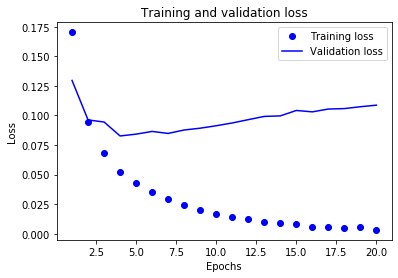

In [19]:
%matplotlib inline
import matplotlib.pyplot as plt

acc = history.history['binary_accuracy']
val_acc = history.history['val_binary_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

# "bo" is for "blue dot"
plt.plot(epochs, loss, 'bo', label='Training loss')
# b is for "solid blue line"
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

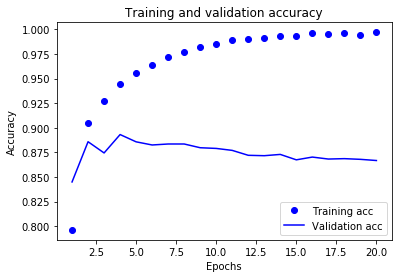

In [20]:
plt.clf()   # clear figure

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

In [21]:
model = models.Sequential()
model.add(layers.Dense(16, activation='relu', input_shape=(10000,)))
model.add(layers.Dense(16, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

model.compile(optimizer='rmsprop',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.fit(x_train, y_train, epochs=4, batch_size=512)
results = model.evaluate(x_test, y_test)

Train on 25000 samples
Epoch 1/4
25000/25000 [==============================] - 2s 92us/sample - loss: 0.4549 - accuracy: 0.8201
Epoch 2/4
25000/25000 [==============================] - 2s 63us/sample - loss: 0.2607 - accuracy: 0.9099
Epoch 3/4
25000/25000 [==============================] - 2s 63us/sample - loss: 0.2009 - accuracy: 0.9303
Epoch 4/4
25000/25000 [==============================] - 2s 63us/sample - loss: 0.1705 - accuracy: 0.9390
25000/1 [================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================

In [22]:
results

[0.294880199546814, 0.88348]

In [23]:
model.predict(x_test)

array([[0.24629208],
       [0.9994059 ],
       [0.9120151 ],
       ...,
       [0.14691213],
       [0.07435498],
       [0.723556  ]], dtype=float32)